# Clustering

New clustering analysis 

In [1]:
import os
import pandas as pd
import matplotlib.pyplot as plt
from libraries.clustering import apply_pca, plot_results, apply_tsne, apply_umap
from libraries import clustering
from sklearn.cluster import KMeans, OPTICS, DBSCAN
from scipy.spatial.distance import squareform
from sklearn.cluster import DBSCAN
import numpy as np
from sklearn.cluster import SpectralClustering
from pyclustering.cluster.optics import optics, ordering_analyser
from libraries.clustering import sil_vs_coh
from sklearn.metrics import pairwise_distances
from sklearn.preprocessing import normalize

In [2]:
DATASET_DIR = "dataset" + os.sep
RESULTS_DIR = "results" + os.sep

Loading NEW tables with anomaly detection

In [3]:
merged_df = pd.read_csv(DATASET_DIR + "merge_clean_v2-AD.csv", parse_dates=["date"])
cyclist_df = pd.read_csv(DATASET_DIR + "cyclist_clean_v3.csv")
stages_df = pd.read_csv(DATASET_DIR + "stages_clean_v3.csv")

In [4]:
cyclist_df.info()
stages_df.info()
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3020 entries, 0 to 3019
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  3020 non-null   int64  
 1   _url        3020 non-null   object 
 2   birth_year  3020 non-null   int64  
 3   height      3020 non-null   float64
 4   avg_pos     3020 non-null   float64
 5   num_races   3020 non-null   int64  
dtypes: float64(2), int64(3), object(1)
memory usage: 141.7+ KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2895 entries, 0 to 2894
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Unnamed: 0         2895 non-null   int64  
 1   _url               2895 non-null   object 
 2   points             2895 non-null   int64  
 3   length             2895 non-null   int64  
 4   climb_total        2895 non-null   int64  
 5   profile            2895 non-null   int64  
 6   startl

drop nan rows

In [5]:
# Drop rows containing missing values (NaN) in the 'cyclist_df' DataFrame.
# This ensures that any incomplete data is removed from the DataFrame before analysis or modeling.
cyclist_df = cyclist_df.dropna()

# Drop rows containing missing values (NaN) in the 'stages_df' DataFrame in the same manner.
# This keeps the dataset clean by removing rows with missing or incomplete data.
stages_df = stages_df.dropna()


In [6]:
cyclist_df.info()
stages_df.info()
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3020 entries, 0 to 3019
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  3020 non-null   int64  
 1   _url        3020 non-null   object 
 2   birth_year  3020 non-null   int64  
 3   height      3020 non-null   float64
 4   avg_pos     3020 non-null   float64
 5   num_races   3020 non-null   int64  
dtypes: float64(2), int64(3), object(1)
memory usage: 141.7+ KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2895 entries, 0 to 2894
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Unnamed: 0         2895 non-null   int64  
 1   _url               2895 non-null   object 
 2   points             2895 non-null   int64  
 3   length             2895 non-null   int64  
 4   climb_total        2895 non-null   int64  
 5   profile            2895 non-null   int64  
 6   startl

Scale/trasform columns for clustering

In [7]:
# List of categorical columns for transformation in the 'cyclist_df' DataFrame.
# These columns will not be transformed since we are leaving them as categorical features.
cat_cyclist = []

# List of columns to standardize in the 'cyclist_df' DataFrame.
# These columns will be standardized (i.e., scaled to have mean 0 and standard deviation 1).
stand_cyclist = ["height", "birth_year", 'avg_pos', 'num_races']

# List of columns to apply MinMax scaling in the 'cyclist_df' DataFrame.
# In this case, there are no columns specified for MinMax scaling.
minmax_cyclist = []

# Apply the transformation to the 'cyclist_df' DataFrame using the 'clustering.transform' method.
# It applies standardization, MinMax scaling, and encoding for categorical columns (if any).
# The result is the transformed data and the preprocessor (which holds information about how the data was transformed).
transformed_cyclists_data, preprocessor_cyclists = clustering.transform(
    cyclist_df,
    categorical_cols=cat_cyclist,
    standardize_cols=stand_cyclist,
    minmax_cols=minmax_cyclist,
)

# List of categorical columns for transformation in the 'stages_df' DataFrame.
# These columns are not specified here, as no categorical columns are being transformed.
cat_stage = []

# List of columns to standardize in the 'stages_df' DataFrame.
# These columns will be standardized (i.e., scaled to have mean 0 and standard deviation 1).
stand_stage = ["year", "length", "startlist_quality", 'avg_age_by_url', 'avg_delta_by_url', 'min_age_by_url', 'points']

# List of columns to apply MinMax scaling in the 'stages_df' DataFrame.
# Again, no columns are specified for MinMax scaling.
minmax_stage = []

# Apply the transformation to the 'stages_df' DataFrame using the 'clustering.transform' method.
# This applies standardization, MinMax scaling, and encoding for categorical columns (if any).
transformed_stages_data, preprocessor_stages = clustering.transform(
    stages_df,
    categorical_cols=cat_stage,
    minmax_cols=minmax_stage,
    standardize_cols=stand_stage
)

# Convert the transformed data for cyclists into a DataFrame.
# The transformed data now contains the processed values based on the specified transformations.
transformed_cyclists_df = pd.DataFrame(transformed_cyclists_data)

# Convert the transformed data for stages into a DataFrame.
# Similarly, the transformed stage data is now structured into a DataFrame.
transformed_stages_df = pd.DataFrame(transformed_stages_data)

# Add back the one-hot encoded columns' names to the transformed DataFrame for cyclists.
# This ensures that the transformed DataFrame has appropriate column names reflecting the transformations applied.
transformed_cyclists_df.columns = preprocessor_cyclists.get_feature_names_out(
    cyclist_df.columns
)

# Add back the one-hot encoded columns' names to the transformed DataFrame for stages.
# This ensures that the transformed DataFrame for stages has appropriate column names.
transformed_stages_df.columns = preprocessor_stages.get_feature_names_out(
    stages_df.columns
)

# Reset the index of the transformed cyclists DataFrame to ensure that indices are continuous after transformation.
transformed_cyclists_df.reset_index(drop=True, inplace=True)

# Reset the index of the transformed stages DataFrame in the same way to ensure continuous indices.
transformed_stages_df.reset_index(drop=True, inplace=True)

# Add the '_url' column back to the transformed cyclists DataFrame.
# The '_url' column is kept from the original 'cyclist_df' DataFrame for reference.
transformed_cyclists_df["_url"] = cyclist_df["_url"]

# Add the '_url' column back to the transformed stages DataFrame for reference.
transformed_stages_df["_url"] = stages_df["_url"]

# Drop the '_url' column from the transformed cyclists DataFrame as it's no longer needed after adding it back.
transformed_cyclists_df.drop(columns=["_url"], inplace=True)

# Drop the '_url' column from the transformed stages DataFrame similarly.
transformed_stages_df.drop(columns=["_url"], inplace=True)


In [8]:
transformed_cyclists_df.info()
transformed_stages_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3020 entries, 0 to 3019
Data columns (total 4 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   standardize__height      3020 non-null   float64
 1   standardize__birth_year  3020 non-null   float64
 2   standardize__avg_pos     3020 non-null   float64
 3   standardize__num_races   3020 non-null   float64
dtypes: float64(4)
memory usage: 94.5 KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2895 entries, 0 to 2894
Data columns (total 7 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   standardize__year               2895 non-null   float64
 1   standardize__length             2895 non-null   float64
 2   standardize__startlist_quality  2895 non-null   float64
 3   standardize__avg_age_by_url     2895 non-null   float64
 4   standardize__avg_delta_by_url   2895 non-null   floa

Create a version of the dataframes without categorical columns

In [9]:
def filter_one_hot_columns(df):
    return df.loc[:, ~df.columns.str.startswith("cat__")]


std_cyclists = filter_one_hot_columns(transformed_cyclists_df)
std_stages = filter_one_hot_columns(transformed_stages_df)

std_cyclists.info()
std_stages.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3020 entries, 0 to 3019
Data columns (total 4 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   standardize__height      3020 non-null   float64
 1   standardize__birth_year  3020 non-null   float64
 2   standardize__avg_pos     3020 non-null   float64
 3   standardize__num_races   3020 non-null   float64
dtypes: float64(4)
memory usage: 94.5 KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2895 entries, 0 to 2894
Data columns (total 7 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   standardize__year               2895 non-null   float64
 1   standardize__length             2895 non-null   float64
 2   standardize__startlist_quality  2895 non-null   float64
 3   standardize__avg_age_by_url     2895 non-null   float64
 4   standardize__avg_delta_by_url   2895 non-null   floa

inverse the tables

In [10]:
cyclists = clustering.inverse_transform(transformed_cyclists_data, preprocessor_cyclists,
                                                      minmax_cols=minmax_cyclist,
                                                      standardize_cols=stand_cyclist,
                                                      categorical_cols=cat_cyclist)
stages = clustering.inverse_transform(transformed_stages_data, preprocessor_stages,
                                                      standardize_cols=stand_stage,
                                                      minmax_cols=minmax_stage,
                                                      categorical_cols=cat_stage)

## K-means

### K-Means cyclists

tune k

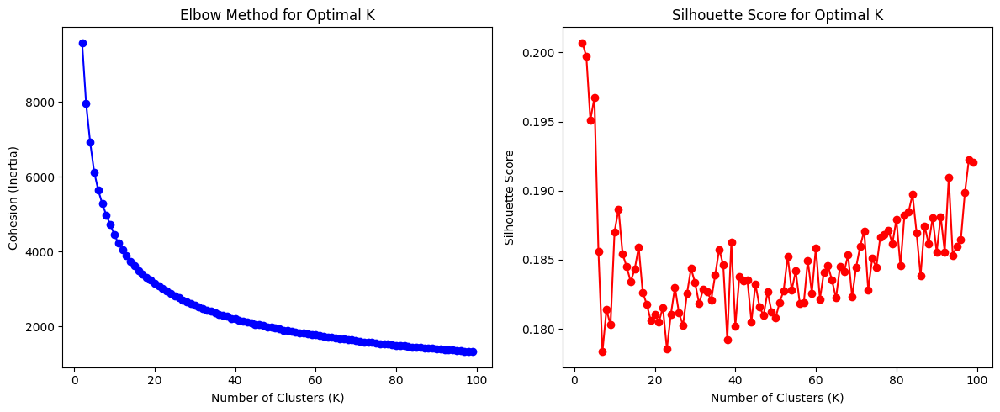

In [11]:
kmeans_list = clustering.plot_scores(std_cyclists)

pick best k and inverse centers

In [12]:
kmeans = kmeans_list[7]
centers = clustering.inverse_transform(kmeans.cluster_centers_, preprocessor_cyclists,
                                                      minmax_cols=minmax_cyclist,
                                                      standardize_cols=stand_cyclist,
                                                      categorical_cols=cat_cyclist)

plot for best k

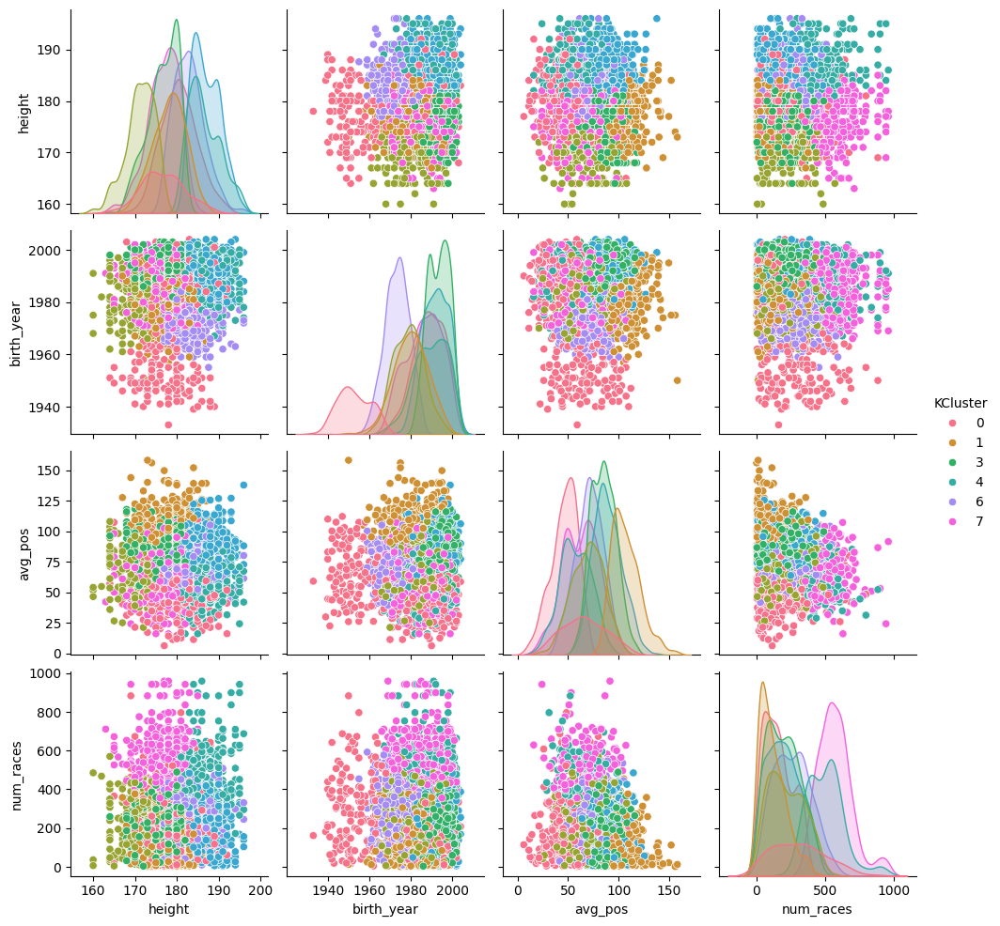

   Cluster  Count
0        0    143
1        1    310
2        2    301
3        3    414
4        4    304
5        5    383
6        6    389
7        7    411
8        8    365
       height   birth_year     avg_pos   num_races
0  176.678322  1952.671329   65.832422  307.342657
1  178.176129  1979.958065  107.142088  115.877419
2  171.186047  1978.940199   69.347511  217.465116
3  176.596618  1993.224638   84.843314  197.009662
4  186.559211  1989.467105   57.220088  500.243421
5  187.001044  1991.736292   88.884551  197.592689
6  182.839589  1973.264781   70.828224  260.267352
7  176.693917  1986.214112   62.805536  569.428224
8  180.556712  1989.005479   46.159501  156.312329
height          5.165253
birth_year     12.708328
avg_pos        18.368859
num_races     155.417354
dtype: float64


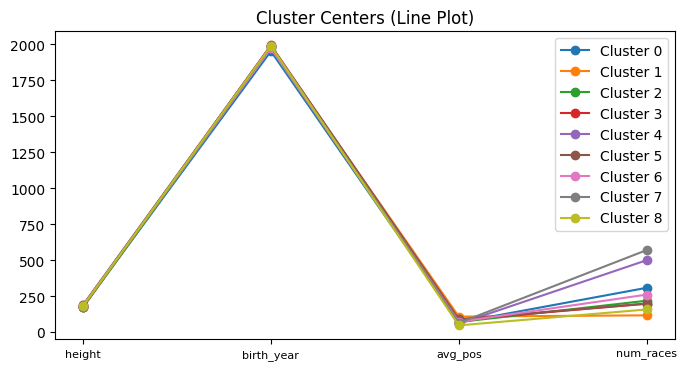

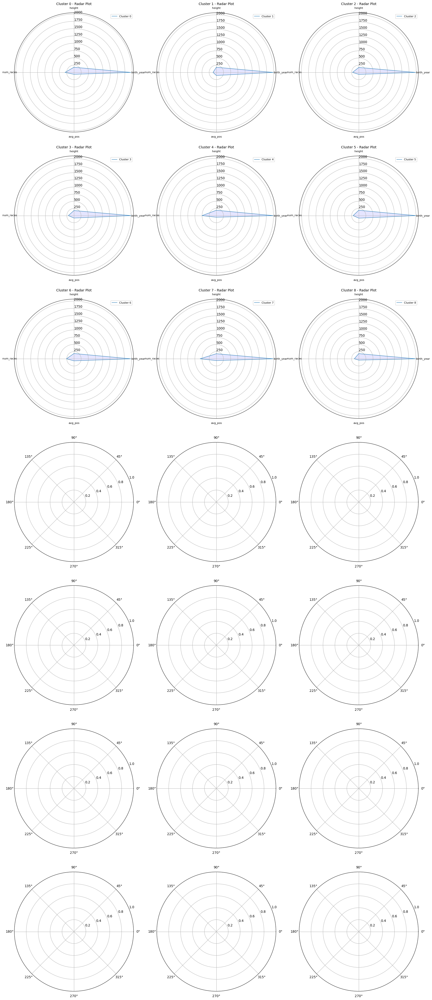

In [13]:
clustering.optimal_pair_plot(cyclists, 'KCluster', kmeans.labels_)
clustering.plot_centers(cyclists, centers, 7, 3)

visualize the clusters

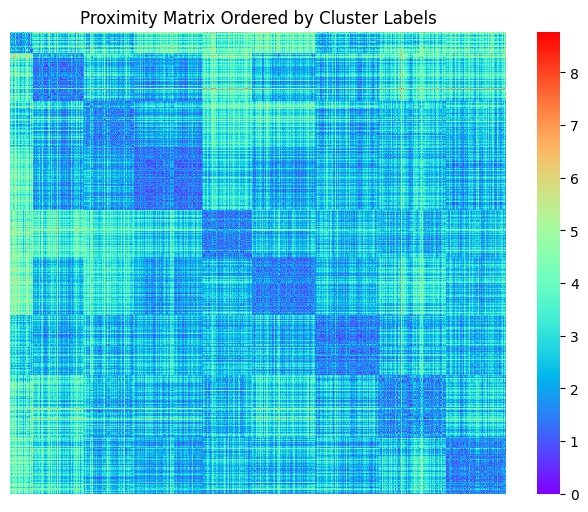

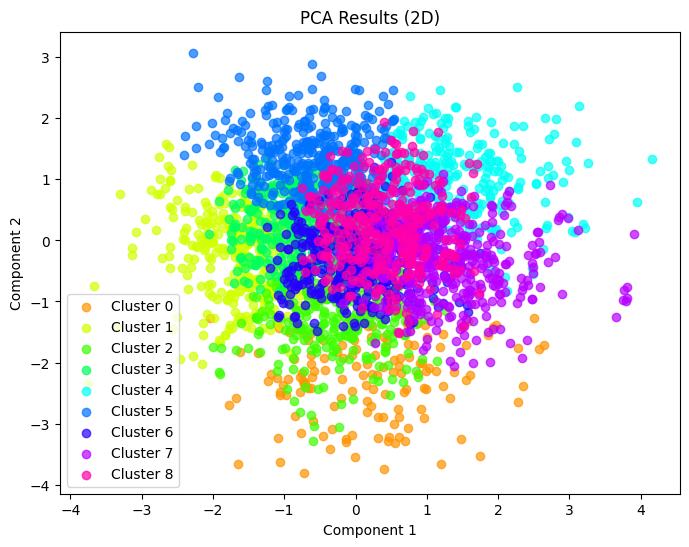

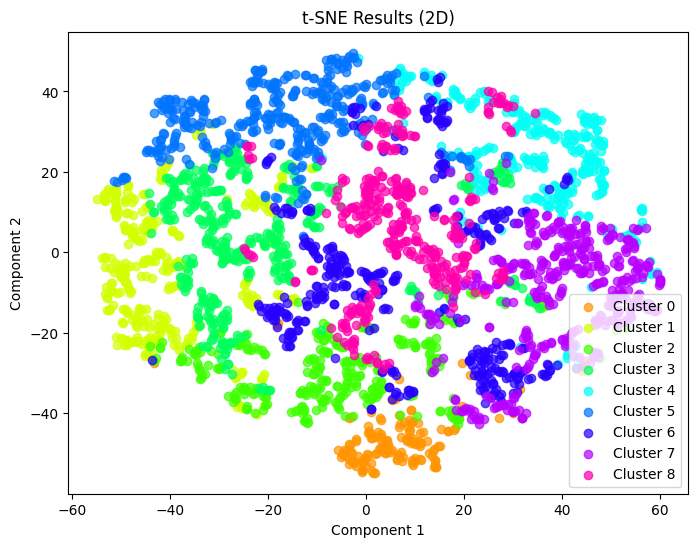

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


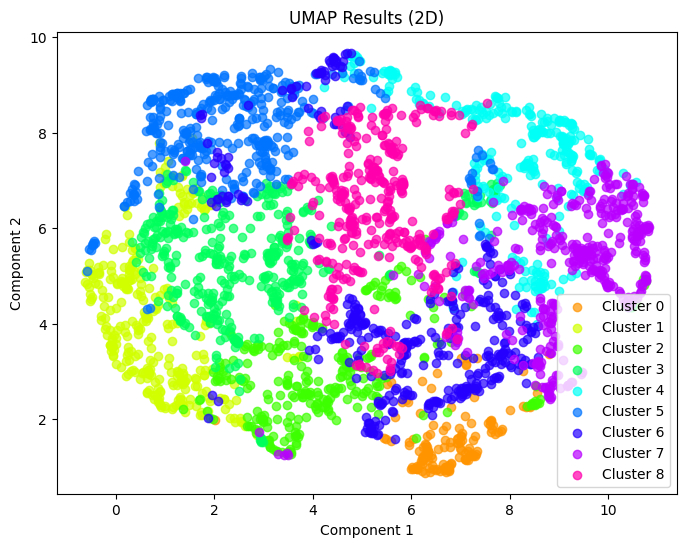

In [14]:
data_scaled = std_cyclists
labels = kmeans.labels_

clustering.similarity_matrix(data_scaled, labels)

# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels, title="UMAP Results (2D)", dimensions=2)

Important observation: From visualization we can see cyclists data are spherical and grouped with some overlap

### K-Means stages

tune k

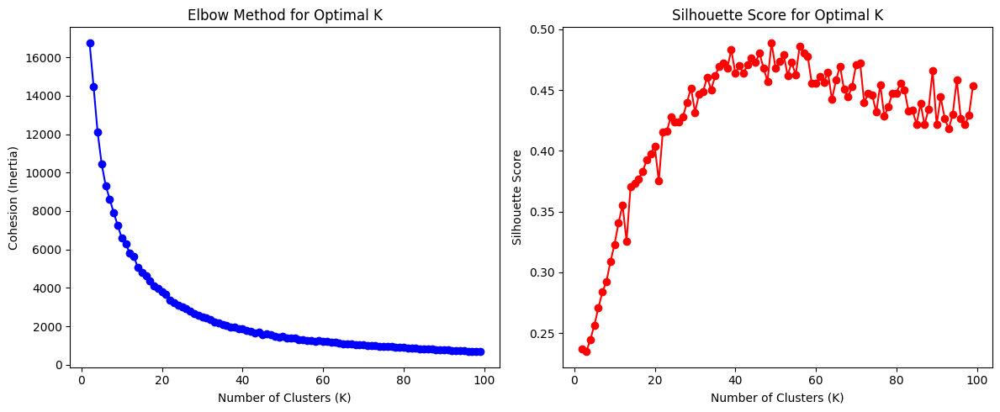

In [15]:
kmeans_list = clustering.plot_scores(std_stages)

inverse centers for best k

In [16]:
kmeans = kmeans_list[10]
centers = clustering.inverse_transform(kmeans.cluster_centers_, preprocessor_stages,
                                                      standardize_cols=stand_stage,
                                                      minmax_cols=minmax_stage,
                                                      categorical_cols=cat_stage)

plot for best k

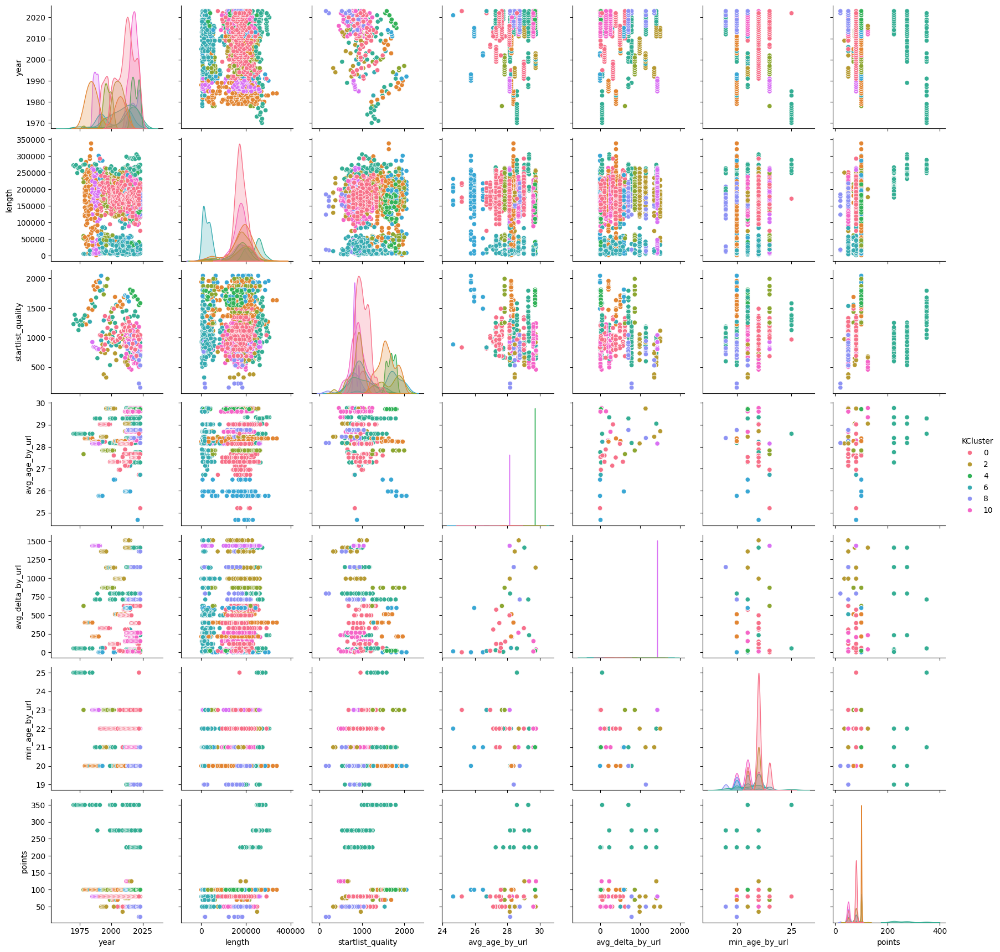

    Cluster  Count
0         0    670
1         1    369
2         2    250
3         3    144
4         4    152
5         5    153
6         6    234
7         7    147
8         8    119
9         9    127
10       10    384
11       11    146
           year         length  startlist_quality  avg_age_by_url  \
0   2012.144776  176896.567164        1009.313433       27.562124   
1   1992.728997  179696.205962        1589.945799       28.295095   
2   2005.044000  182461.200000         870.408000       28.614322   
3   1996.694444  177395.833333        1665.798611       27.825445   
4   2019.078947  168831.578947        1684.986842       29.708571   
5   2012.111111  239203.986928         985.745098       28.731207   
6   2008.880342   27358.974359        1007.320513       28.346246   
7   2004.578231  173573.469388        1729.455782       25.851648   
8   2019.050420  159314.873950         764.689076       28.593397   
9   1987.614173  173268.503937         844.173228       28.1409

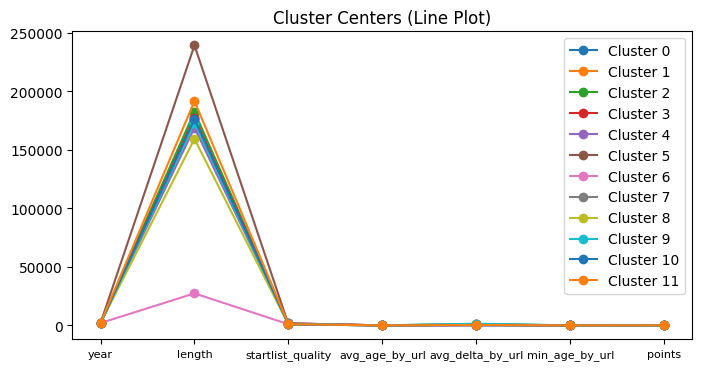

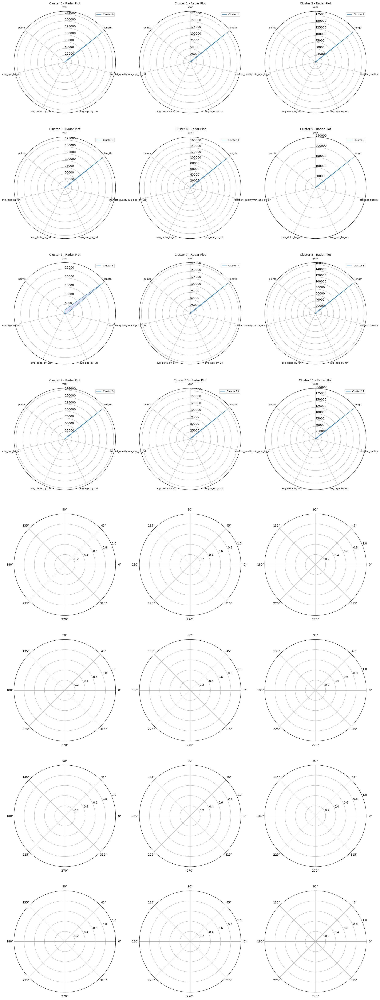

In [17]:
clustering.optimal_pair_plot(stages, 'KCluster', kmeans.labels_)
clustering.plot_centers(stages, centers, 8, 3)

visualize the clusters

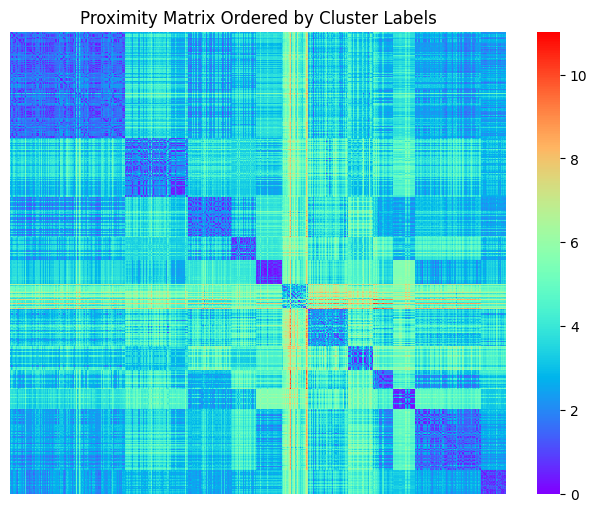

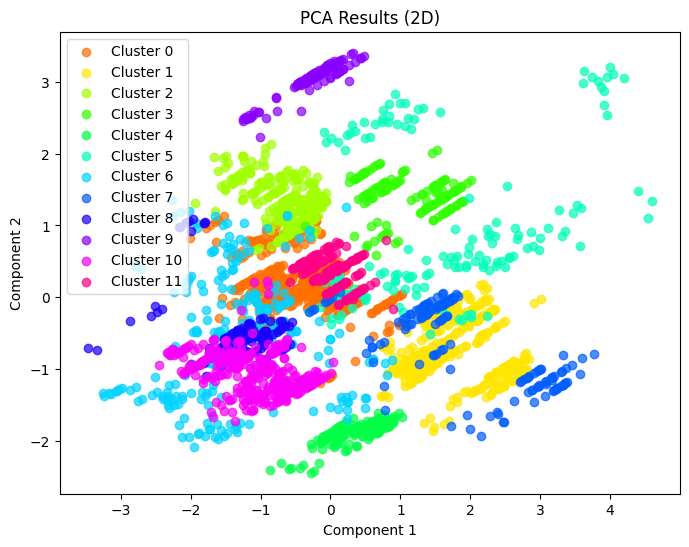

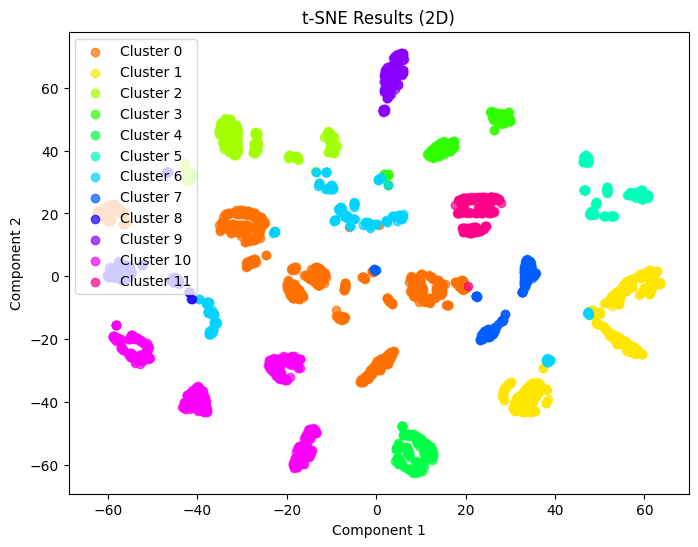

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


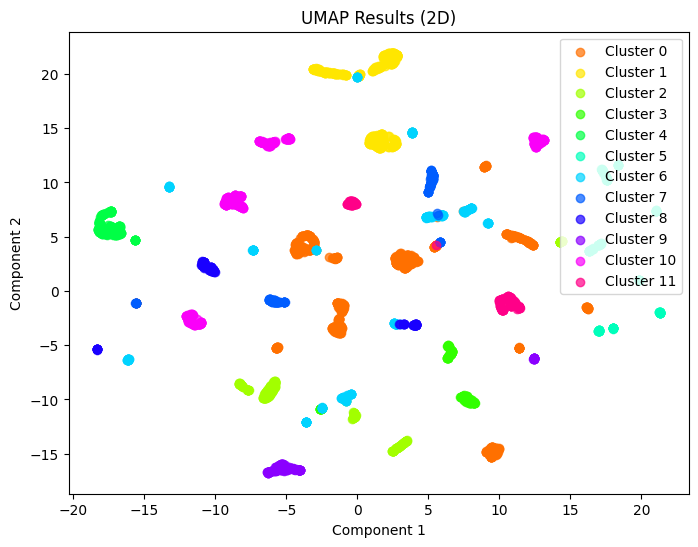

In [18]:
data_scaled = std_stages
labels = kmeans.labels_

clustering.similarity_matrix(data_scaled, labels)

# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels, title="UMAP Results (2D)", dimensions=2)

Important obervation: data tends to overlap to suggest dense regions and they seems sparse from the visualization

### X-means cyclists

execute x-means

In [19]:
from sklearn.metrics import silhouette_score

labels, centroid = clustering.x_means(std_cyclists)

print(f"Silouette: {silhouette_score(std_cyclists, labels)}")

Done
Silouette: 0.20132737851857974


inverse the centers

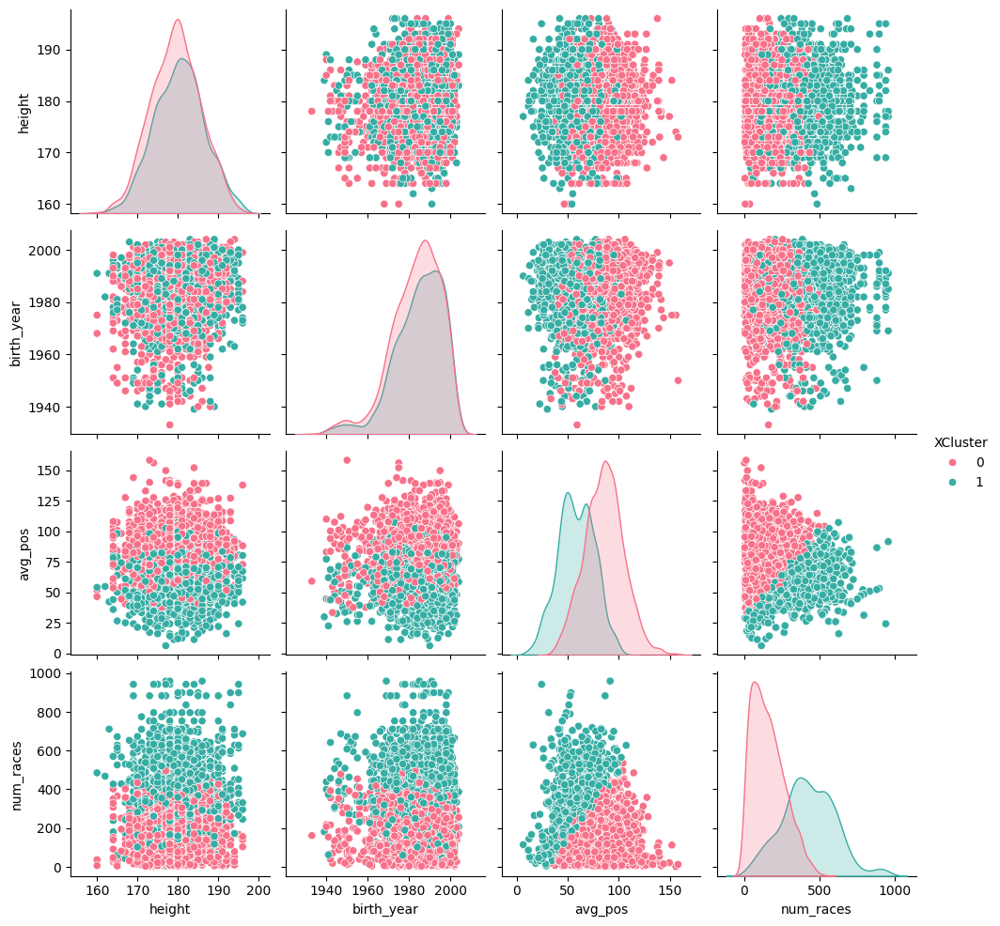

   Cluster  Count
0        0   1637
1        1   1383
       height   birth_year    avg_pos   num_races
0  179.411851  1983.258400  85.403914  157.384850
1  180.350542  1984.696312  58.186385  426.129429
height          0.663755
birth_year      1.016758
avg_pos        19.245700
num_races     190.031114
dtype: float64


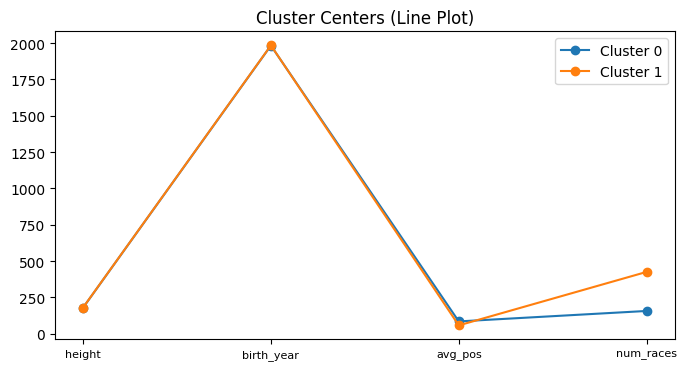

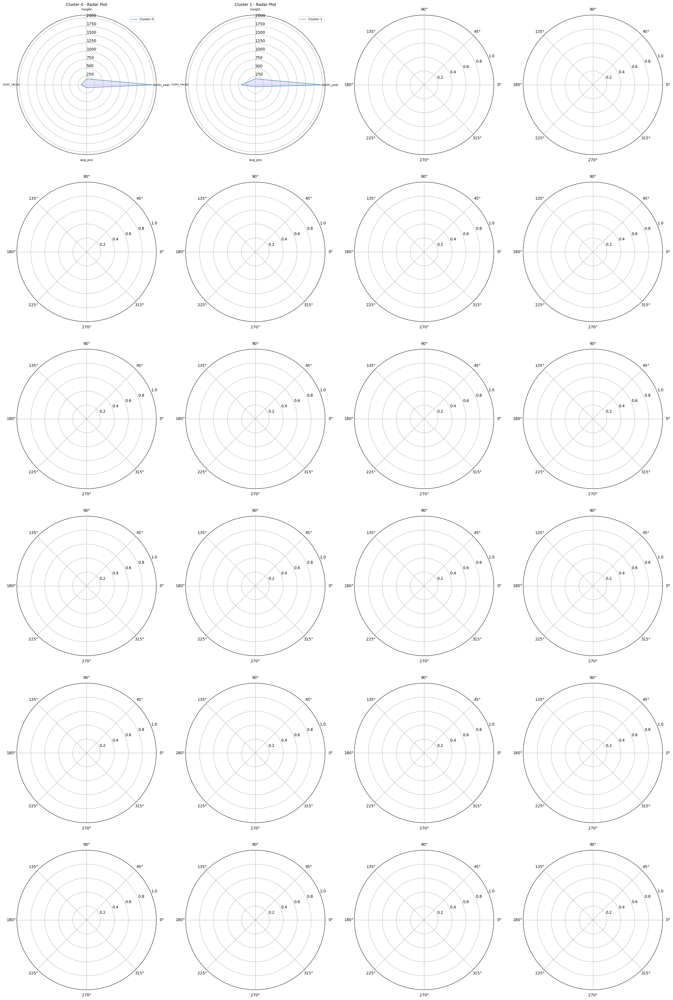

In [20]:
centers = clustering.inverse_transform(np.array(centroid), preprocessor_cyclists,
                                                      minmax_cols=minmax_cyclist,
                                                      standardize_cols=stand_cyclist,
                                                      categorical_cols=cat_cyclist)
clustering.optimal_pair_plot(cyclists, 'XCluster', labels)
clustering.plot_centers(cyclists, centers, 6, 4)

visualize clusters

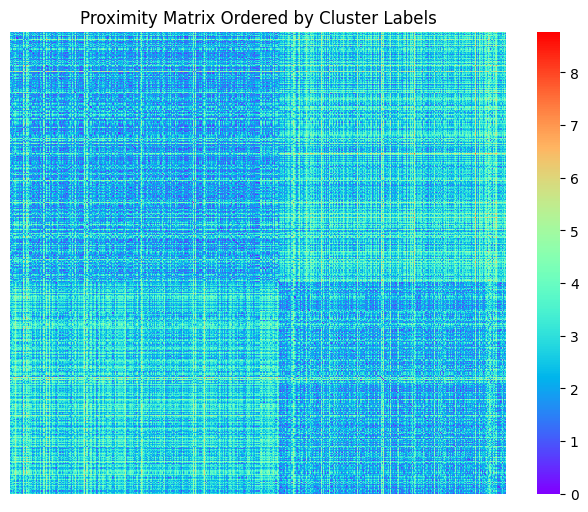

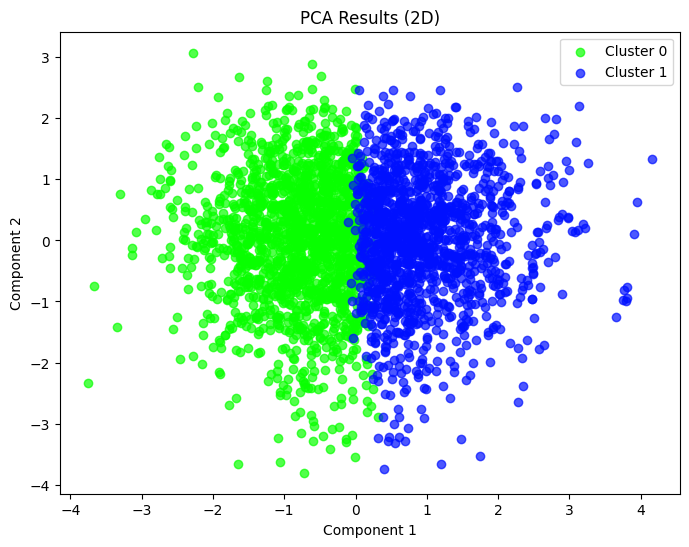

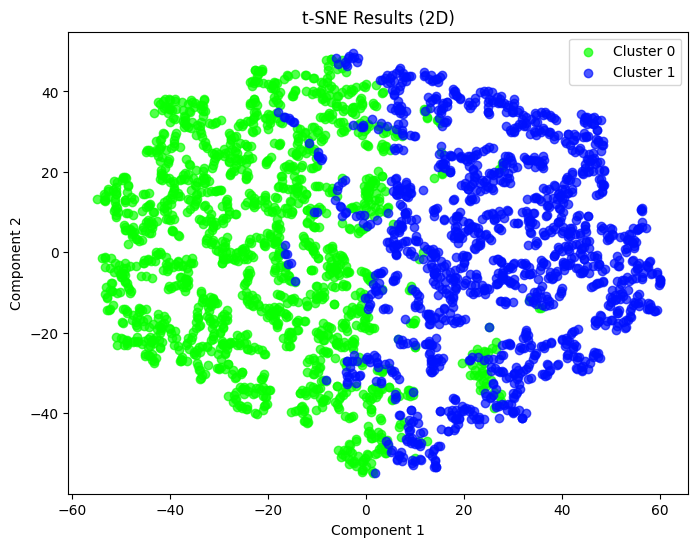

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


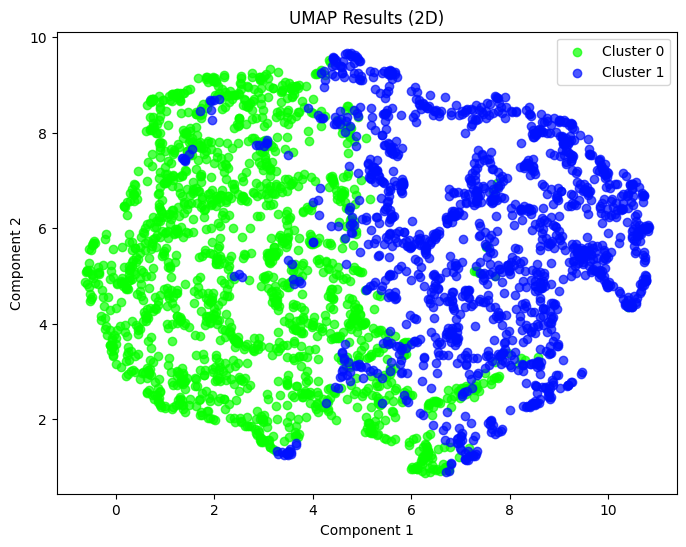

In [21]:
data_scaled = std_cyclists

clustering.similarity_matrix(data_scaled, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels, title="UMAP Results (2D)", dimensions=2)

### X-means stages

In [22]:
labels, centroid = clustering.x_means(std_stages)

print(f"Silouette: {silhouette_score(std_stages, labels)}")

Done
Silouette: 0.3753710669603264


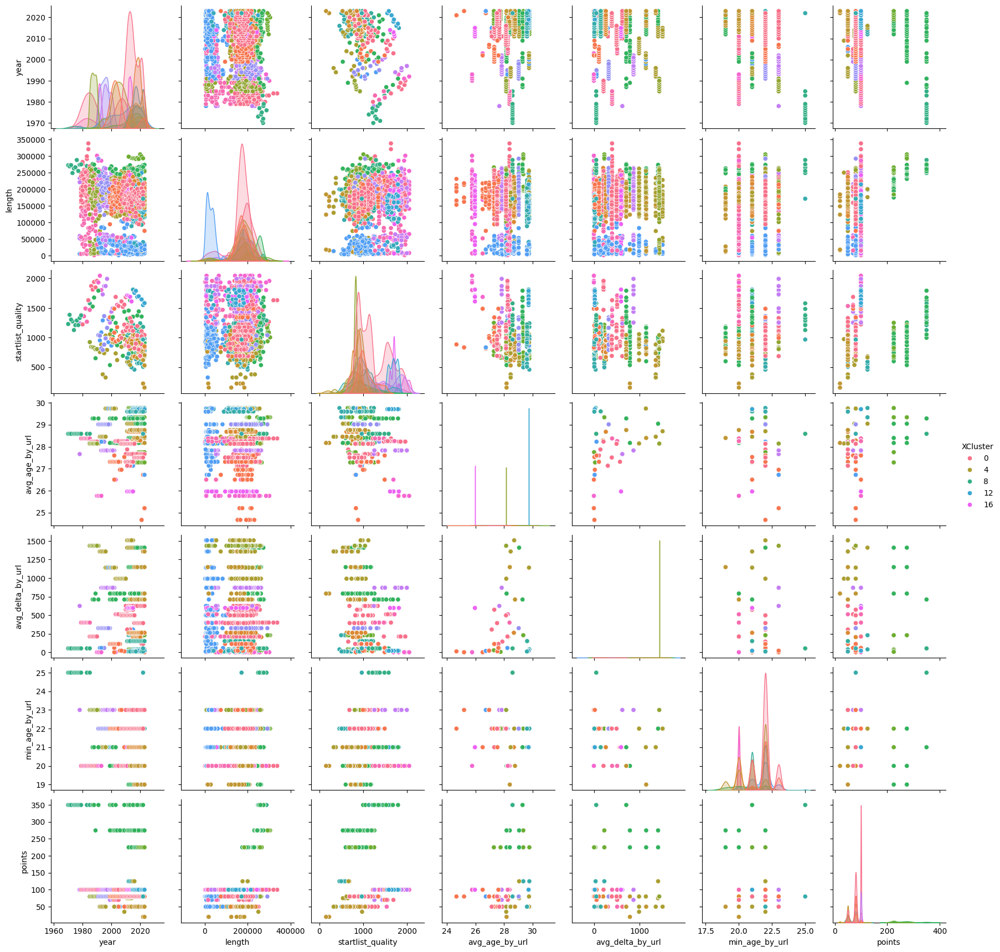

    Cluster  Count
0         0    490
1         1    194
2         2    191
3         3    119
4         4    250
5         5    127
6         6     48
7         7     93
8         8     12
9         9     98
10       10     96
11       11     24
12       12    128
13       13    214
14       14    146
15       15    144
16       16     73
17       17     57
18       18     76
19       19    315
           year         length  startlist_quality  avg_age_by_url  \
0   2014.791837  178389.591837         990.312245       27.695043   
1   2005.407216  173927.319588        1069.701031       27.063387   
2   2017.785340  181252.356021         850.968586       28.474321   
3   2019.050420  159314.873950         764.689076       28.593397   
4   2005.044000  182461.200000         870.408000       28.614322   
5   1987.614173  173268.503937         844.173228       28.140940   
6   2018.125000  230945.833333         893.395833       28.825409   
7   2013.655914  239735.483871         990.591398

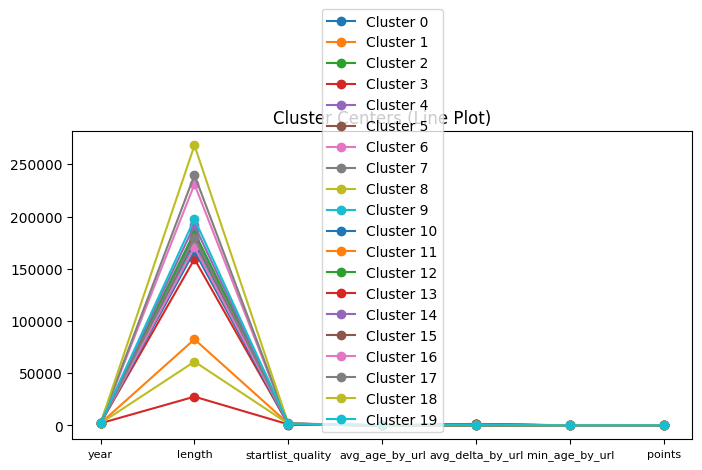

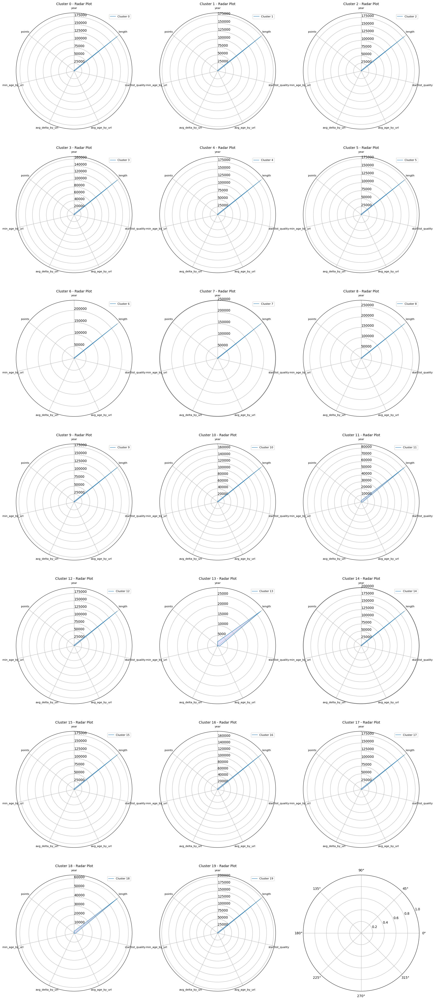

In [23]:
centers = clustering.inverse_transform(np.array(centroid), preprocessor_stages,
                                                      standardize_cols=stand_stage,
                                                      minmax_cols=minmax_stage,
                                                      categorical_cols=cat_stage)
clustering.optimal_pair_plot(stages, 'XCluster', labels)
clustering.plot_centers(stages, centers, 7, 3)

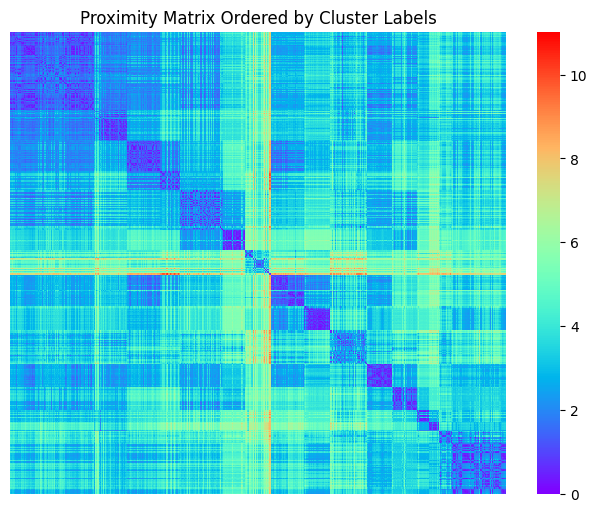

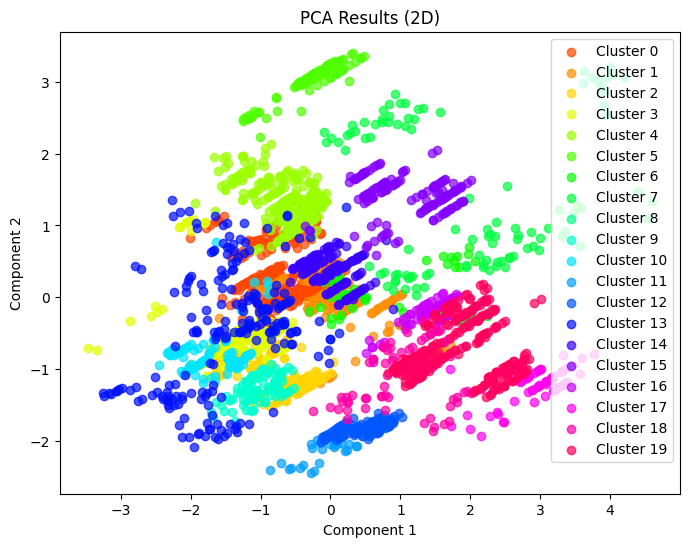

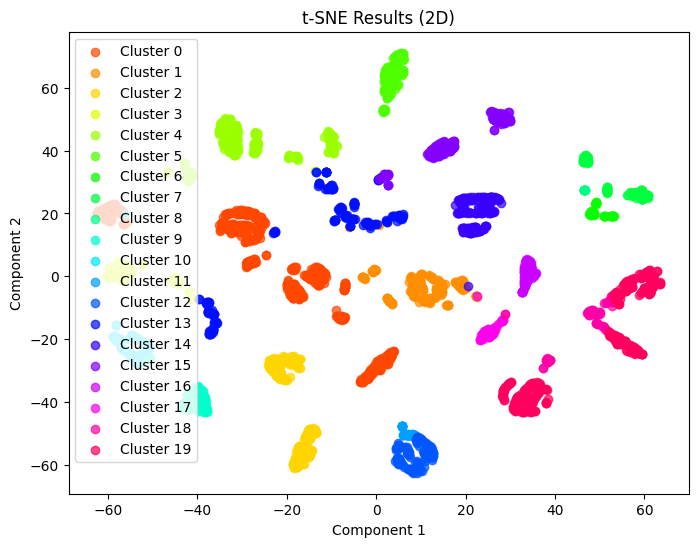

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


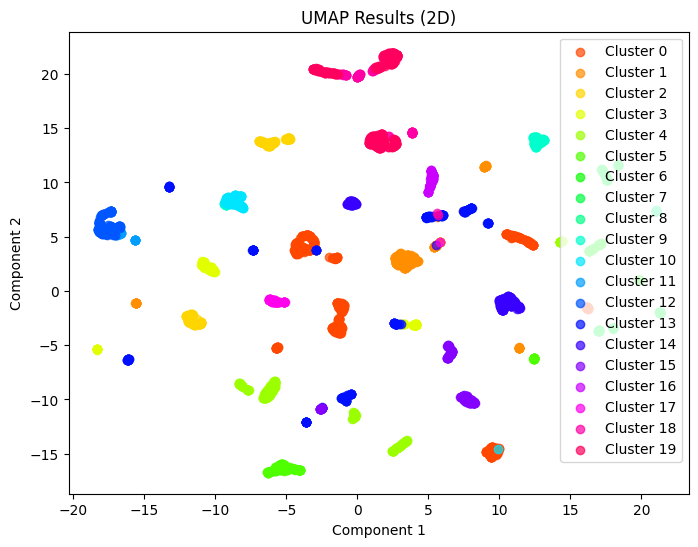

In [24]:
data_scaled = std_stages

clustering.similarity_matrix(data_scaled, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels, title="UMAP Results (2D)", dimensions=2)

## Hierarchical 

### Cyclists link

Plot dendrogram

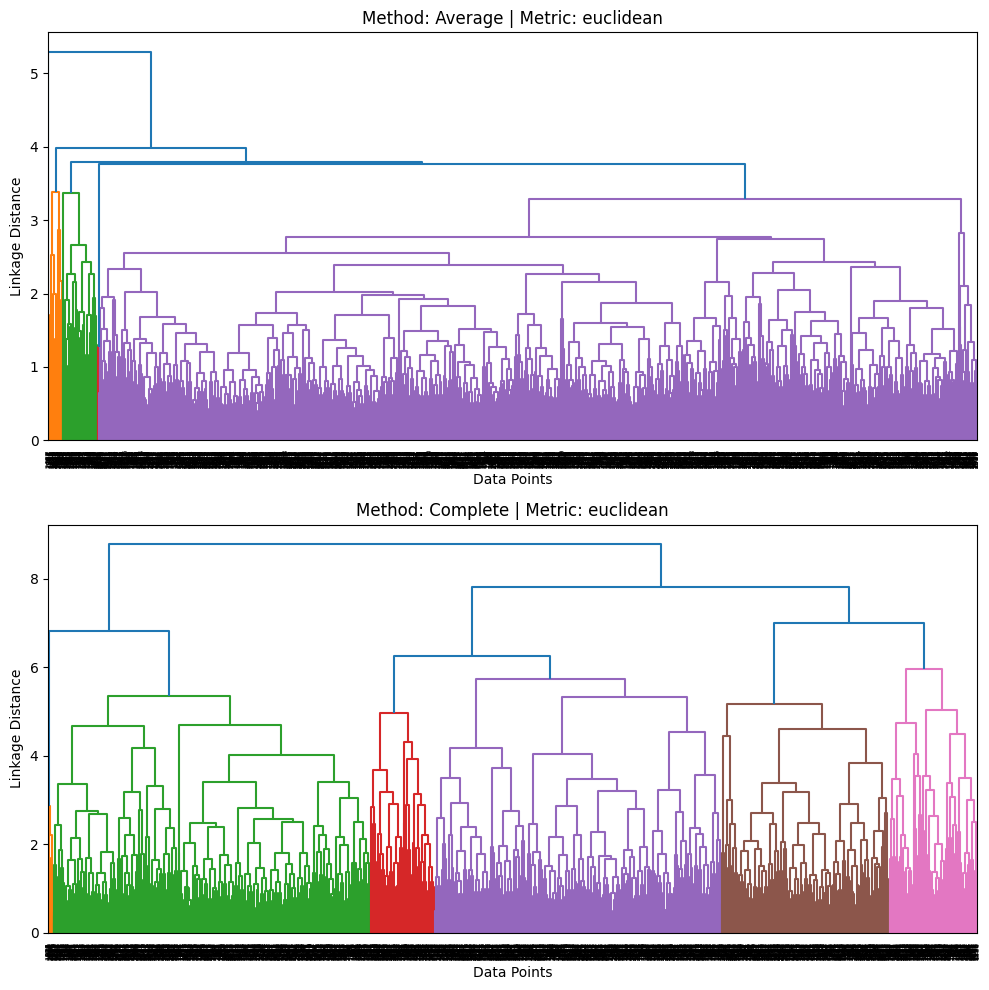

In [25]:
dst_matrix_euclid_cyclists = clustering.compute_distance_matrix(std_cyclists,"euclidean")
euclid_link = clustering.compute_hc(dst_matrix_euclid_cyclists, methods=['average', 'complete'])
clustering.plot_all_hc(euclid_link, "euclidean")

Complete link produces a good result we use it as starting point to determine the number of clusters. it seems optimal is between 2 - 6

To understand better let's try another method. Elbow method

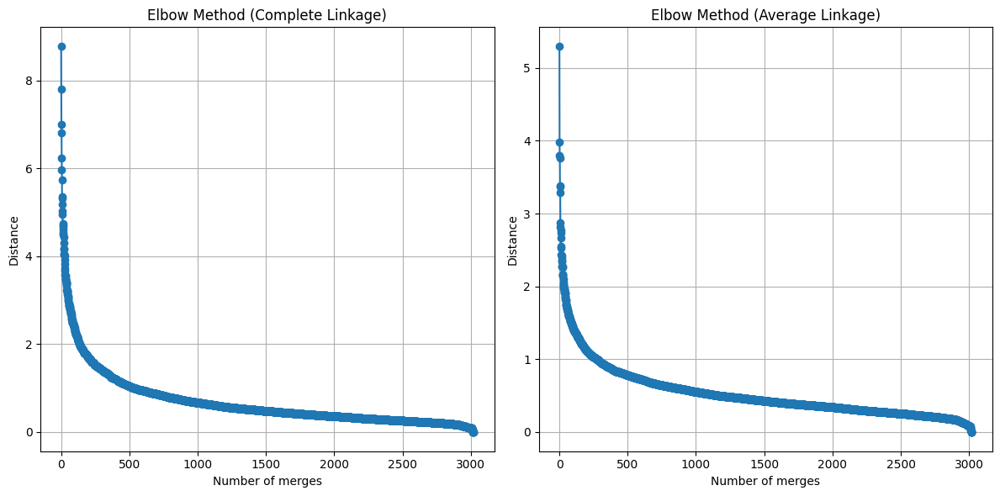

In [26]:
clustering.plot_elbow_method(std_cyclists)

Also this method confirm the number of cluster between 2 and 3 with complete link

### Stages links

We use dendrograma as before

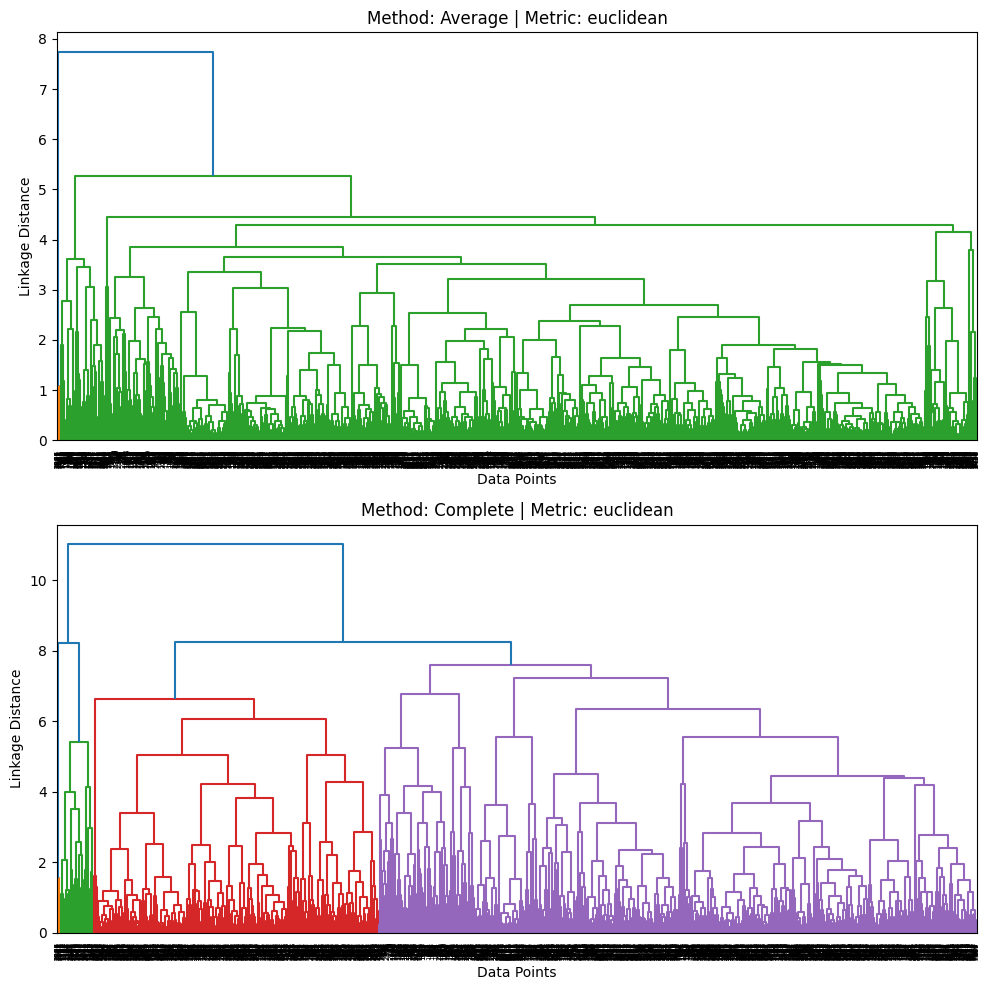

In [27]:
dst_matrix_euclid_stages = clustering.compute_distance_matrix(std_stages, "euclidean")
euclid_link = clustering.compute_hc(dst_matrix_euclid_stages, methods=['average', 'complete'])
clustering.plot_all_hc(euclid_link, "euclidean")

The optimal value seems in range 2 - 4

To better understand let's try another method. Elbow method also as before

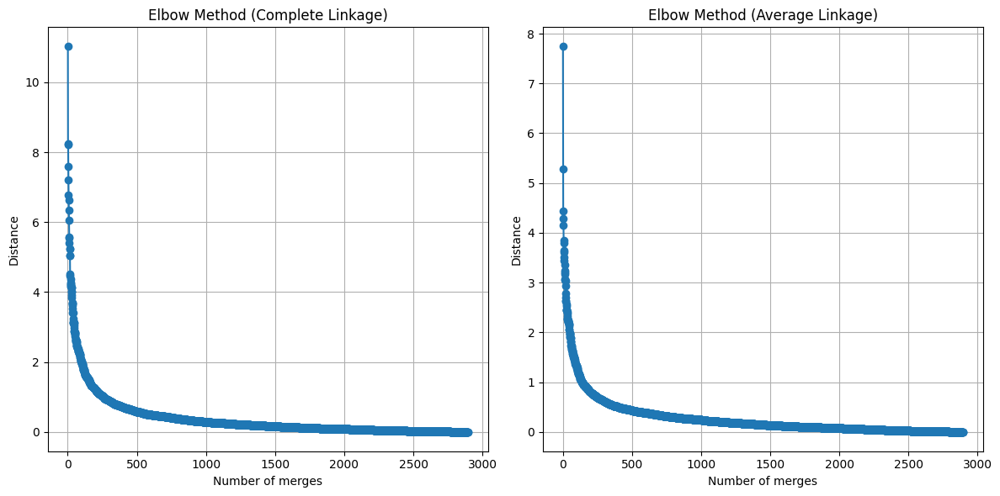

In [28]:
clustering.plot_elbow_method(std_stages)

### Spectral method

Tuning number of clusters using eigen gap

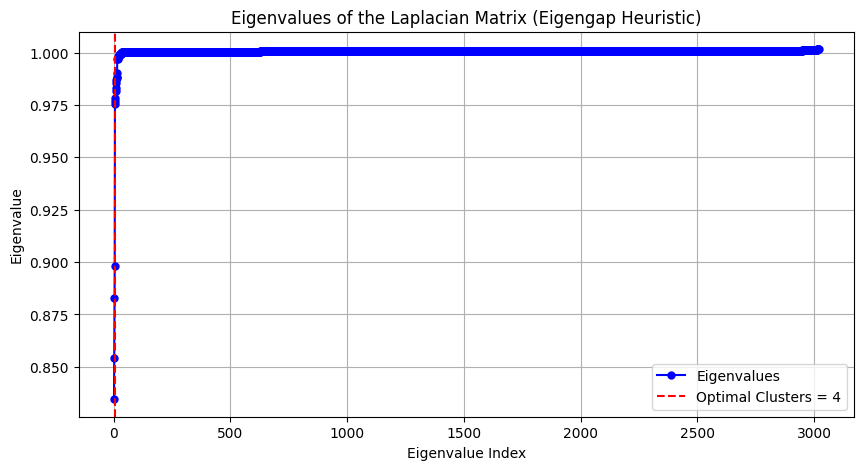

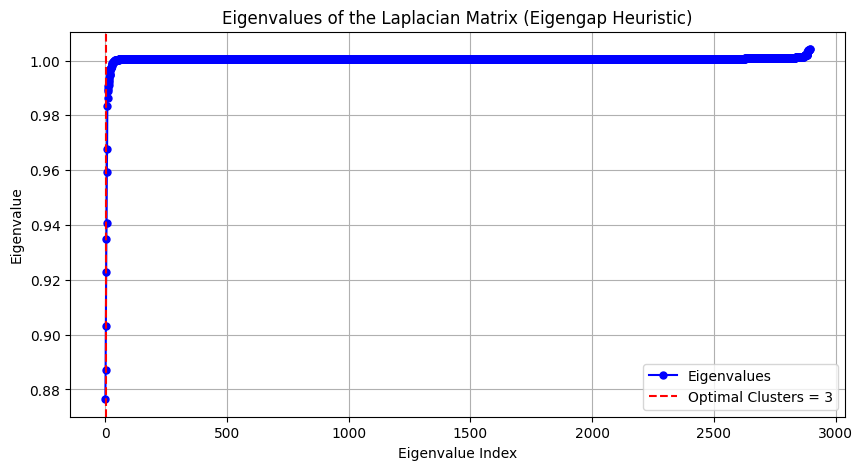

In [29]:
import libraries.clustering as clustering
clustering.spectral_eigen_gap(std_cyclists.values)
clustering.spectral_eigen_gap(std_stages.values)

optimal number of cluster is around 4 for cyclists and 3 for stages

### Cyclists agglomerative

let's plot silhouette varying number of clusters

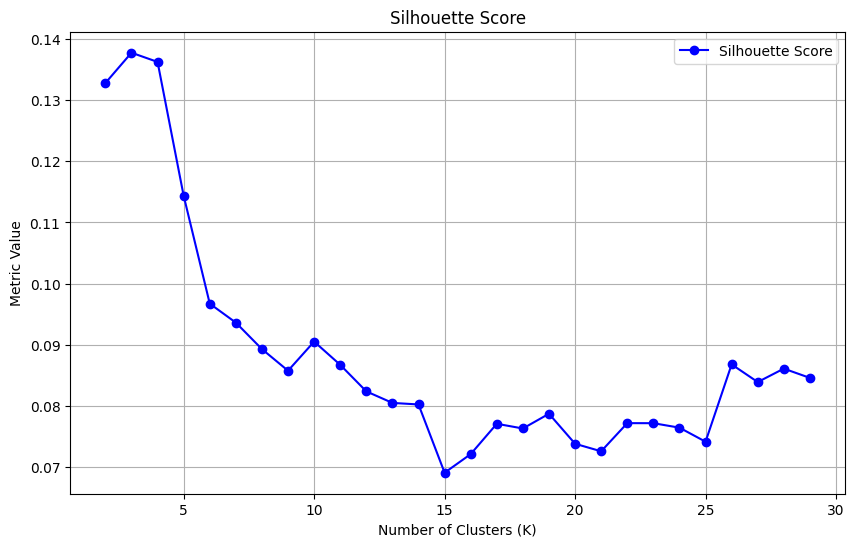

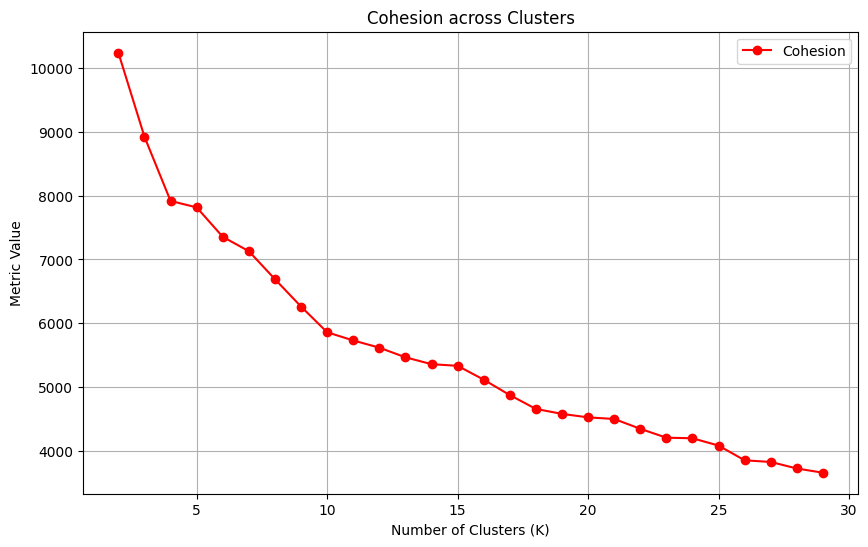

In [30]:
from sklearn.cluster import AgglomerativeClustering

agglr_labels_cyclists = []
for num_clusters in range(2, 30):
    agg_clustering = AgglomerativeClustering(n_clusters=num_clusters, linkage='complete')
    agglr_labels_cyclists.append(agg_clustering.fit_predict(std_cyclists))

sil1,coh1 = sil_vs_coh(std_cyclists, agglr_labels_cyclists, list(range(2,30)))

Bad results

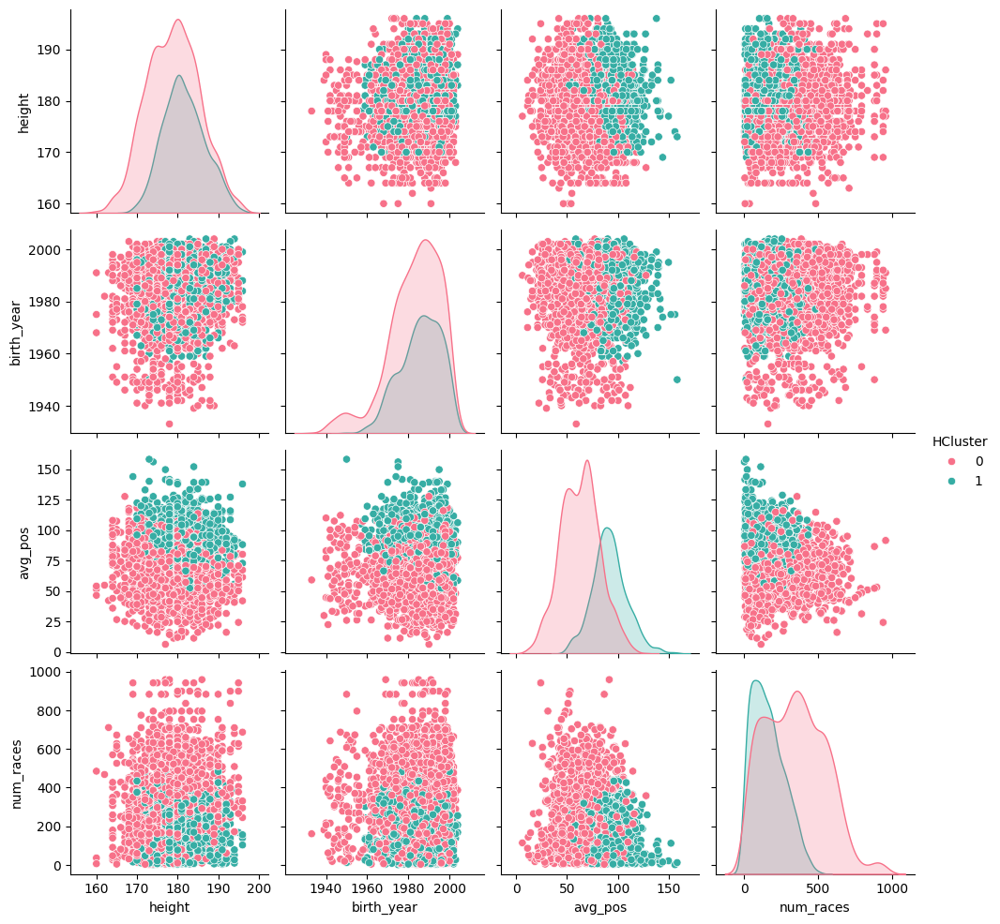

   Cluster  Count
0        0   1971
1        1   1049
       height   birth_year    avg_pos   num_races
0  178.918316  1982.913749  62.957569  343.946728
1  181.576740  1985.801716  91.695529  161.160153
height          1.879790
birth_year      2.042101
avg_pos        20.320806
num_races     129.249627
dtype: float64


In [31]:
agg_clustering = AgglomerativeClustering(n_clusters=2, linkage='complete')
labels = agg_clustering.fit_predict(std_cyclists)
clustering.optimal_pair_plot(cyclists, 'HCluster', labels)

Also optimal K shows bad results

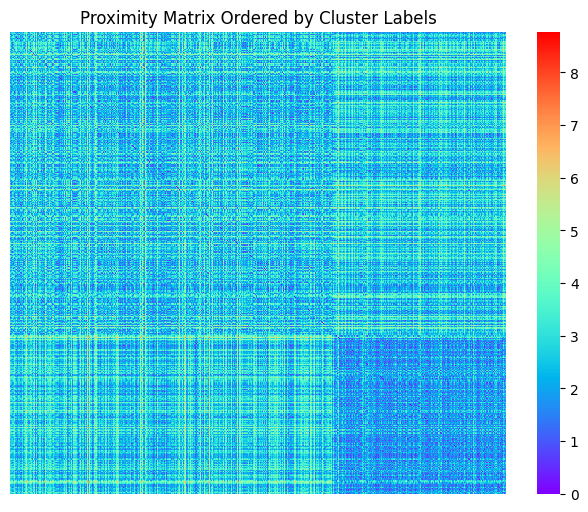

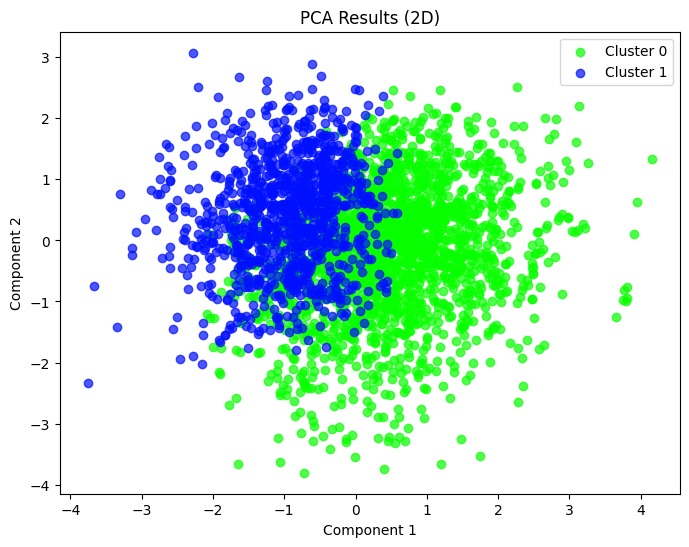

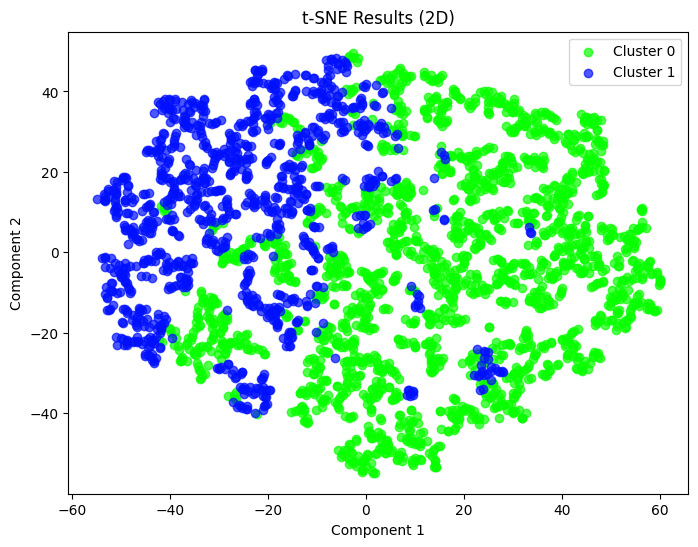

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


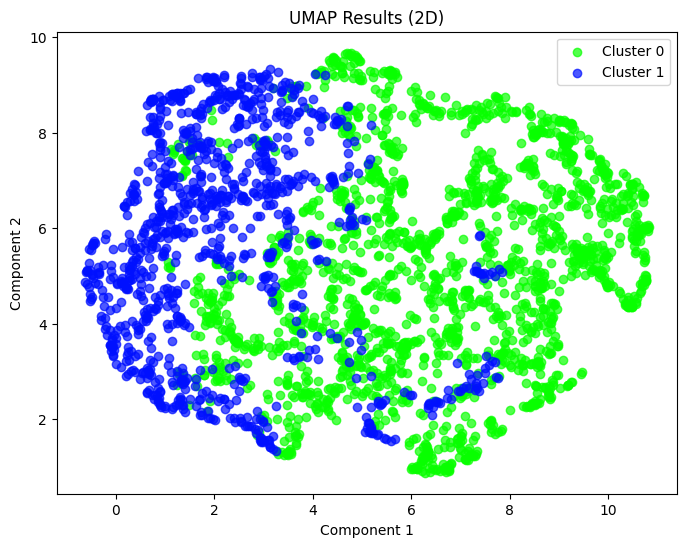

In [32]:
data_scaled = std_cyclists

clustering.similarity_matrix(data_scaled, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels, title="UMAP Results (2D)", dimensions=2)

Also visualization doesn't show any interesting results

### Stages agglomerative

let's plot silhouette varying number of clusters as before

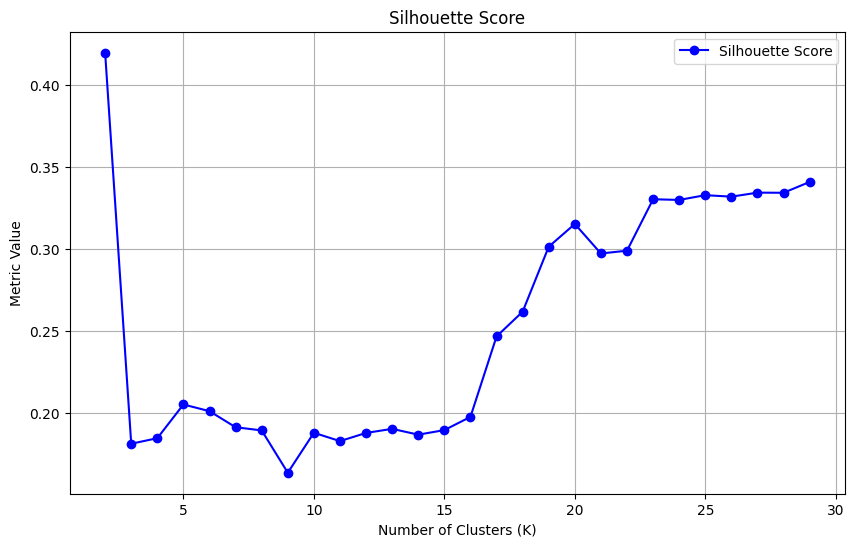

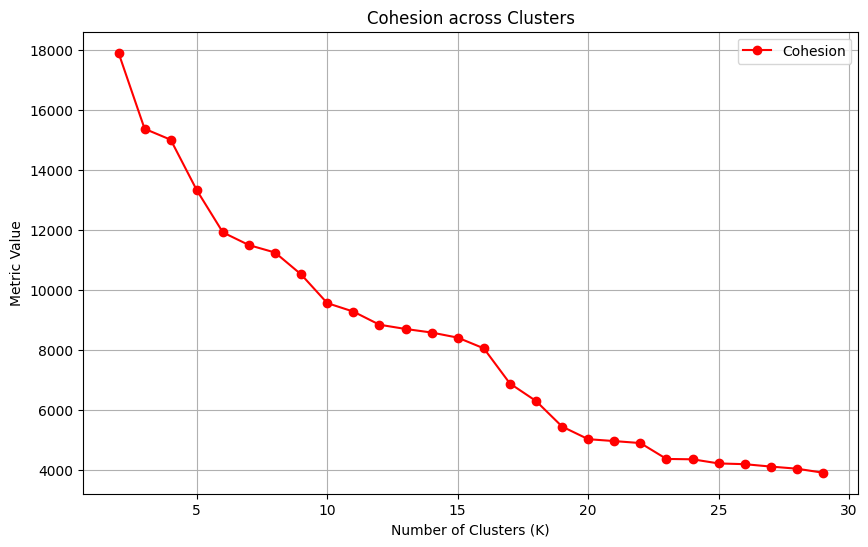

In [33]:
from sklearn.cluster import AgglomerativeClustering

agglr_labels_stages = []
for num_clusters in range(2, 30):
    agg_clustering = AgglomerativeClustering(n_clusters=num_clusters, linkage='complete')
    agglr_labels_stages.append(agg_clustering.fit_predict(std_stages))

sil1,coh1 = sil_vs_coh(std_stages, agglr_labels_stages, list(range(2,30)))

Results are good only for 2

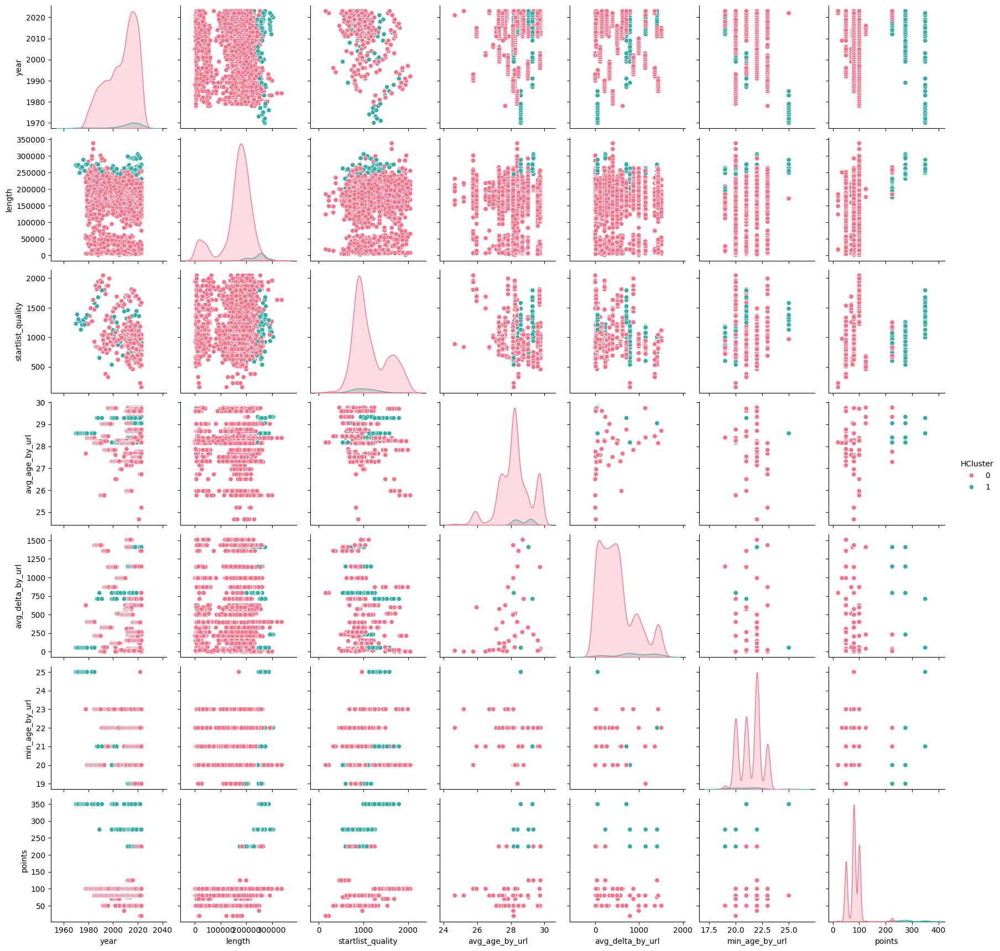

   Cluster  Count
0        0   2779
1        1    116
          year         length  startlist_quality  avg_age_by_url  \
0  2006.935228  164830.179921        1146.312343       28.229663   
1  2010.086207  247489.741379        1034.137931       28.749843   

   avg_delta_by_url  min_age_by_url      points  
0        485.393612       21.419575   80.807845  
1        865.022809       21.215517  279.956897  
min_age_by_url           0.144291
avg_age_by_url           0.367822
year                     2.228078
startlist_quality       79.319287
points                 140.819645
avg_delta_by_url       268.438380
length               58449.136437
dtype: float64


In [34]:
agg_clustering = AgglomerativeClustering(n_clusters=2, linkage='complete')
labels = agg_clustering.fit_predict(std_stages)
clustering.optimal_pair_plot(stages, 'HCluster', labels)

Not so interesting results from plots

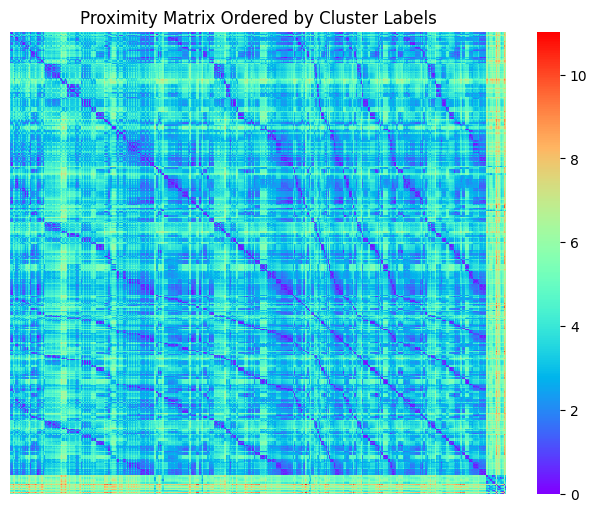

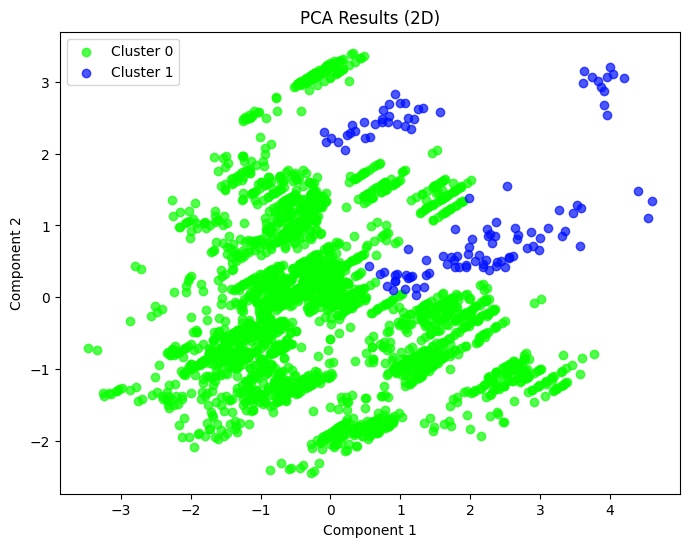

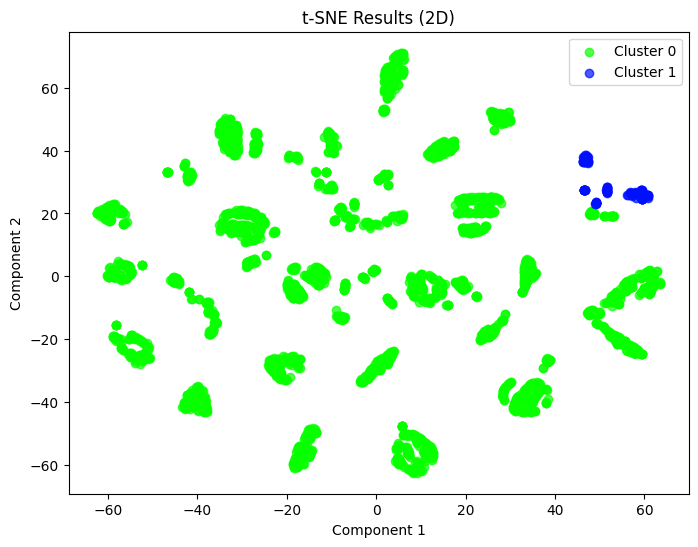

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


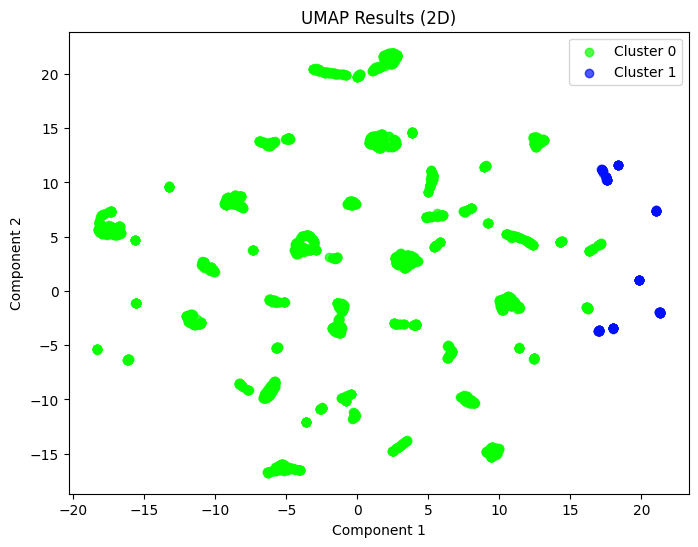

In [35]:
data_scaled = std_stages

clustering.similarity_matrix(data_scaled, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels, title="UMAP Results (2D)", dimensions=2)

Also visualization doesn't show anything interesting

### Cyclists spectral

Plot silhouette varying number of clusters

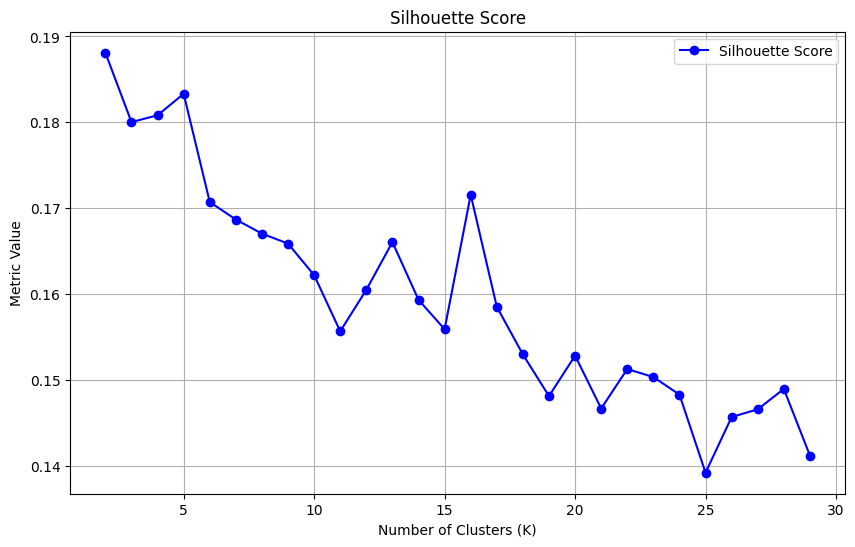

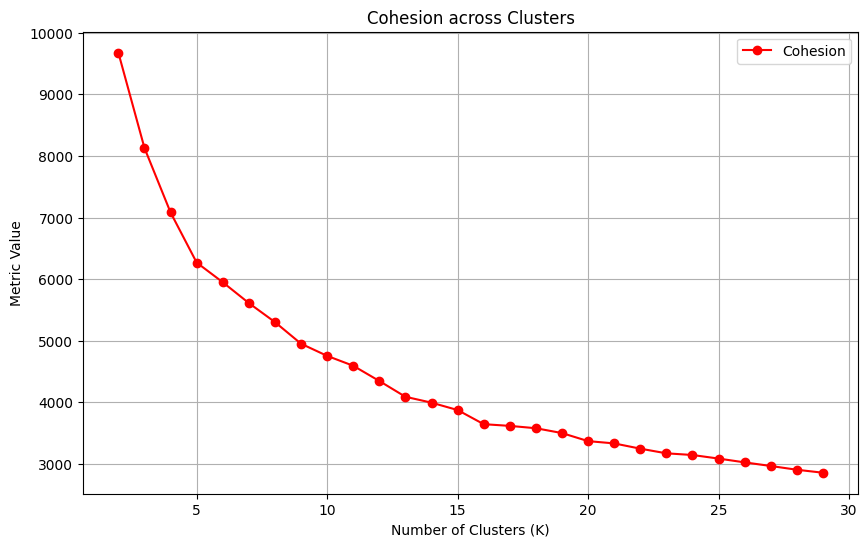

In [36]:
spect_labels_cyclists = []
for n_clusters in range(2, 30):
    spectral = SpectralClustering(n_clusters=n_clusters, affinity='nearest_neighbors', random_state=1804)
    spect_labels_cyclists.append(spectral.fit_predict(std_cyclists))

sil3,coh3 = sil_vs_coh(std_cyclists, spect_labels_cyclists, list(range(2,30)))

Bad results for all K

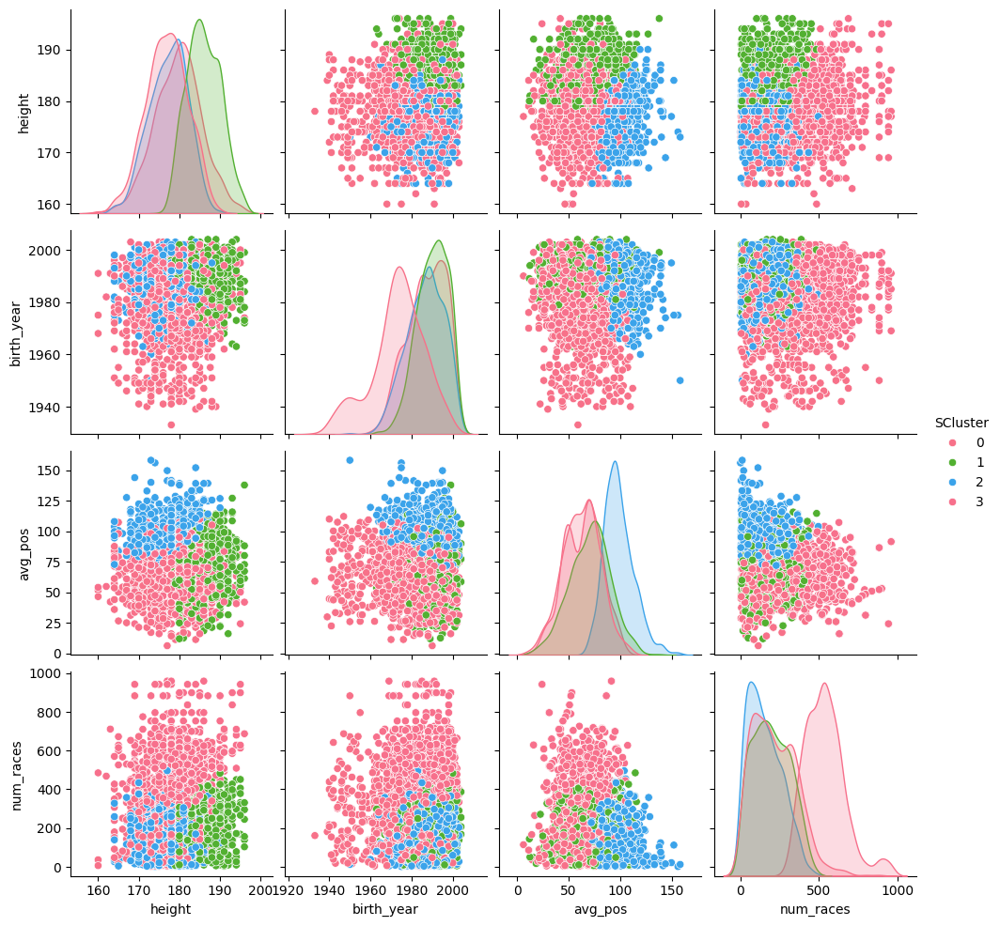

   Cluster  Count
0        0    813
1        1    722
2        2    702
3        3    783
       height   birth_year    avg_pos   num_races
0  176.852153  1973.248462  62.075989  218.041820
1  185.938227  1989.977839  70.434203  196.335180
2  177.221652  1986.448718  98.641803  154.361823
3  179.673308  1987.135377  63.486794  535.877395
height          4.202090
birth_year      7.460848
avg_pos        17.050705
num_races     175.154832
dtype: float64


In [37]:
spect_clustering = SpectralClustering(n_clusters=4, affinity='nearest_neighbors', random_state=1804)
labels = spect_clustering.fit_predict(std_cyclists)
clustering.optimal_pair_plot(cyclists, 'SCluster', labels)

Points now well separated

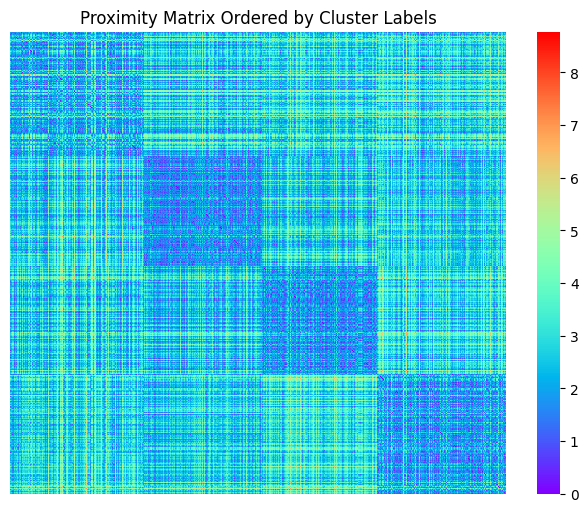

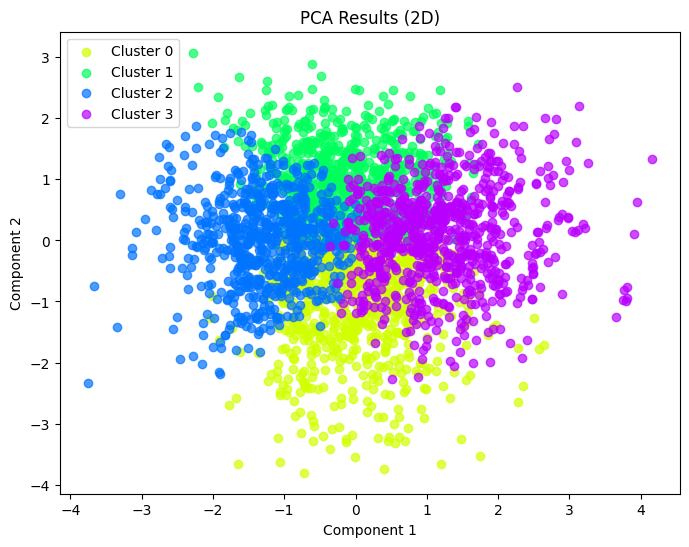

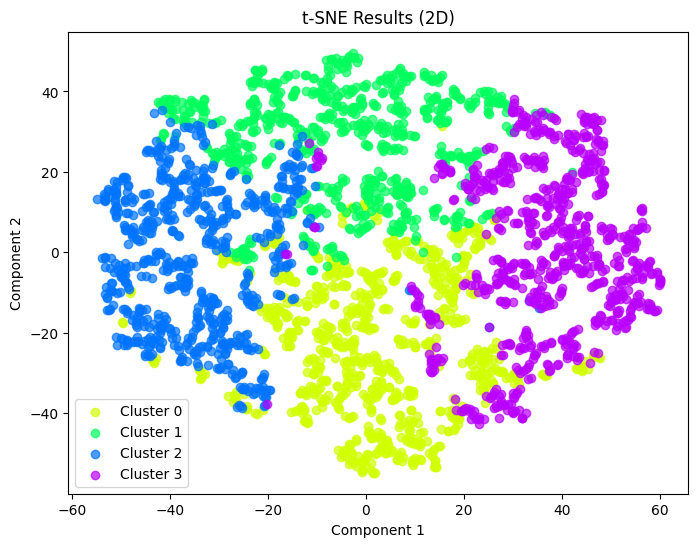

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


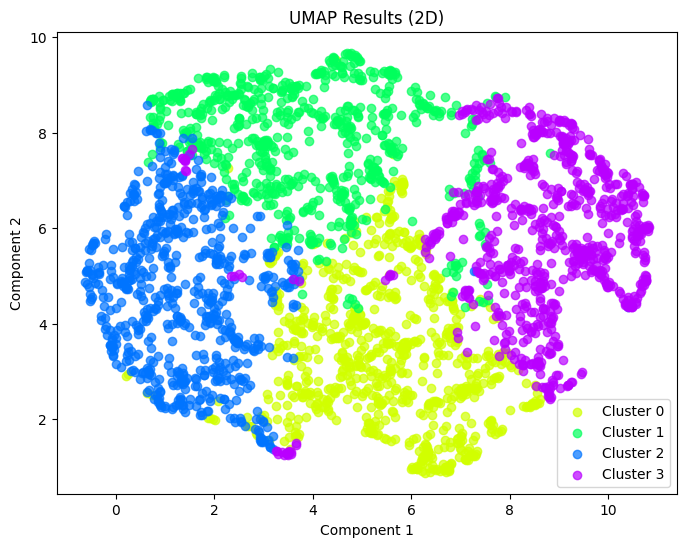

In [38]:
data_scaled = std_cyclists

clustering.similarity_matrix(data_scaled, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels, title="UMAP Results (2D)", dimensions=2)

Visualization also shows some overlap and some points of same clusters very far

### Stages spectral

Plot silhouette varying K

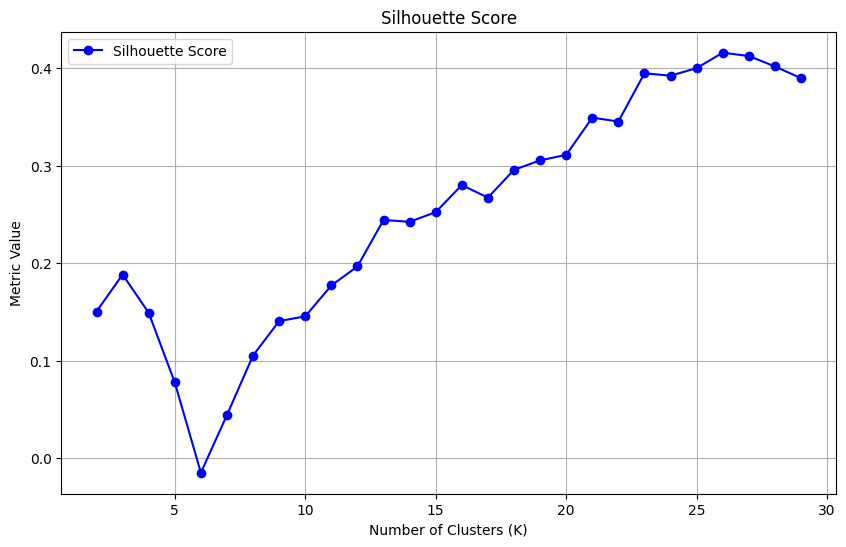

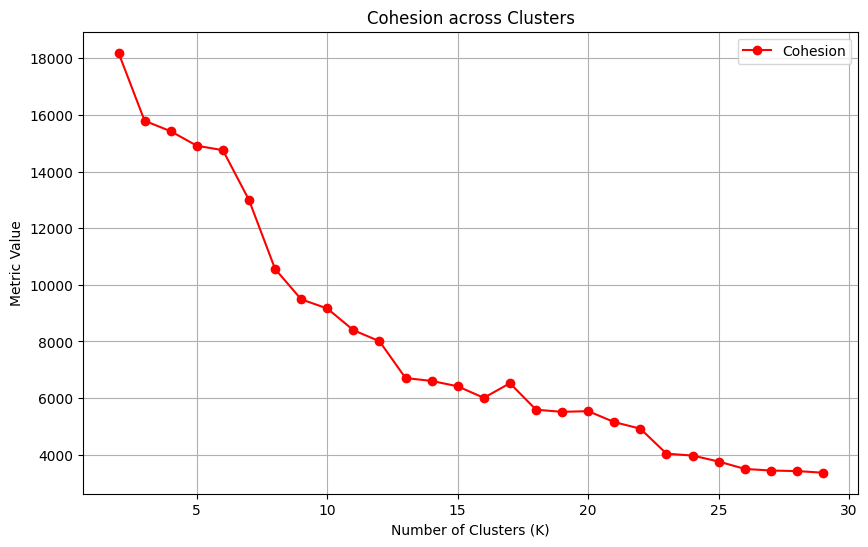

In [39]:
from sklearn.cluster import SpectralClustering

spect_labels_stages = []
for n_clusters in range(2, 30):
    spectral = SpectralClustering(n_clusters=n_clusters, affinity='nearest_neighbors', n_neighbors=50, random_state=1804)
    spect_labels_stages.append(spectral.fit_predict(std_stages))

sil4,coh4 = sil_vs_coh(std_stages, spect_labels_stages, list(range(2,30)))

Silhouette keeps increasing with large amount of clusters far from the optimal value. Probably overfitting over the noise and outliers

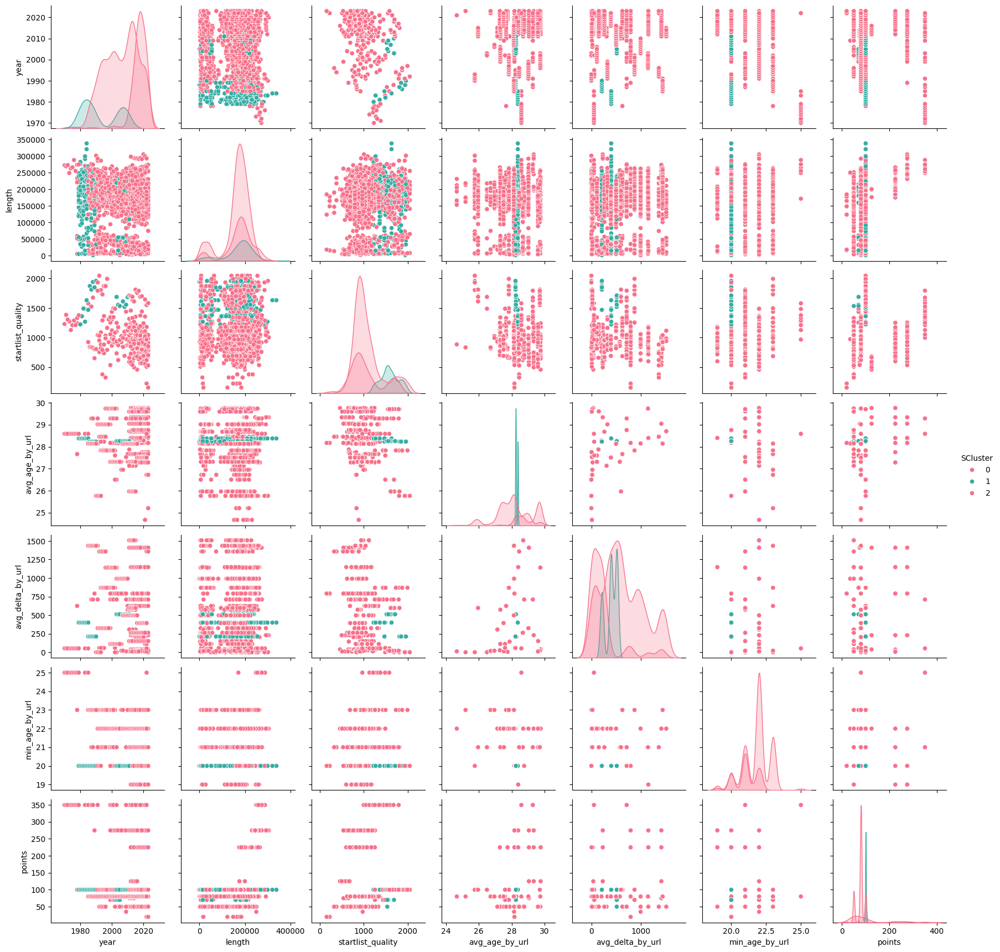

   Cluster  Count
0        0   1753
1        1    389
2        2    753
          year         length  startlist_quality  avg_age_by_url  \
0  2005.973189  164759.366800        1075.679977       27.864634   
1  1993.079692  171794.215938        1585.616967       28.294941   
2  2016.818061  174131.155378        1066.520584       29.125871   

   avg_delta_by_url  min_age_by_url      points  
0        637.199663       21.863662   77.766686  
1        398.970454       20.000000   99.254499  
2        235.114182       21.087649  109.037185  
avg_age_by_url          0.641135
min_age_by_url          0.936164
year                   11.883909
points                 15.996203
avg_delta_by_url      202.185875
startlist_quality     297.091647
length               4878.196551
dtype: float64


In [40]:
spect_clustering = SpectralClustering(n_clusters=3, affinity='nearest_neighbors', n_neighbors=50, random_state=1804)
labels = spect_clustering.fit_predict(std_stages)
clustering.optimal_pair_plot(stages, 'SCluster', labels)

Nothing interesting to see from plots

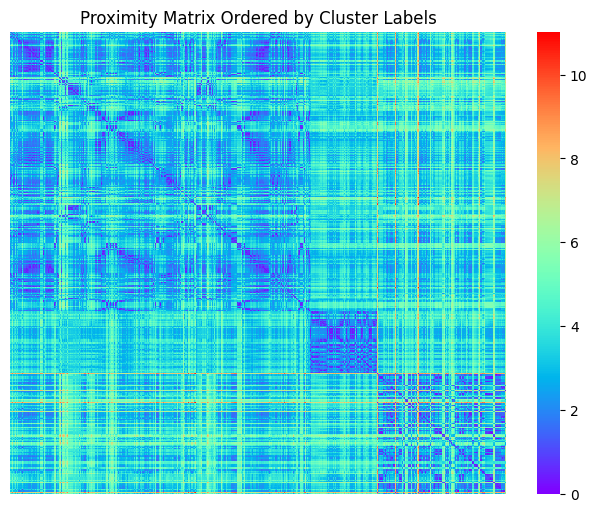

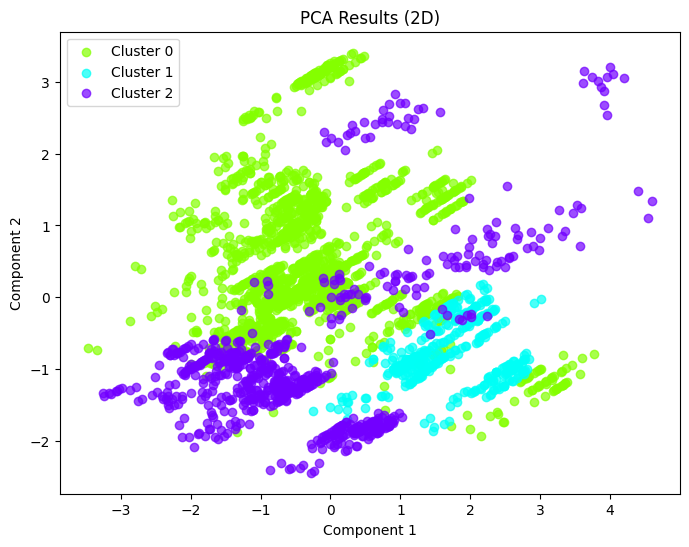

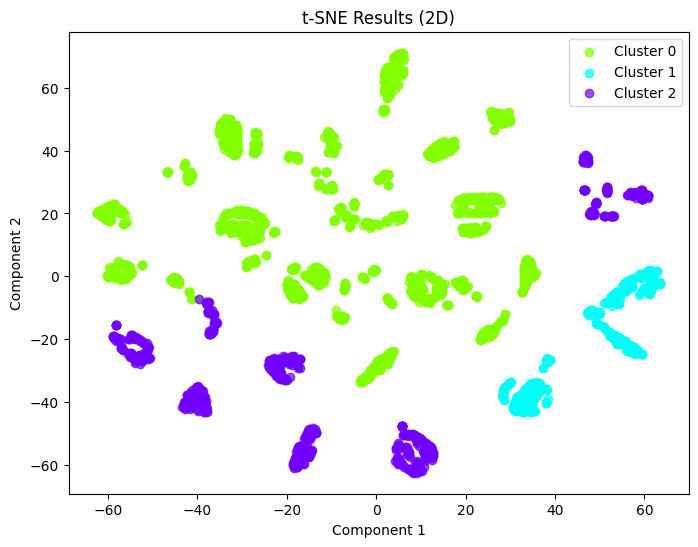

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


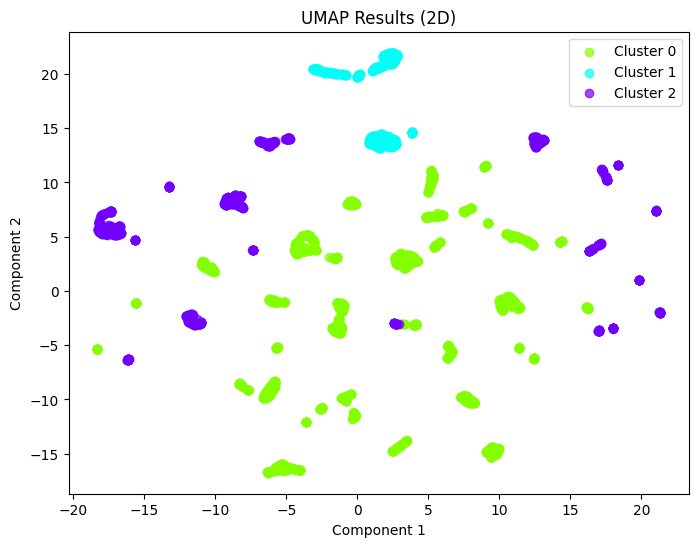

In [41]:
data_scaled = std_stages

clustering.similarity_matrix(std_stages, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels, title="UMAP Results (2D)", dimensions=2)

Visualization shows overlap or points very far from same clusters

## DBscan

### Cyclists

tuning with k-distance plot 2*columns (empirical rule) and 2^columns (data dispersion rule)

In [42]:
dst_matrix_euclid_cyclists = clustering.compute_distance_matrix(std_cyclists,"euclidean")
dst_matrix_euclid_cyclists = squareform(dst_matrix_euclid_cyclists)
ks = [2*std_cyclists.shape[1], pow(2,std_cyclists.shape[1])]

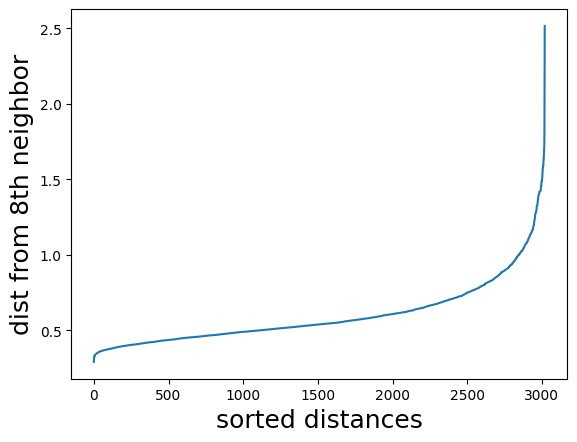

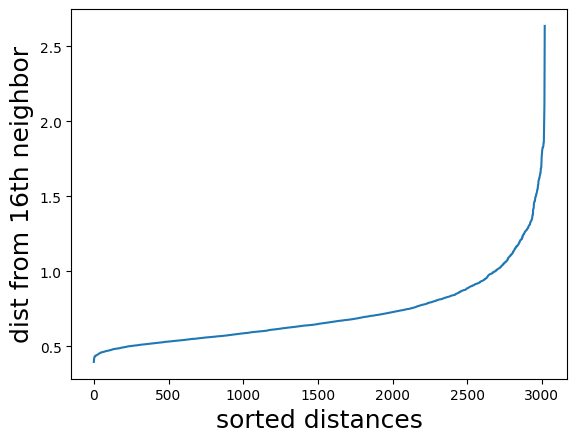

In [43]:
for dist, k in zip([dst_matrix_euclid_cyclists, dst_matrix_euclid_cyclists], ks):
    kth_distances = list()
    for d in dist:
        index_kth_distance = np.argsort(d)[k]
        kth_distances.append(d[index_kth_distance])

    plt.plot(range(0, len(kth_distances)), sorted(kth_distances))
    plt.ylabel("dist from %sth neighbor" % k, fontsize=18)
    plt.xlabel("sorted distances", fontsize=18)
    plt.show()

Looking to the results varying epsilon

     eps  Clusters   Noise
0   0.50      12.0  1041.0
1   0.51       8.0   941.0
2   0.52       4.0   872.0
3   0.53       4.0   800.0
4   0.54       1.0   754.0
5   0.55       1.0   709.0
6   0.56       2.0   636.0
7   0.57       2.0   598.0
8   0.58       1.0   569.0
9   0.59       1.0   539.0
10  0.60       1.0   508.0
11  0.61       2.0   475.0
12  0.62       2.0   441.0
13  0.63       2.0   419.0
14  0.64       2.0   388.0
15  0.65       1.0   371.0
16  0.66       1.0   360.0
17  0.67       1.0   332.0
18  0.68       1.0   319.0
19  0.69       1.0   307.0
20  0.70       1.0   284.0
21  0.71       1.0   269.0
22  0.72       1.0   262.0
23  0.73       1.0   245.0
24  0.74       1.0   237.0
25  0.75       1.0   220.0
26  0.76       1.0   202.0
27  0.77       1.0   196.0
28  0.78       1.0   178.0
29  0.79       2.0   169.0
30  0.80       2.0   161.0
31  0.81       3.0   144.0
32  0.82       2.0   134.0
33  0.83       2.0   131.0
34  0.84       2.0   120.0
35  0.85       2.0   111.0
3

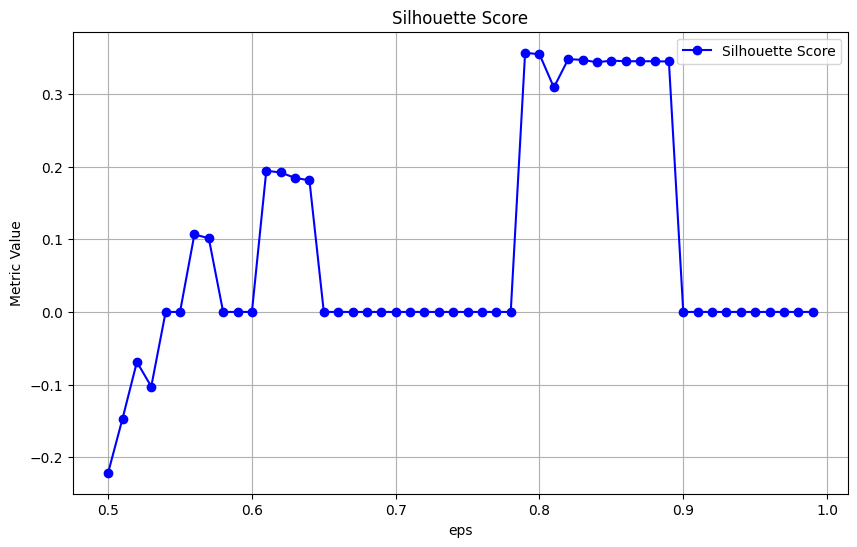

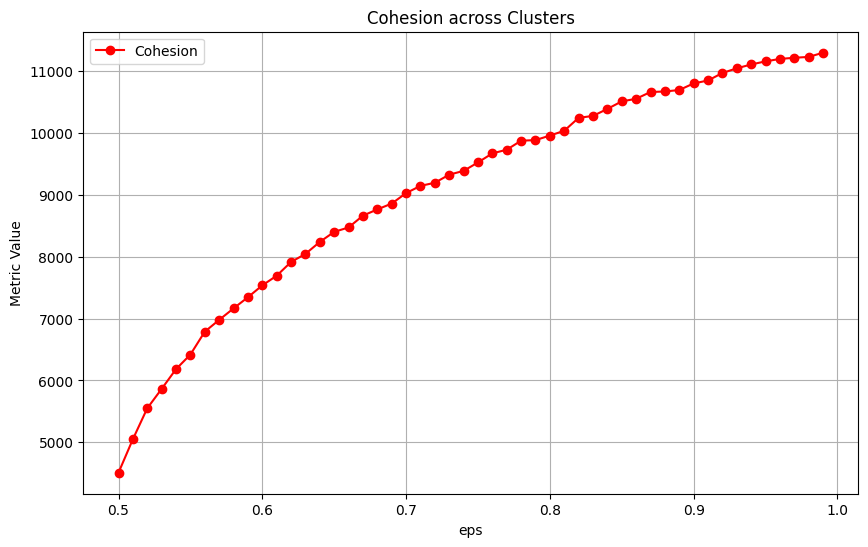

     eps  Clusters   Noise
0   0.50       4.0  2065.0
1   0.51       4.0  1935.0
2   0.52       2.0  1789.0
3   0.53       3.0  1686.0
4   0.54       3.0  1607.0
5   0.55       3.0  1489.0
6   0.56       1.0  1374.0
7   0.57       1.0  1276.0
8   0.58       1.0  1212.0
9   0.59       2.0  1101.0
10  0.60       2.0  1027.0
11  0.61       2.0   935.0
12  0.62       2.0   871.0
13  0.63       2.0   791.0
14  0.64       2.0   721.0
15  0.65       2.0   689.0
16  0.66       2.0   647.0
17  0.67       1.0   585.0
18  0.68       1.0   535.0
19  0.69       1.0   504.0
20  0.70       1.0   474.0
21  0.71       1.0   448.0
22  0.72       1.0   419.0
23  0.73       1.0   395.0
24  0.74       1.0   373.0
25  0.75       1.0   356.0
26  0.76       1.0   332.0
27  0.77       1.0   315.0
28  0.78       1.0   301.0
29  0.79       1.0   285.0
30  0.80       1.0   267.0
31  0.81       1.0   248.0
32  0.82       1.0   235.0
33  0.83       1.0   225.0
34  0.84       1.0   217.0
35  0.85       1.0   206.0
3

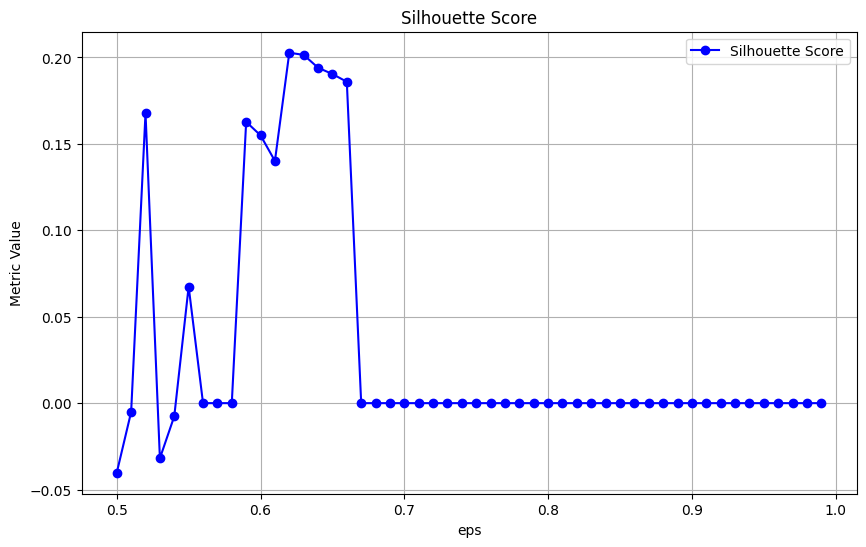

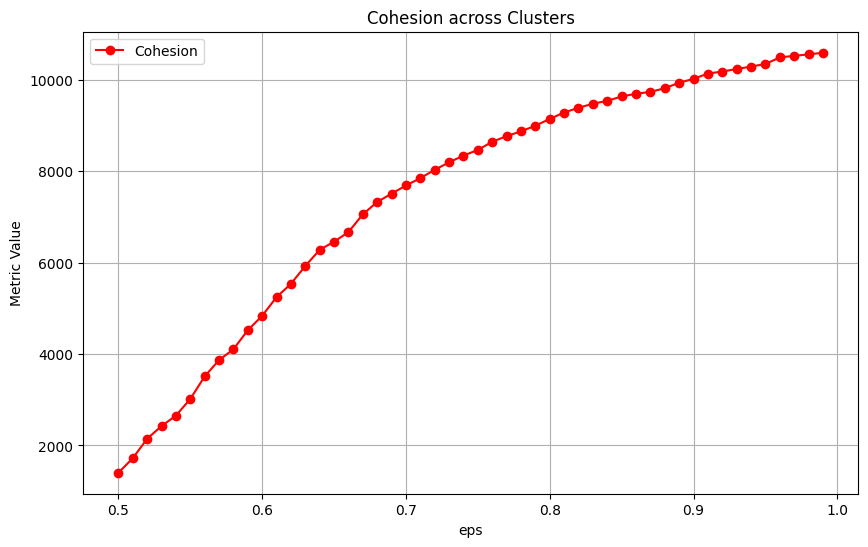

In [44]:
clustering.dbscan_tune(std_cyclists, dst_matrix_euclid_cyclists, np.arange(0.5, 1.0, 0.01), 2*std_cyclists.shape[1])
clustering.dbscan_tune(std_cyclists, dst_matrix_euclid_cyclists, np.arange(0.5, 1.0, 0.01), pow(2,std_cyclists.shape[1]))

Plot best results (very bad results in all cases). We have or all dataset as outlier or 1 single cluster or many small clusters with few points and almost all dataset as outlier

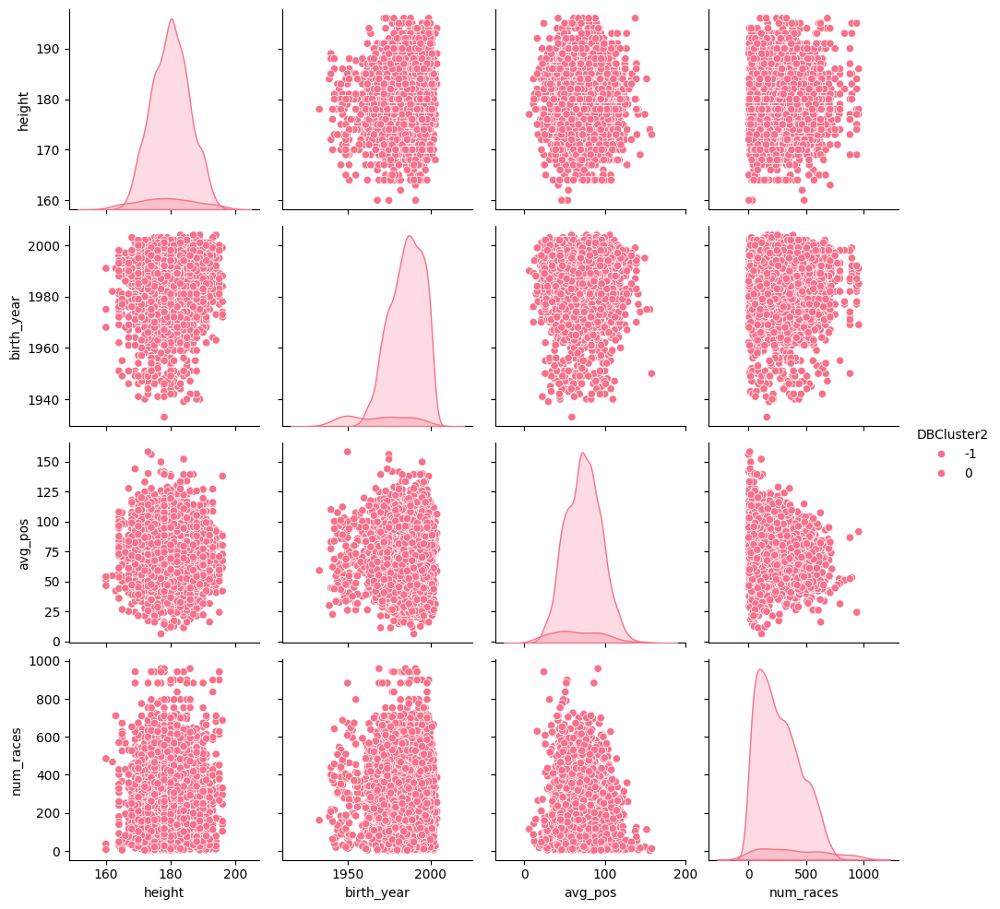

   Cluster  Count
0        0   2736
1       -1    284
       height   birth_year    avg_pos   num_races
0  179.944225  1985.500365  73.485651  268.037281
height       NaN
birth_year   NaN
avg_pos      NaN
num_races    NaN
dtype: float64


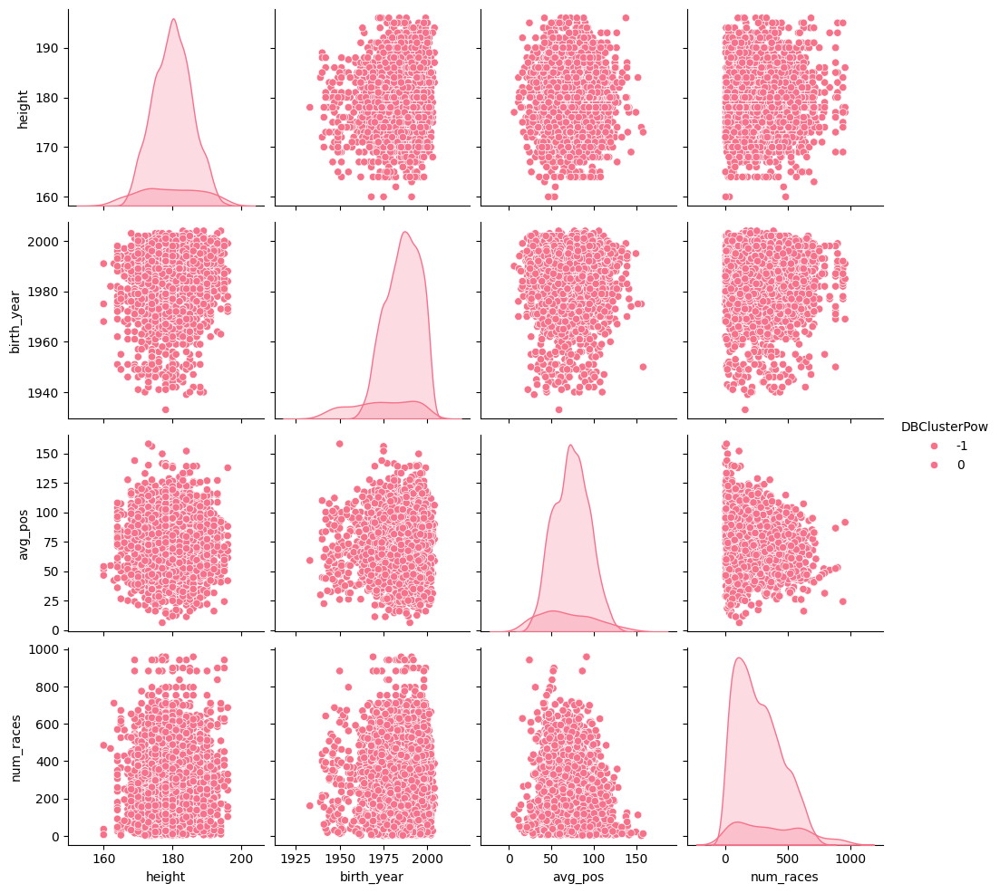

   Cluster  Count
0        0   2546
1       -1    474
       height   birth_year    avg_pos   num_races
0  179.923488  1985.823252  73.704627  264.308327
height       NaN
birth_year   NaN
avg_pos      NaN
num_races    NaN
dtype: float64


In [45]:
dbscan = DBSCAN(eps=0.7, min_samples=2*std_cyclists.shape[1], metric="precomputed", n_jobs=-1)
dbscan.fit_predict(dst_matrix_euclid_cyclists)
labels1 = dbscan.labels_

clustering.optimal_pair_plot(cyclists, 'DBCluster2', labels1)

dbscan = DBSCAN(eps=0.7, min_samples=pow(2,std_cyclists.shape[1]), metric="precomputed", n_jobs=-1)
dbscan.fit_predict(dst_matrix_euclid_cyclists)
labels2 = dbscan.labels_

clustering.optimal_pair_plot(cyclists, 'DBClusterPow', labels2)

Nothing interesting to visualize

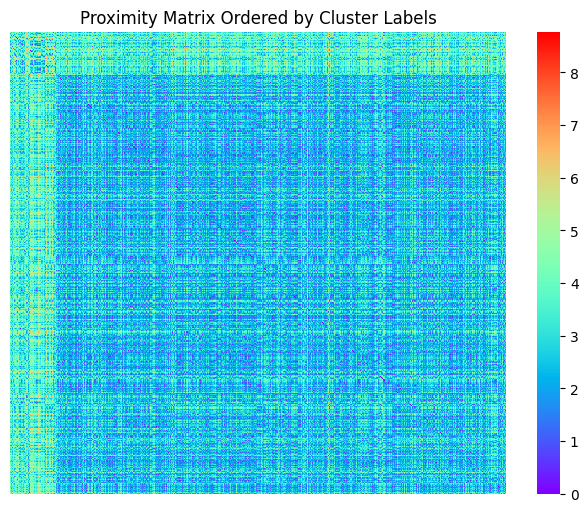

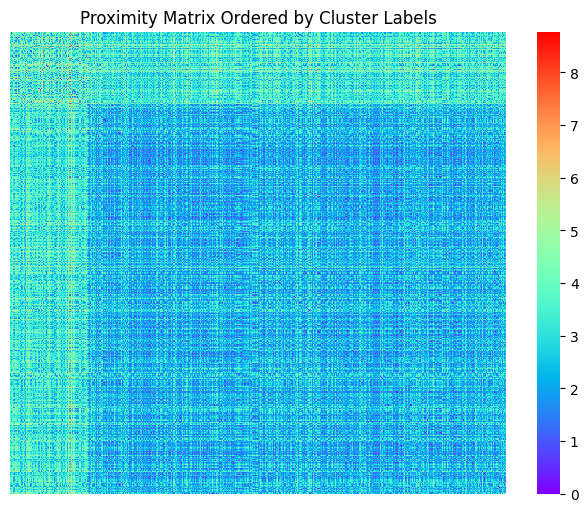

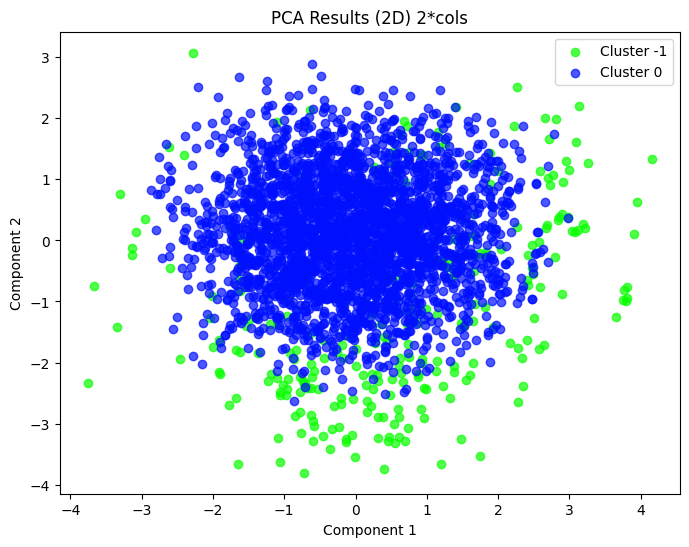

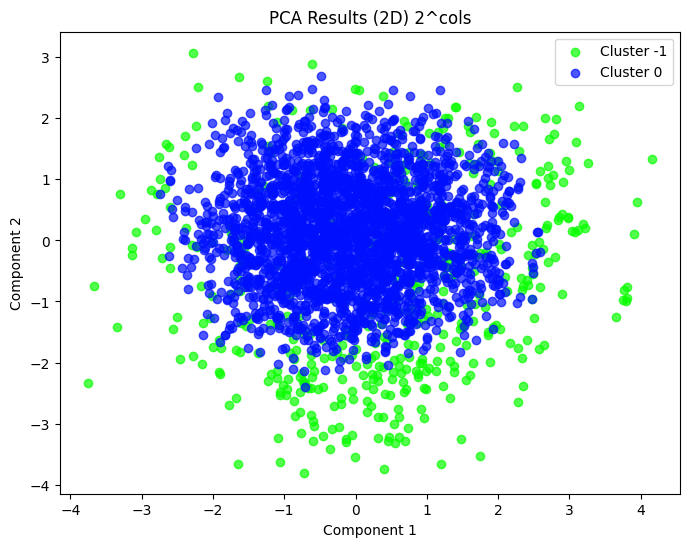

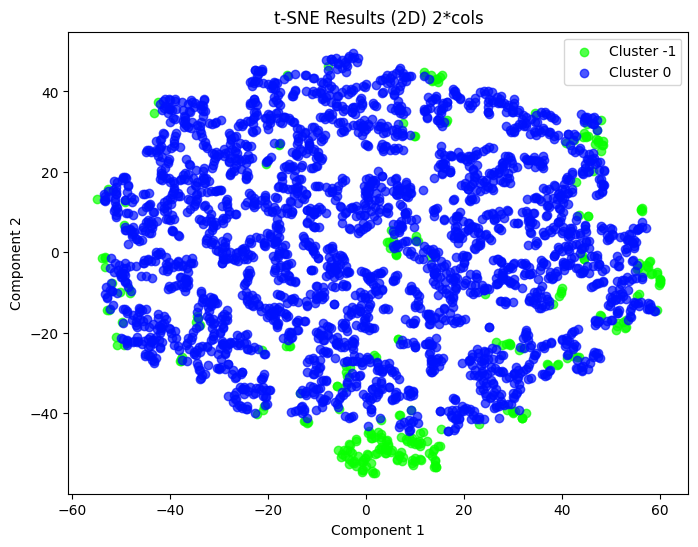

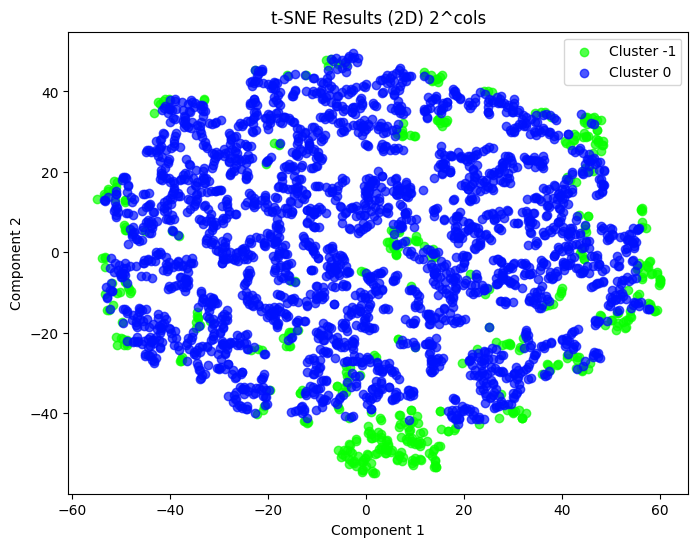

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


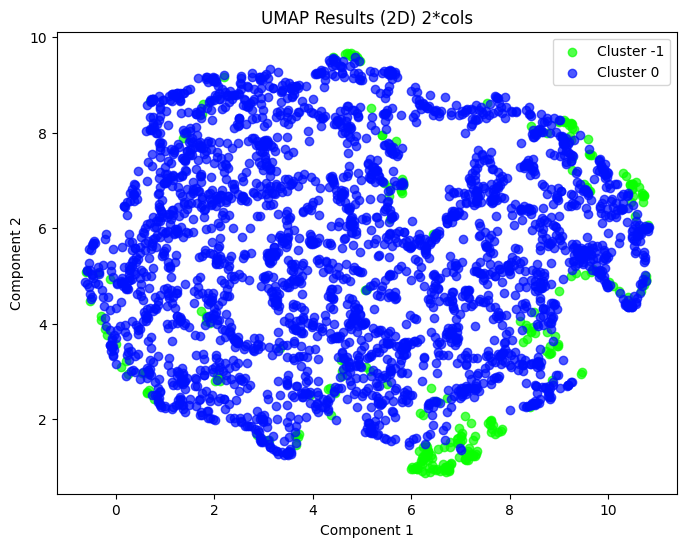

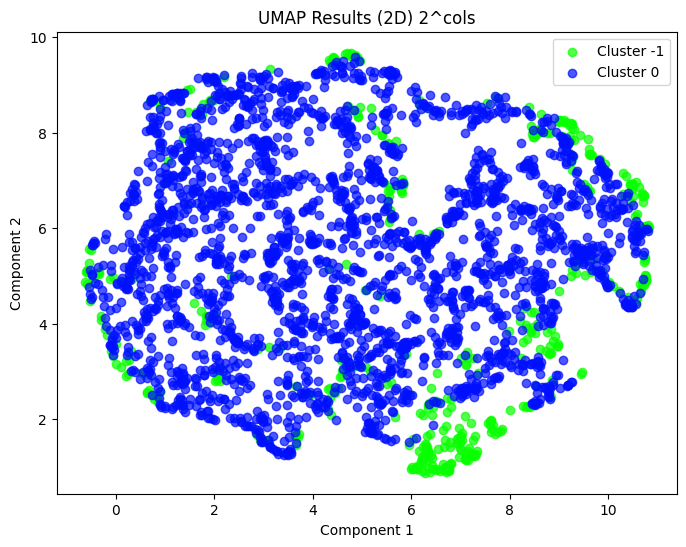

In [46]:
data_scaled = std_cyclists

clustering.similarity_matrix(std_cyclists, labels1)
clustering.similarity_matrix(std_cyclists, labels2)

pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels1, title="PCA Results (2D) 2*cols", dimensions=2)
plot_results(pca_2d, labels2, title="PCA Results (2D) 2^cols", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels1, title="t-SNE Results (2D) 2*cols", dimensions=2)
plot_results(tsne_2d, labels2, title="t-SNE Results (2D) 2^cols", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels1, title="UMAP Results (2D) 2*cols", dimensions=2)
plot_results(umap_2d, labels2, title="UMAP Results (2D) 2^cols", dimensions=2)

### Stages

Tuning done as for cyclists

In [47]:
dst_matrix_euclid_stages = clustering.compute_distance_matrix(std_stages, "euclidean")
dst_matrix_euclid_stages = squareform(dst_matrix_euclid_stages)
ks = [std_stages.shape[1] * 2, pow(2, std_stages.shape[1])]

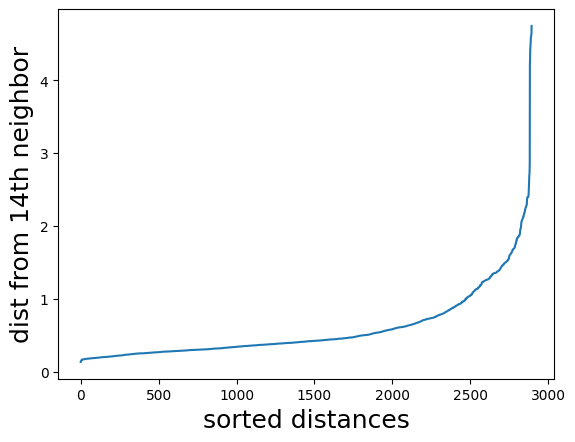

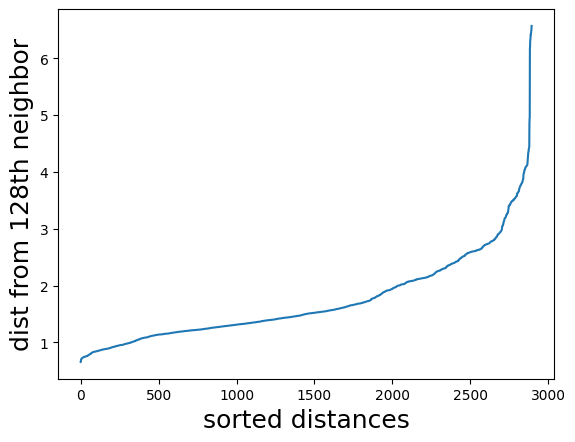

In [48]:
for dist, k in zip([dst_matrix_euclid_stages, dst_matrix_euclid_stages], ks):
    kth_distances = list()
    for d in dist:
        index_kth_distance = np.argsort(d)[k]
        kth_distances.append(d[index_kth_distance])

    plt.plot(range(0, len(kth_distances)), sorted(kth_distances))
    plt.ylabel("dist from %sth neighbor" % k, fontsize=18)
    plt.xlabel("sorted distances", fontsize=18)
    plt.show()

Let's see results varying epsilon

     eps  Clusters  Noise
0   0.80      34.0  366.0
1   0.81      34.0  365.0
2   0.82      34.0  363.0
3   0.83      33.0  363.0
4   0.84      33.0  363.0
..   ...       ...    ...
65  1.45      13.0  106.0
66  1.46      13.0  103.0
67  1.47      12.0  101.0
68  1.48      12.0   98.0
69  1.49      12.0   96.0

[70 rows x 3 columns]


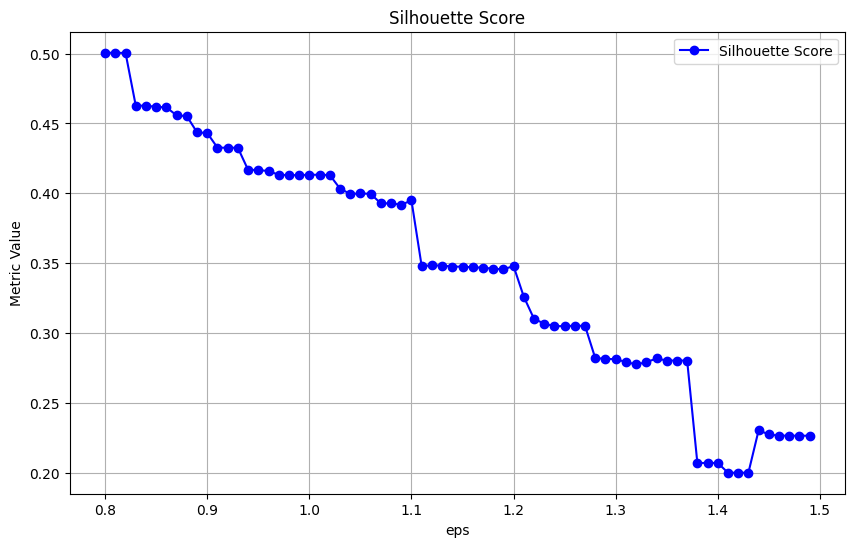

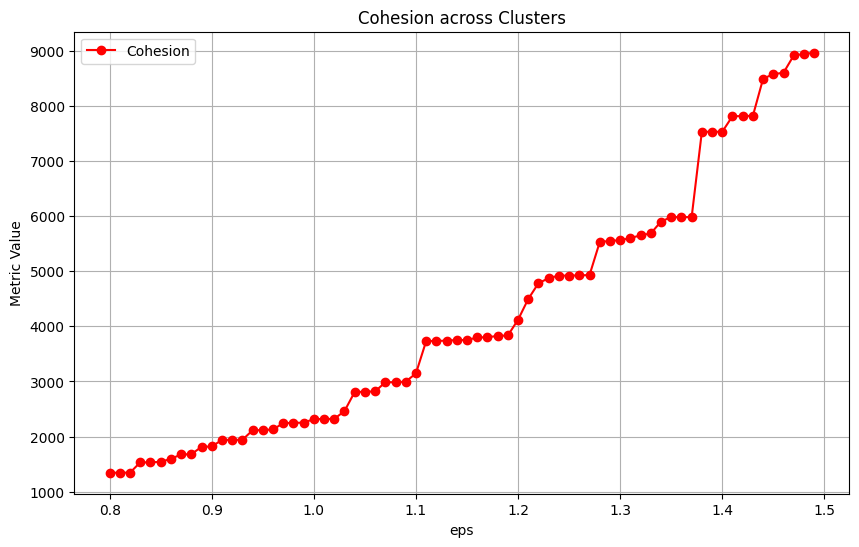

      eps  Clusters  Noise
0    2.00       1.0  221.0
1    2.01       1.0  220.0
2    2.02       1.0  207.0
3    2.03       1.0  207.0
4    2.04       1.0  207.0
..    ...       ...    ...
195  3.95       1.0   12.0
196  3.96       1.0   12.0
197  3.97       1.0   12.0
198  3.98       1.0   12.0
199  3.99       1.0   12.0

[200 rows x 3 columns]


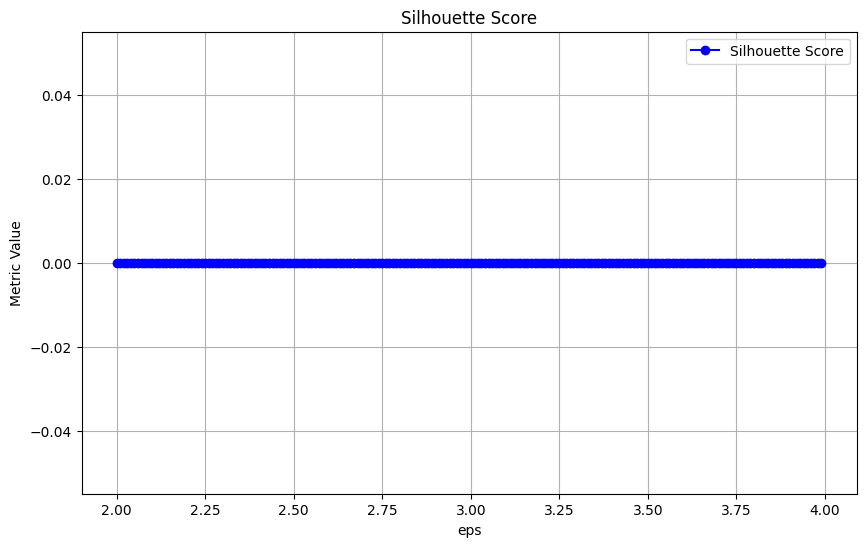

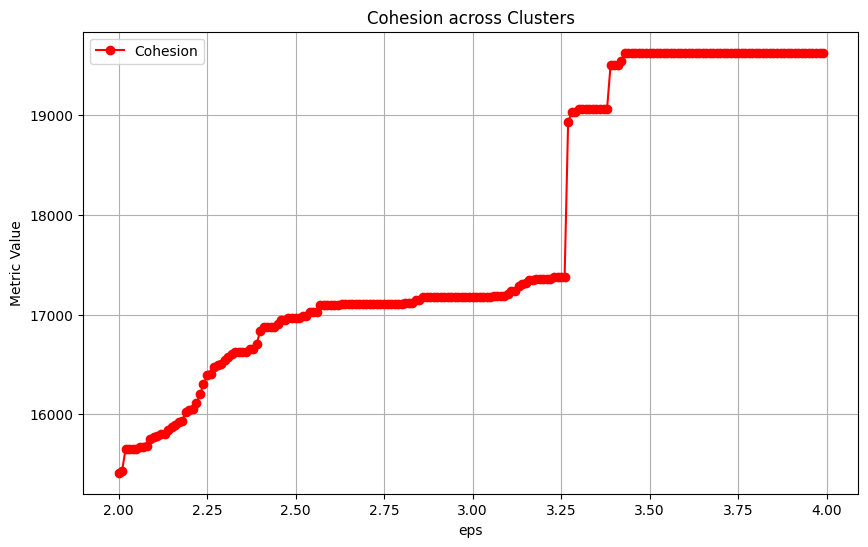

In [49]:
clustering.dbscan_tune(std_stages, dst_matrix_euclid_stages, np.arange(0.8, 1.5, 0.01), 2* std_stages.shape[1])
clustering.dbscan_tune(std_stages, dst_matrix_euclid_stages, np.arange(2, 4, 0.01), pow(2,std_stages.shape[1]))

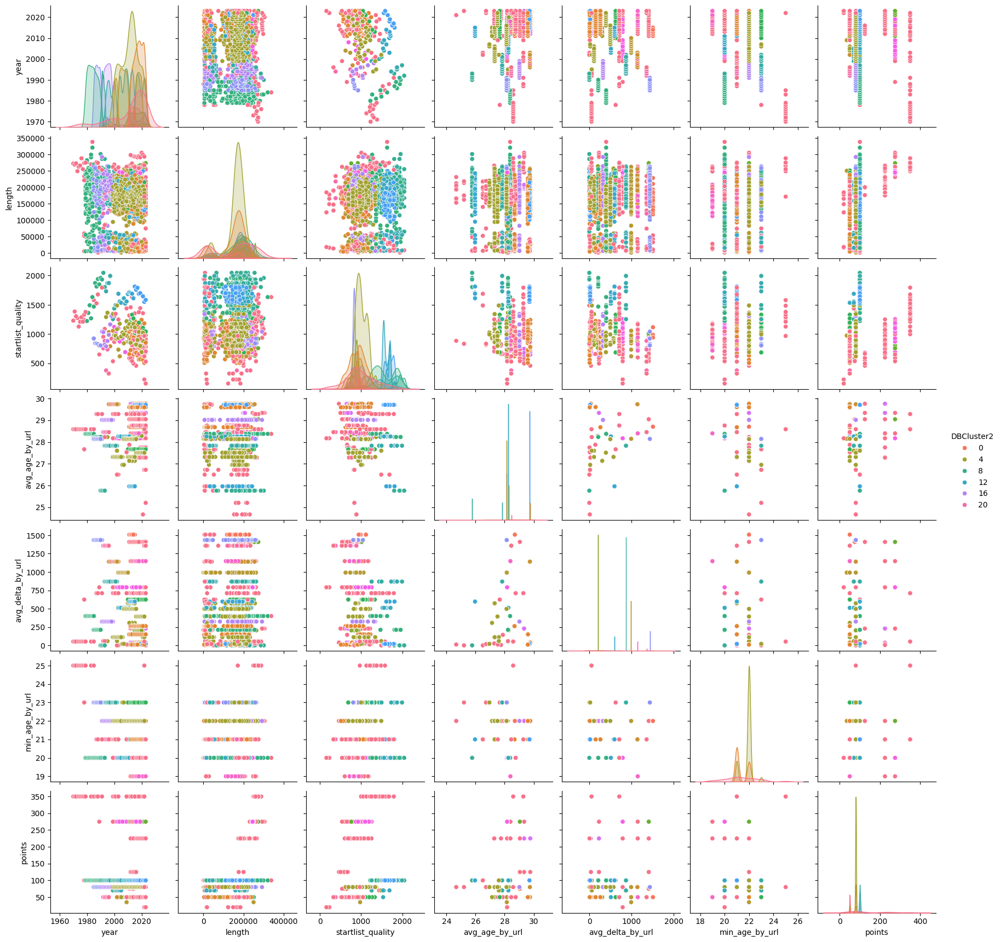

    Cluster  Count
0         0     30
1         1    331
2         2     55
3         3    155
4         4    635
5         5     99
6         6     17
7         7     73
8         8    234
9         9     52
10       10    124
11       11     18
12       12    152
13       13     71
14       14    144
15       15    127
16       16    168
17       17     21
18       18     16
19       19     28
20       20     15
21       21     69
22       -1    261
           year         length  startlist_quality  avg_age_by_url  \
0   2012.866667  166683.333333         985.800000       28.714506   
1   2017.610272  148035.498489         897.184290       29.319922   
2   2000.890909  186436.363636         899.763636       29.737805   
3   2006.419355  168517.096774         881.025806       28.146497   
4   2011.003150  162118.897638        1008.316535       27.590930   
5   2017.838384  187454.545455         862.666667       28.283186   
6   2017.588235  258847.058824         818.117647       29.04

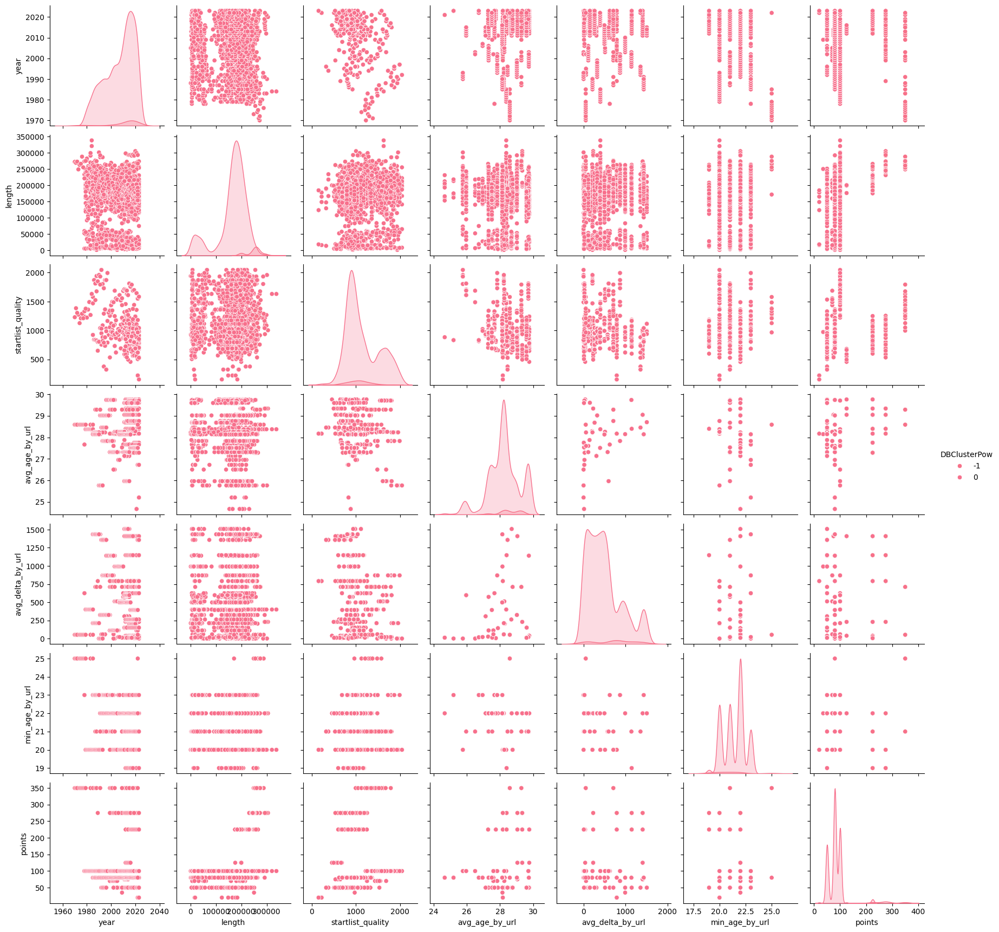

   Cluster  Count
0        0   2783
1       -1    112
          year         length  startlist_quality  avg_age_by_url  \
0  2006.950054  164781.807402        1145.022997       28.236863   

   avg_delta_by_url  min_age_by_url     points  
0        491.472185       21.423284  81.015092  
year                NaN
length              NaN
startlist_quality   NaN
avg_age_by_url      NaN
avg_delta_by_url    NaN
min_age_by_url      NaN
points              NaN
dtype: float64


In [50]:
dbscan = DBSCAN(eps=1.1, min_samples=2*std_stages.shape[1], metric="precomputed", n_jobs=-1)
dbscan.fit_predict(dst_matrix_euclid_stages)
labels1 = dbscan.labels_

clustering.optimal_pair_plot(stages, 'DBCluster2', labels1)

dbscan = DBSCAN(eps=3.1, min_samples=pow(2,std_stages.shape[1]), metric="precomputed", n_jobs=-1)
dbscan.fit_predict(dst_matrix_euclid_stages)
labels2 = dbscan.labels_

clustering.optimal_pair_plot(stages, 'DBClusterPow', labels2)

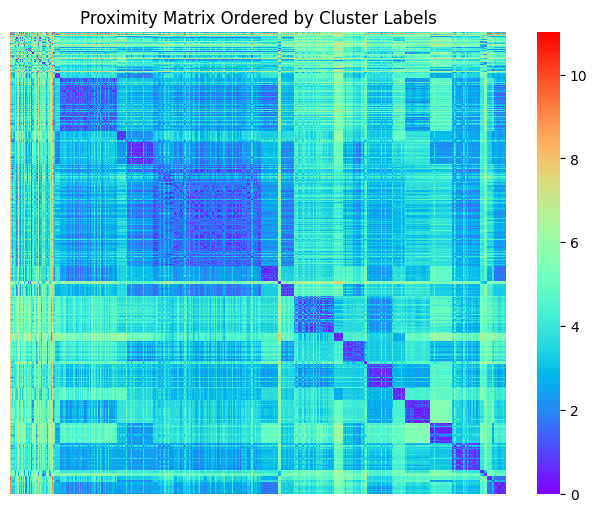

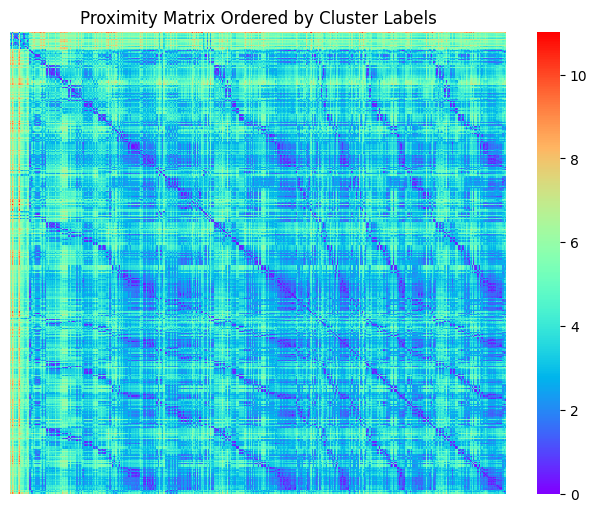

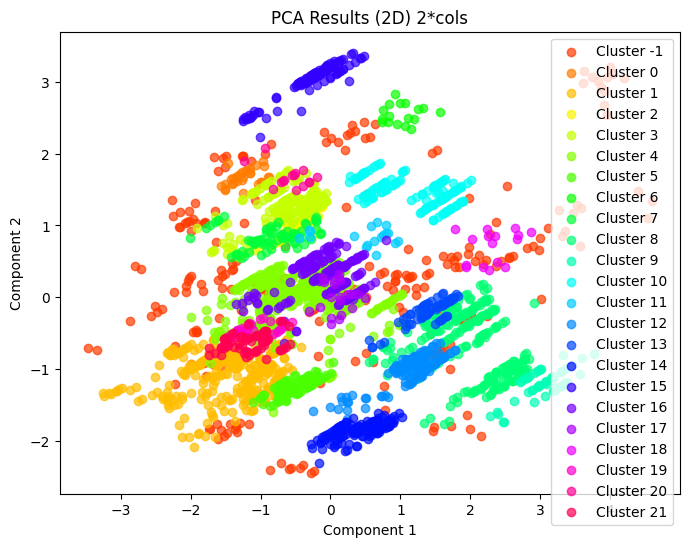

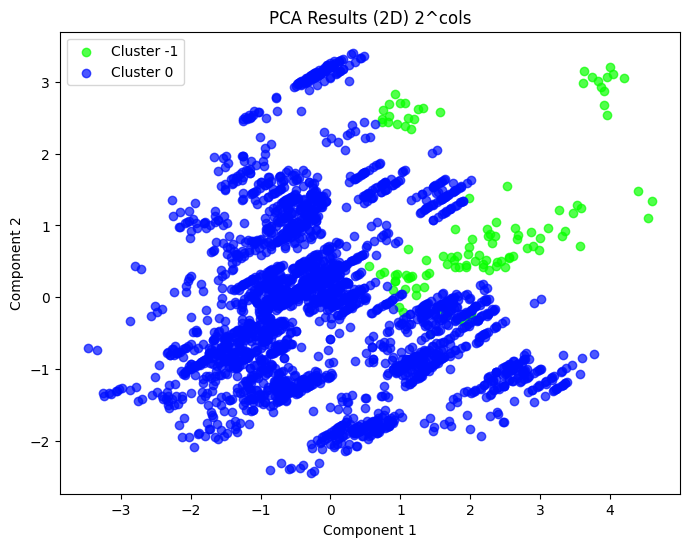

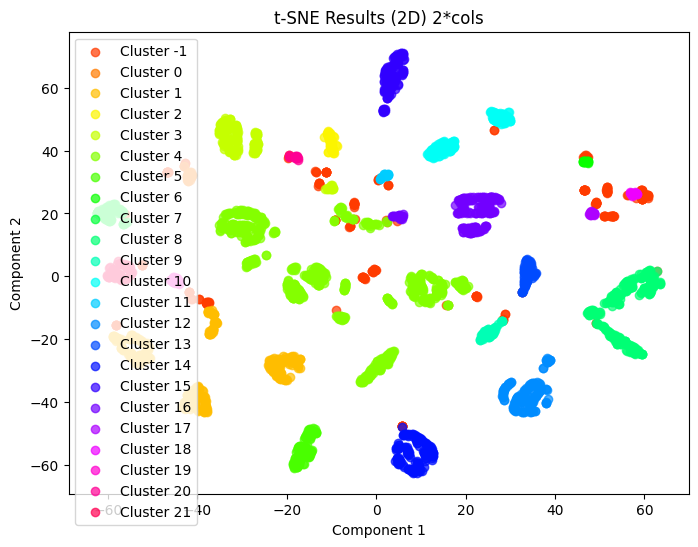

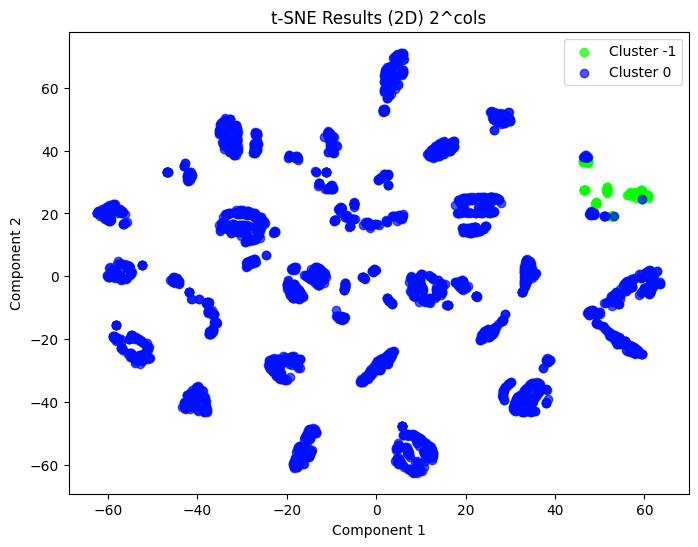

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


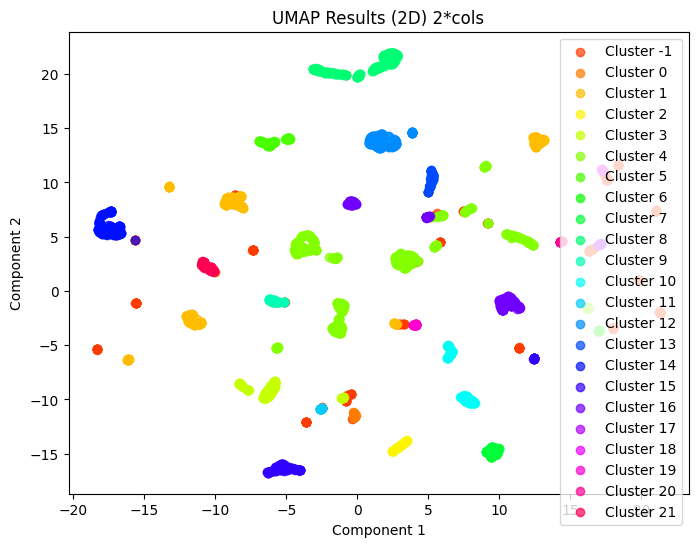

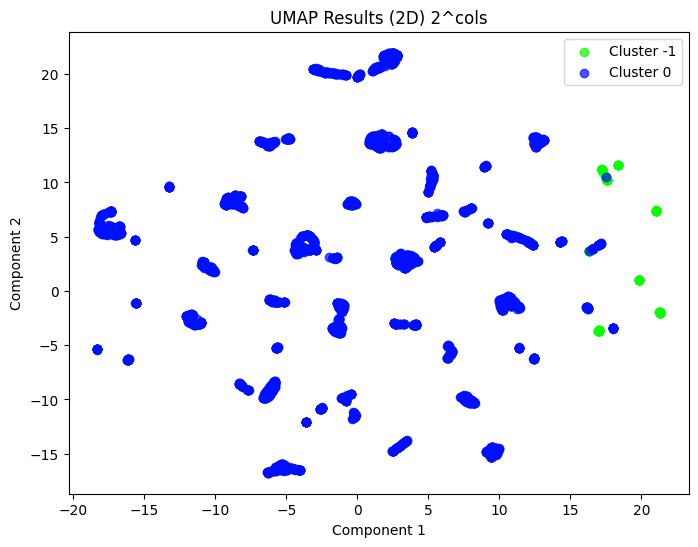

In [51]:
data_scaled = std_stages

clustering.similarity_matrix(std_stages, labels1)
clustering.similarity_matrix(std_stages, labels2)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels1, title="PCA Results (2D) 2*cols", dimensions=2)
plot_results(pca_2d, labels2, title="PCA Results (2D) 2^cols", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels1, title="t-SNE Results (2D) 2*cols", dimensions=2)
plot_results(tsne_2d, labels2, title="t-SNE Results (2D) 2^cols", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels1, title="UMAP Results (2D) 2*cols", dimensions=2)
plot_results(umap_2d, labels2, title="UMAP Results (2D) 2^cols", dimensions=2)

### Optics
Tuning according to https://www.sefidian.com/2022/12/18/how-to-determine-epsilon-and-minpts-parameters-of-dbscan-clustering/#:~:text=A%20value%20of%20MinPts%20%3D%202,largest%20to%20the%20smallest%20value.

### Optics Cyclists

Hyperparameters tuning

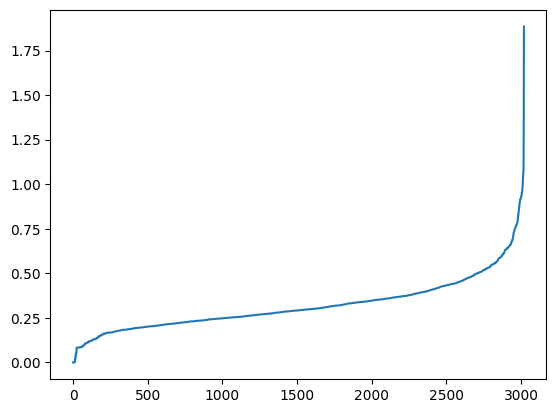

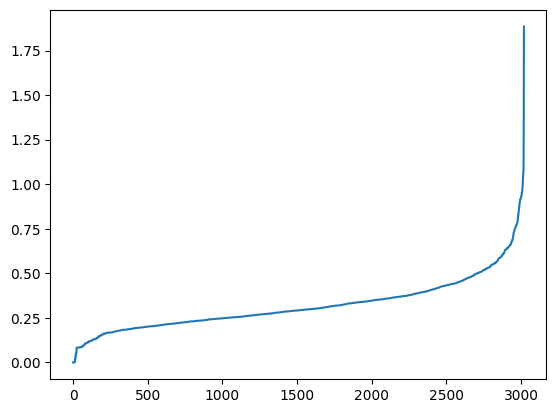

In [52]:
from sklearn.neighbors import NearestNeighbors
def knn_tune(df, samples):
    neighbors = NearestNeighbors(n_neighbors=samples)
    neighbors_fit = neighbors.fit(df)
    distances, indices = neighbors_fit.kneighbors(df)
    distances = np.sort(distances, axis=0)
    distances = distances[:,1]
    plt.plot(distances)
    plt.show()
knn_tune(std_cyclists, std_cyclists.shape[1]*2)
knn_tune(std_cyclists, pow(2,std_cyclists.shape[1]))   

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(


Results for different eps values:
     eps  Clusters   Noise
0   0.25       0.0  3020.0
1   0.26       0.0  3020.0
2   0.27       0.0  3020.0
3   0.28       0.0  3020.0
4   0.29       1.0  3012.0
5   0.30       1.0  3011.0
6   0.31       1.0  3011.0
7   0.32       3.0  2981.0
8   0.33       6.0  2952.0
9   0.34       9.0  2903.0
10  0.35      14.0  2833.0
11  0.36      15.0  2746.0
12  0.37      13.0  2687.0
13  0.38      12.0  2860.0
14  0.39      14.0  2825.0
15  0.40      16.0  2849.0
16  0.41      11.0  2866.0
17  0.42       9.0  2904.0
18  0.43       9.0  2907.0
19  0.44      10.0  2920.0
20  0.45      10.0  2918.0
21  0.46      11.0  2904.0
22  0.47       9.0  2926.0
23  0.48       9.0  2925.0
24  0.49      11.0  2896.0
25  0.50       9.0  2926.0
26  0.51       8.0  2939.0
27  0.52       6.0  2961.0
28  0.53       7.0  2952.0
29  0.54       6.0  2961.0
30  0.55       8.0  2936.0
31  0.56       8.0  2936.0
32  0.57       8.0  2936.0
33  0.58       8.0  2936.0
34  0.59       8.0  2

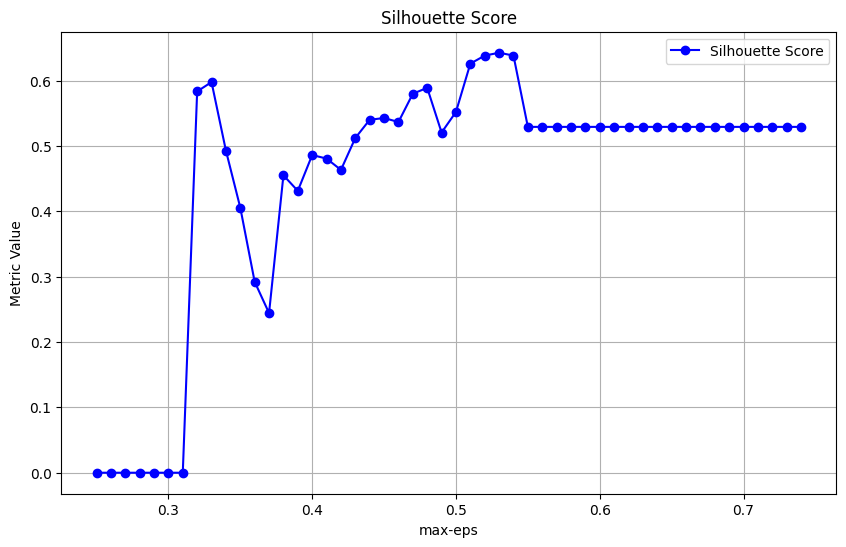

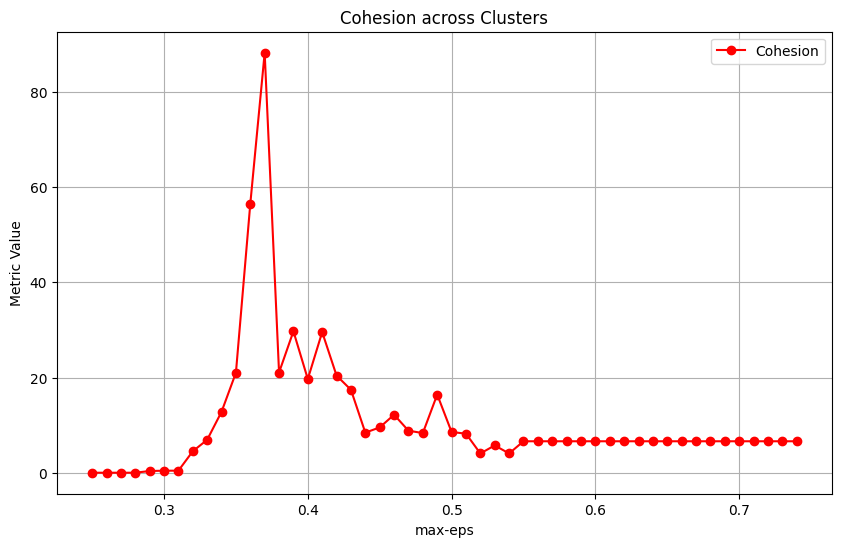

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.

Results for different eps values:
     eps  Clusters   Noise
0   0.25       0.0  3020.0
1   0.26       0.0  3020.0
2   0.27       0.0  3020.0
3   0.28       0.0  3020.0
4   0.29       0.0  3020.0
5   0.30       0.0  3020.0
6   0.31       0.0  3020.0
7   0.32       0.0  3020.0
8   0.33       0.0  3020.0
9   0.34       0.0  3020.0
10  0.35       0.0  3020.0
11  0.36       0.0  3020.0
12  0.37       0.0  3020.0
13  0.38       0.0  3020.0
14  0.39       0.0  3020.0
15  0.40       0.0  3020.0
16  0.41       1.0  3003.0
17  0.42       1.0  2984.0
18  0.43       3.0  2940.0
19  0.44       3.0  2868.0
20  0.45       8.0  2708.0
21  0.46       8.0  2592.0
22  0.47       2.0  2478.0
23  0.48       1.0  2381.0
24  0.49       1.0  2261.0
25  0.50       2.0  2098.0
26  0.51       1.0  3003.0
27  0.52       1.0  1814.0
28  0.53       1.0  1716.0
29  0.54       1.0  1635.0
30  0.55       1.0  1515.0
31  0.56       1.0  1374.0
32  0.57       1.0  1277.0
33  0.58       1.0  1213.0
34  0.59       1.0  1

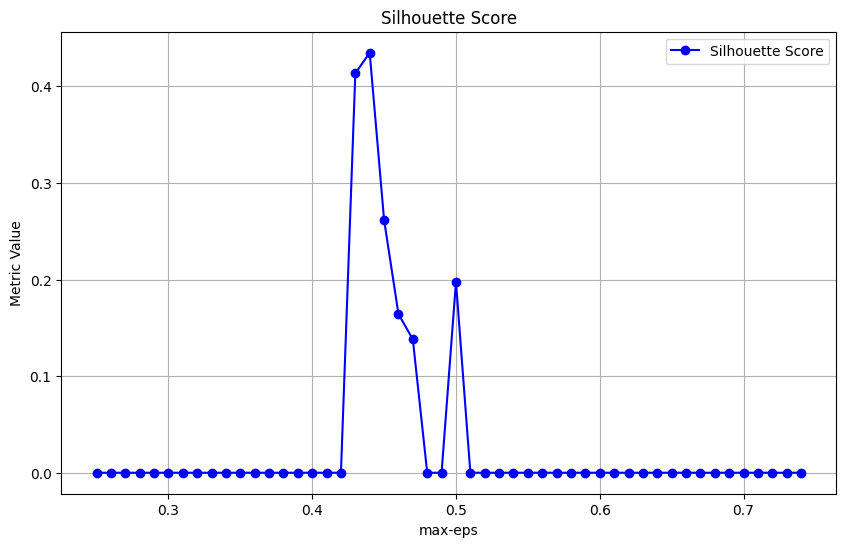

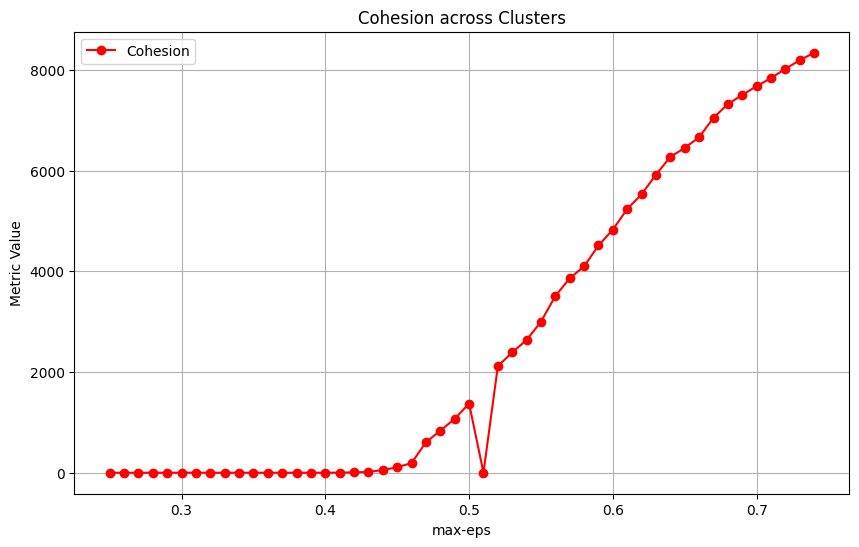

In [53]:
clustering.optics_tune(std_cyclists, np.arange(0.25, 0.75, 0.01), 2*std_cyclists.shape[1])
clustering.optics_tune(std_cyclists, np.arange(0.25, 0.75, 0.01), pow(2,std_cyclists.shape[1]))

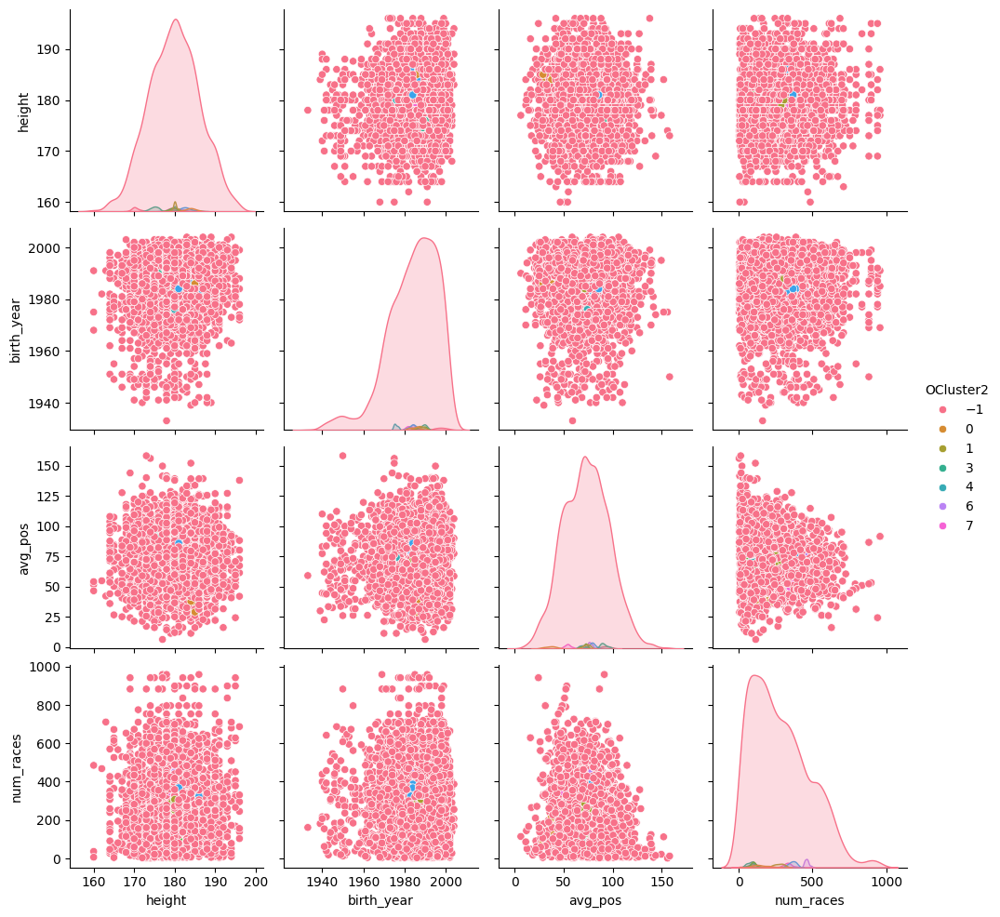

   Cluster  Count
0        0     10
1        1     11
2        2      9
3        3     13
4        4      8
5        5     14
6        6     10
7        7     10
8        8      9
9       -1   2926
       height   birth_year    avg_pos   num_races
0  184.000000  1984.800000  36.243440  145.900000
1  180.090909  1987.363636  72.976355  271.272727
2  179.555556  1988.444444  71.008786   98.222222
3  174.923077  1988.692308  91.130554   80.076923
4  179.875000  1975.750000  69.241285   89.625000
5  182.857143  1984.214286  78.652978  363.285714
6  180.400000  1983.400000  76.699420  460.100000
7  179.700000  1982.900000  54.334703  332.600000
8  170.333333  1997.777778  92.136435   86.333333
height          4.127110
birth_year      5.914100
avg_pos        17.444507
num_races     144.889074
dtype: float64


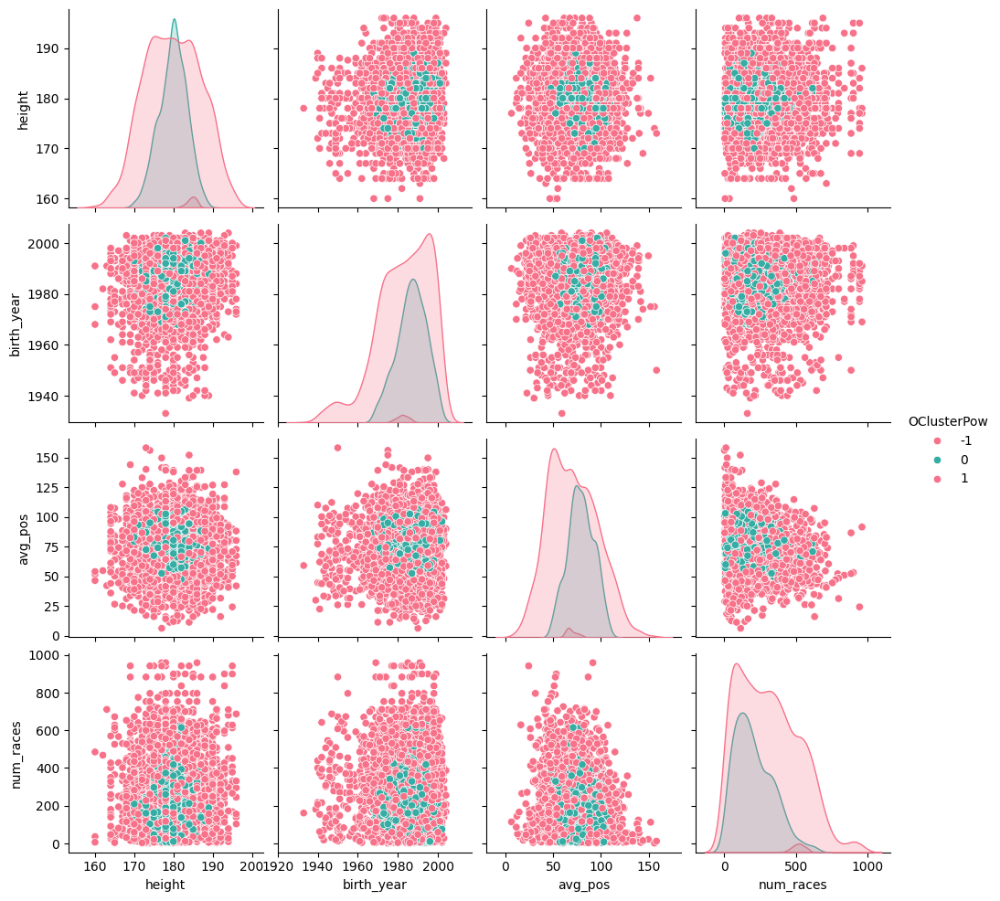

   Cluster  Count
0        0    902
1        1     20
2       -1   2098
       height   birth_year  avg_pos   num_races
0  179.808869  1986.700665  78.6883  207.150776
1  184.650000  1982.300000  69.0883  516.850000
birth_year      3.111740
height          3.423196
avg_pos         6.788225
num_races     218.990421
dtype: float64


In [54]:
optics = OPTICS(max_eps=0.5, min_samples=2*std_cyclists.shape[1], metric='euclidean')
optics.fit(std_cyclists.values)

labels1 = optics.labels_
clustering.optimal_pair_plot(cyclists, 'OCluster2', labels1)

optics = OPTICS(max_eps=0.5, min_samples=pow(2,std_cyclists.shape[1]), metric='euclidean')
optics.fit(std_cyclists.values)

labels2 = optics.labels_
clustering.optimal_pair_plot(cyclists, 'OClusterPow', labels2)

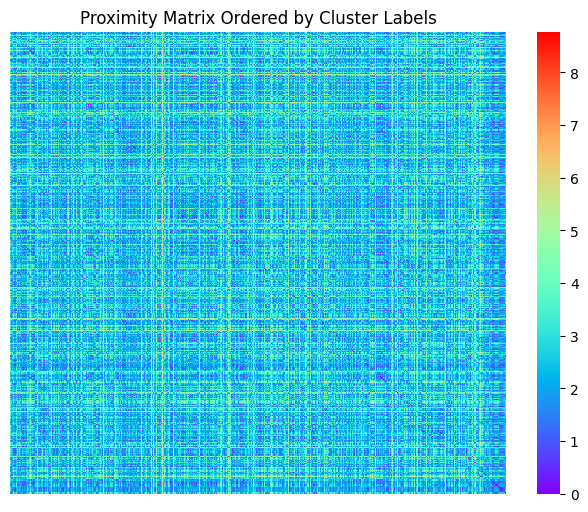

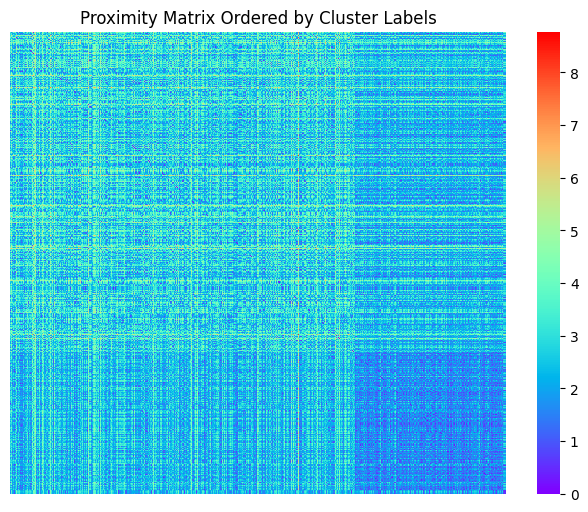

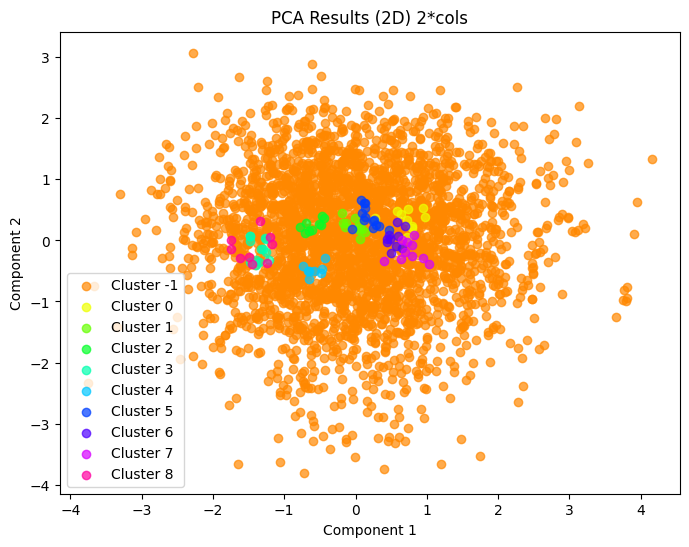

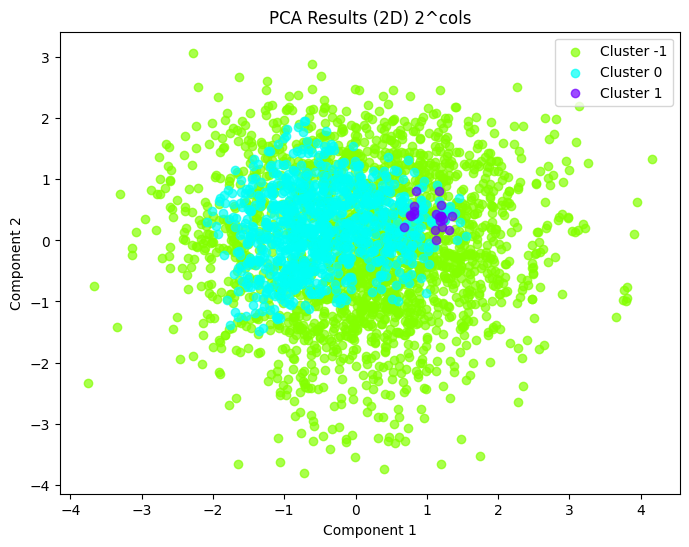

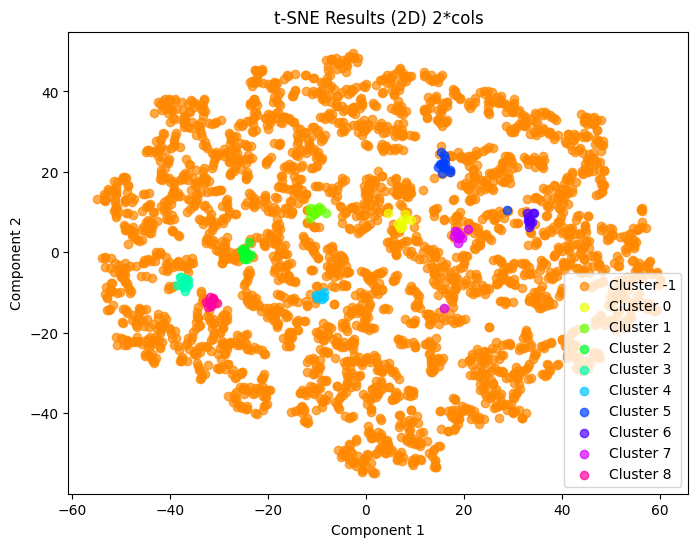

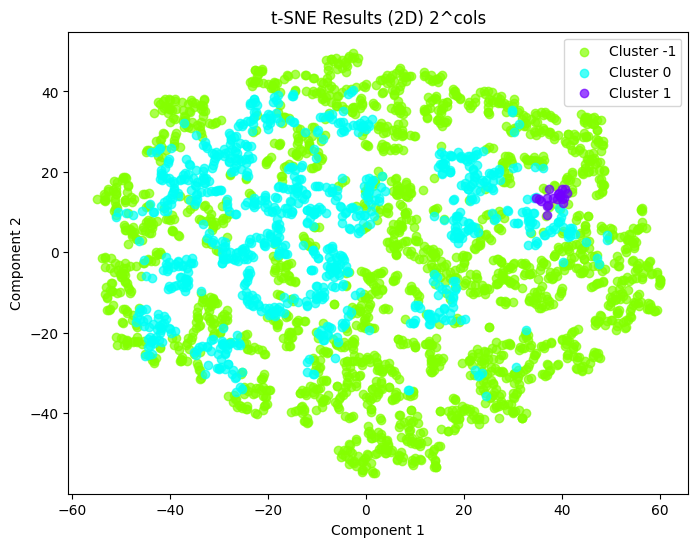

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


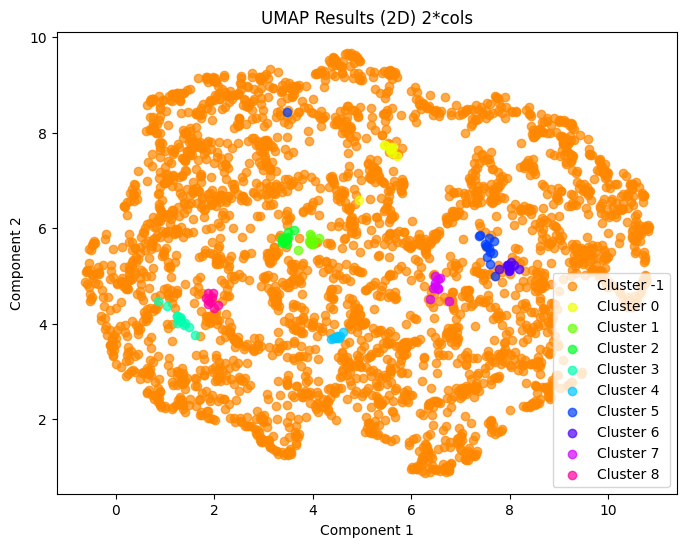

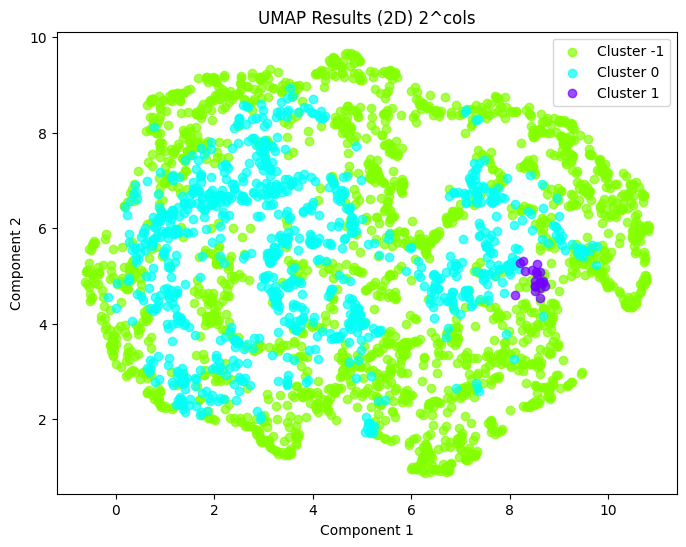

In [55]:
data_scaled = std_cyclists

clustering.similarity_matrix(std_cyclists, labels1)
clustering.similarity_matrix(std_cyclists, labels2)

pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels1, title="PCA Results (2D) 2*cols", dimensions=2)
plot_results(pca_2d, labels2, title="PCA Results (2D) 2^cols", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels1, title="t-SNE Results (2D) 2*cols", dimensions=2)
plot_results(tsne_2d, labels2, title="t-SNE Results (2D) 2^cols", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels1, title="UMAP Results (2D) 2*cols", dimensions=2)
plot_results(umap_2d, labels2, title="UMAP Results (2D) 2^cols", dimensions=2)

### Optics Stages

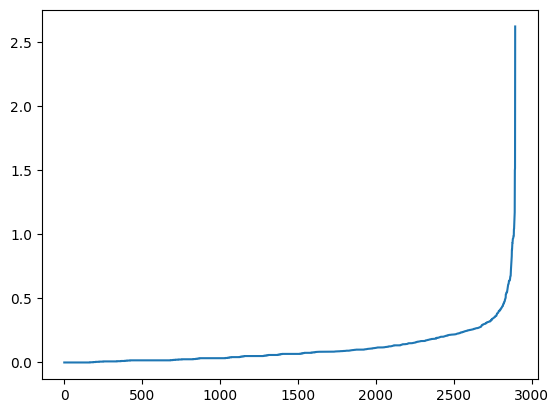

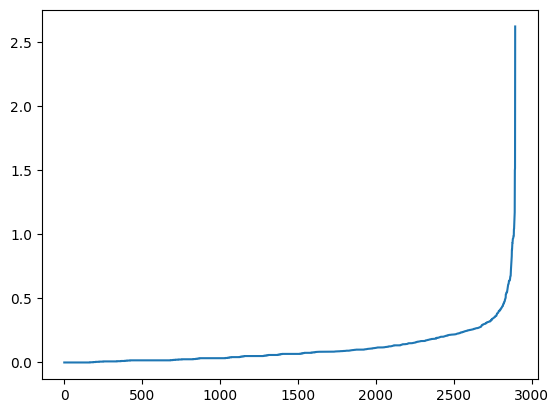

In [56]:
knn_tune(std_stages, 2*std_stages.shape[1])
knn_tune(std_stages, pow(2,std_stages.shape[1]))

Results for different eps values:
     eps  Clusters   Noise
0   0.30      27.0  2055.0
1   0.31      30.0  1977.0
2   0.32      29.0  1974.0
3   0.33      31.0  1943.0
4   0.34      31.0  1906.0
5   0.35      33.0  1955.0
6   0.36      35.0  1892.0
7   0.37      37.0  1853.0
8   0.38      36.0  1839.0
9   0.39      37.0  1825.0
10  0.40      39.0  1779.0
11  0.41      41.0  1734.0
12  0.42      40.0  1793.0
13  0.43      42.0  1755.0
14  0.44      41.0  1741.0
15  0.45      41.0  1737.0
16  0.46      41.0  1744.0
17  0.47      41.0  1743.0
18  0.48      41.0  1740.0
19  0.49      42.0  1724.0
20  0.50      42.0  1723.0
21  0.51      42.0  1722.0
22  0.52      42.0  1717.0
23  0.53      43.0  1699.0
24  0.54      43.0  1699.0
25  0.55      43.0  1696.0
26  0.56      44.0  1674.0
27  0.57      44.0  1668.0
28  0.58      44.0  1666.0
29  0.59      44.0  1663.0
30  0.60      44.0  1663.0
31  0.61      45.0  1647.0
32  0.62      46.0  1631.0
33  0.63      46.0  1631.0
34  0.64      47.0  1

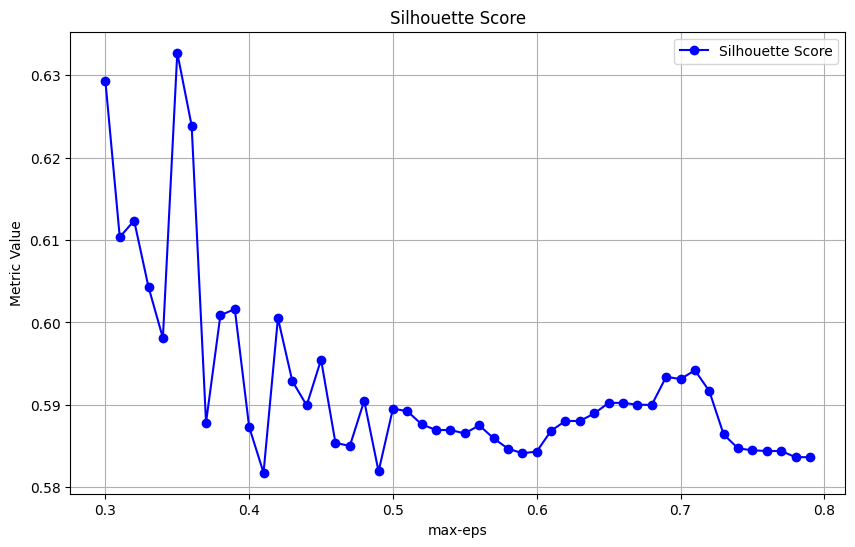

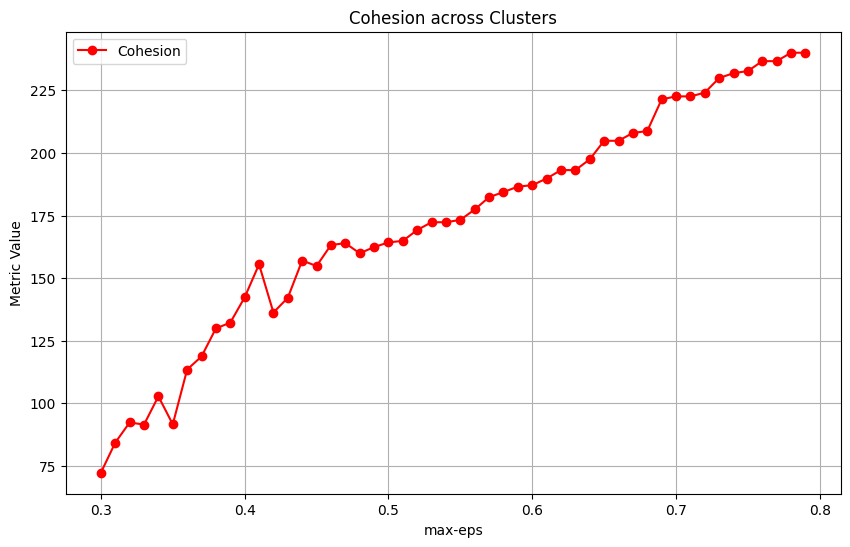

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.

Results for different eps values:
     eps  Clusters   Noise
0   0.30       0.0  2895.0
1   0.31       0.0  2895.0
2   0.32       0.0  2895.0
3   0.33       0.0  2895.0
4   0.34       0.0  2895.0
5   0.35       0.0  2895.0
6   0.36       0.0  2895.0
7   0.37       0.0  2895.0
8   0.38       0.0  2895.0
9   0.39       0.0  2895.0
10  0.40       0.0  2895.0
11  0.41       0.0  2895.0
12  0.42       0.0  2895.0
13  0.43       0.0  2895.0
14  0.44       0.0  2895.0
15  0.45       0.0  2895.0
16  0.46       0.0  2895.0
17  0.47       0.0  2895.0
18  0.48       0.0  2895.0
19  0.49       0.0  2895.0
20  0.50       0.0  2895.0
21  0.51       0.0  2895.0
22  0.52       0.0  2895.0
23  0.53       0.0  2895.0
24  0.54       0.0  2895.0
25  0.55       0.0  2895.0
26  0.56       0.0  2895.0
27  0.57       0.0  2895.0
28  0.58       0.0  2895.0
29  0.59       0.0  2895.0
30  0.60       0.0  2895.0
31  0.61       0.0  2895.0
32  0.62       0.0  2895.0
33  0.63       0.0  2895.0
34  0.64       0.0  2

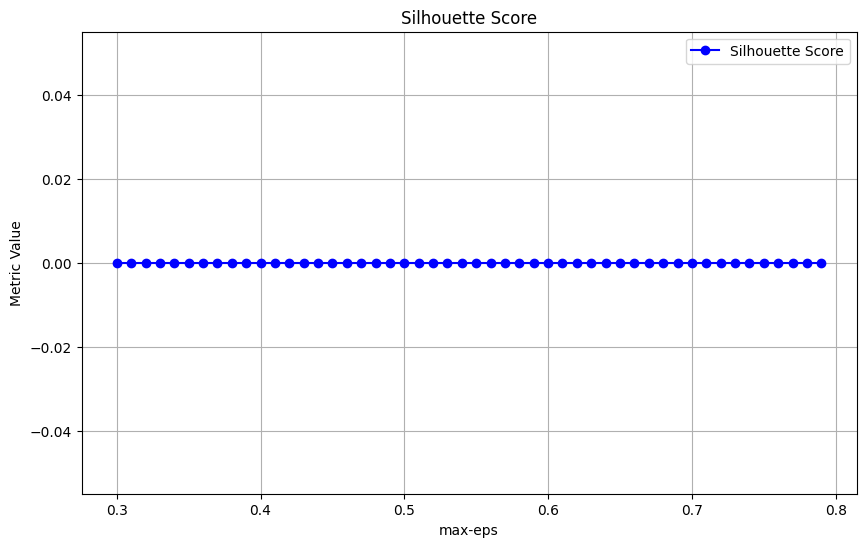

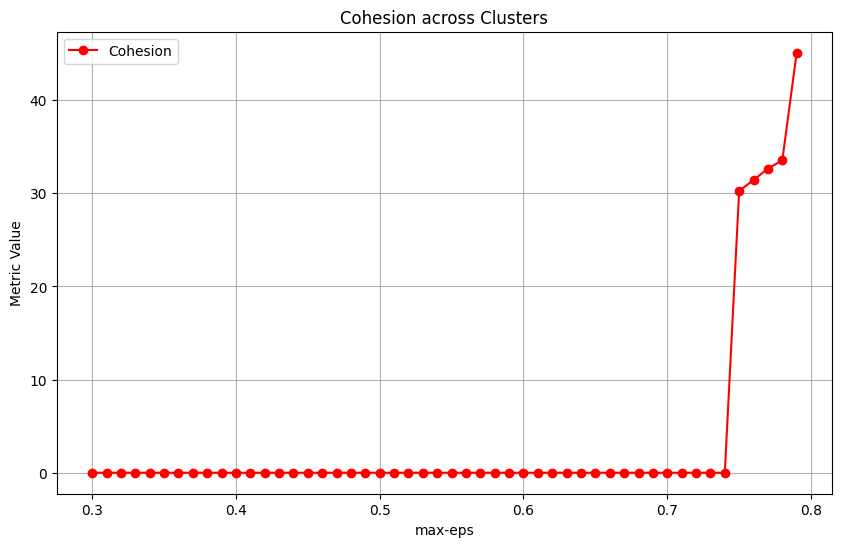

In [57]:
clustering.optics_tune(std_stages, np.arange(0.3, 0.8, 0.01), 2*std_stages.shape[1])
clustering.optics_tune(std_stages, np.arange(0.3, 0.8, 0.01), pow(2,std_stages.shape[1]))

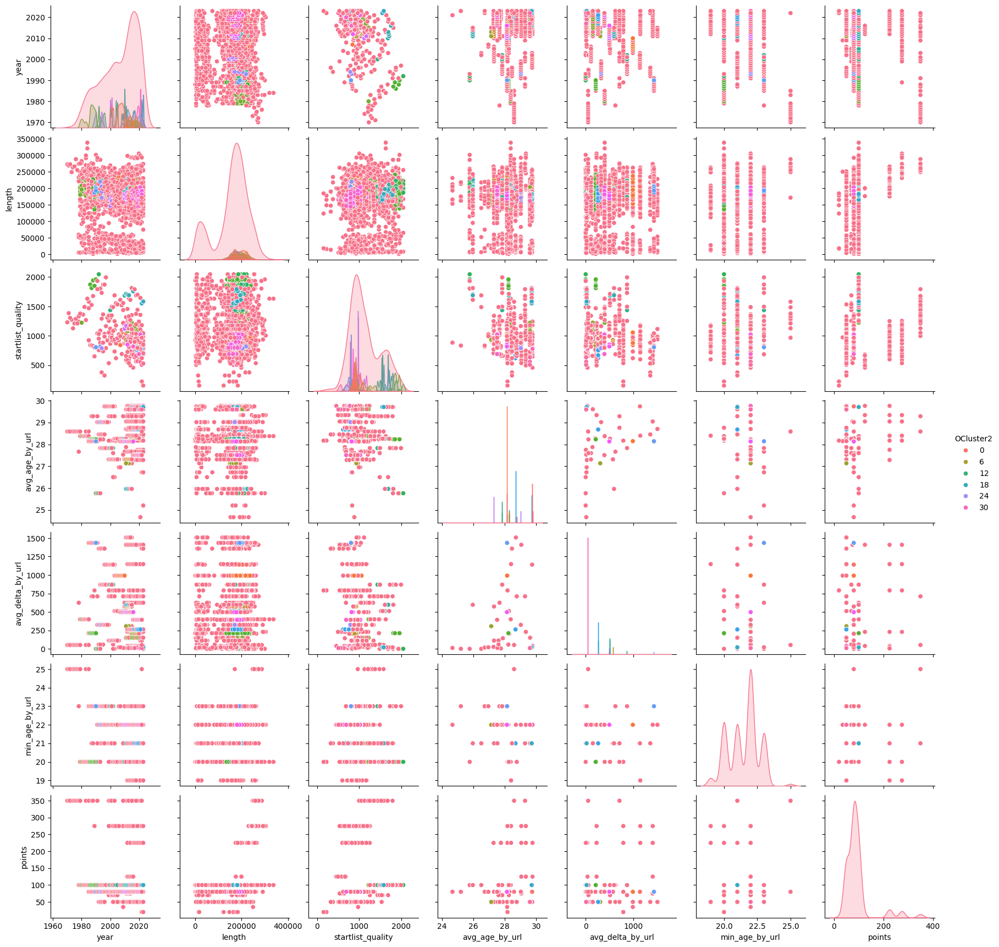

    Cluster  Count
0         0     35
1         1     86
2         2     30
3         3     23
4         4     21
5         5     20
6         6     19
7         7     24
8         8     32
9         9     26
10       10     67
11       11     16
12       12     28
13       13     21
14       14     23
15       15     14
16       16     25
17       17     35
18       18     27
19       19     26
20       20     22
21       21     44
22       22     18
23       23     16
24       24     23
25       25     25
26       26     28
27       27     23
28       28     27
29       29     54
30       30     23
31       31     16
32       32     23
33       -1   1955
           year         length  startlist_quality  avg_age_by_url  \
0   2001.057143  176028.571429         904.571429       29.737805   
1   2007.406977  195848.837209         952.500000       28.146497   
2   2013.166667  172133.333333         893.100000       27.312500   
3   2012.478261  212565.217391         894.391304       27.

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(


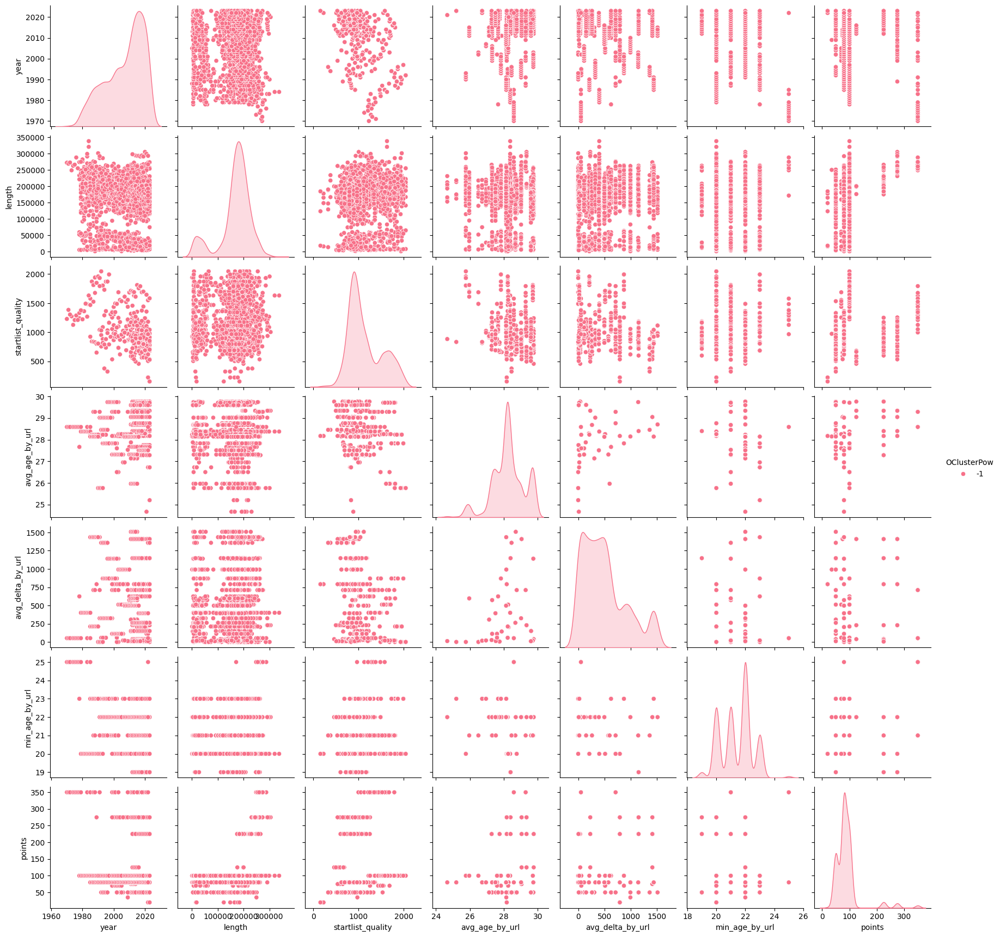

   Cluster  Count
0       -1   2895
Empty DataFrame
Columns: []
Index: []
Series([], dtype: float64)


In [58]:
optics = OPTICS(max_eps=0.35, min_samples=2*std_stages.shape[1], metric='euclidean')
optics.fit(std_stages.values)

labels1 = optics.labels_
clustering.optimal_pair_plot(stages, 'OCluster2', labels1)

optics = OPTICS(max_eps=0.35, min_samples=pow(2,std_stages.shape[1]), metric='euclidean')
optics.fit(std_stages.values)

labels2 = optics.labels_
clustering.optimal_pair_plot(stages, 'OClusterPow', labels2)

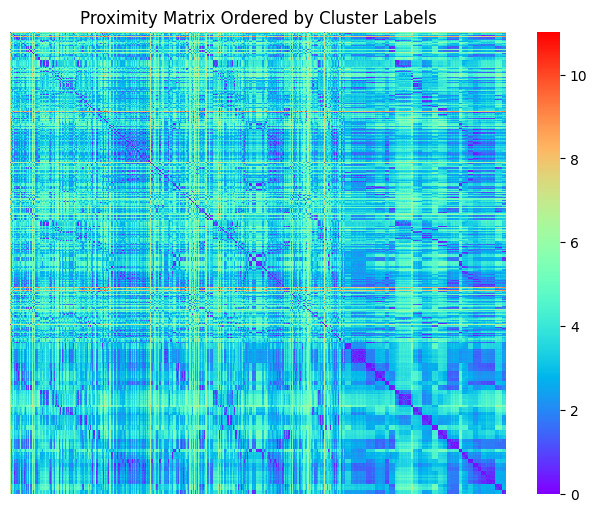

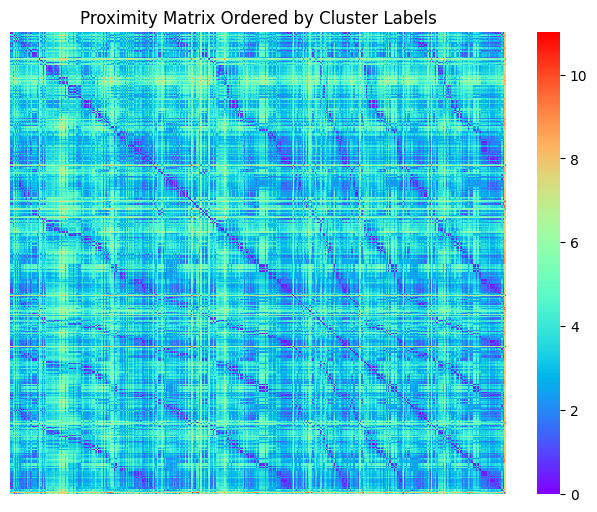

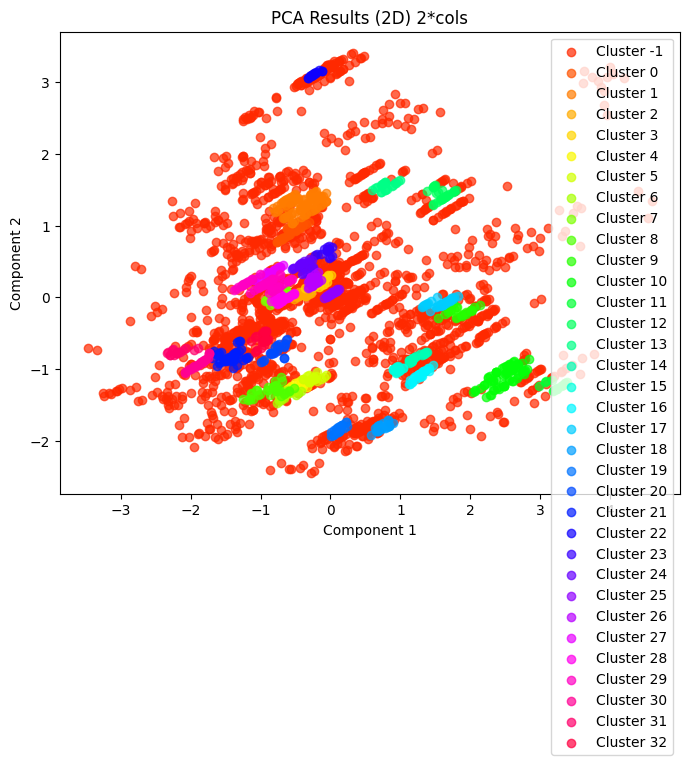

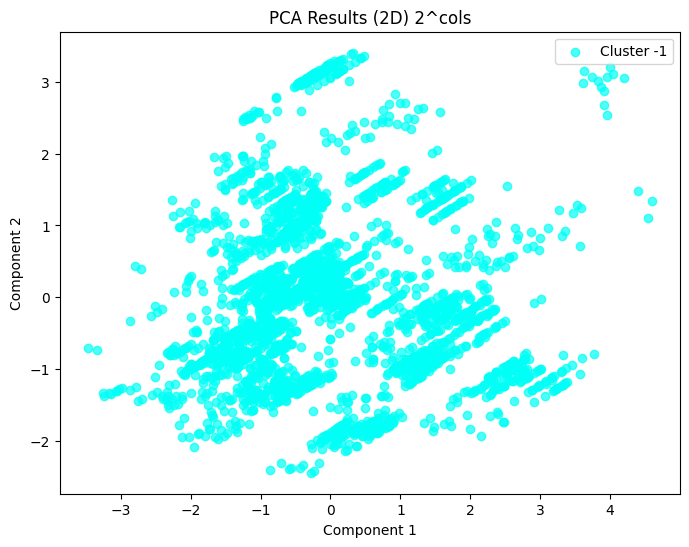

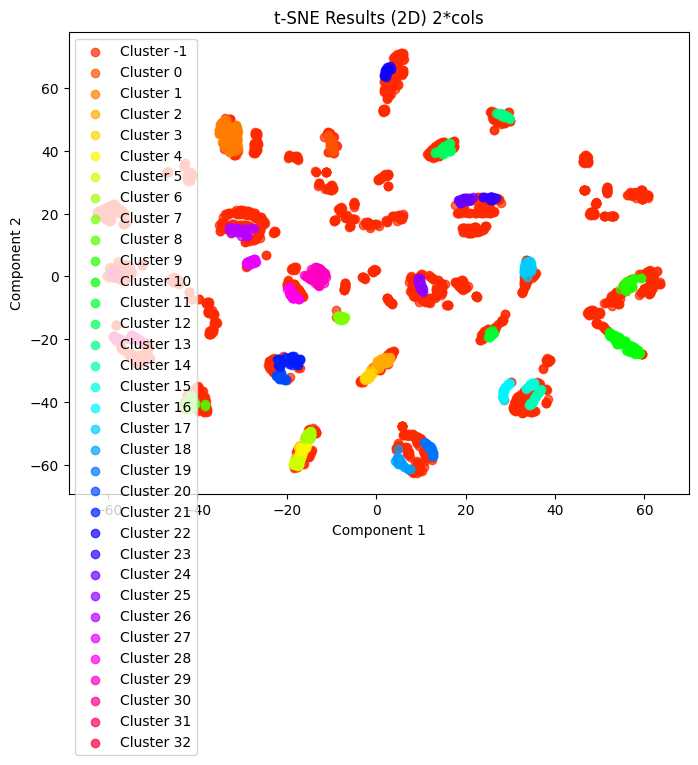

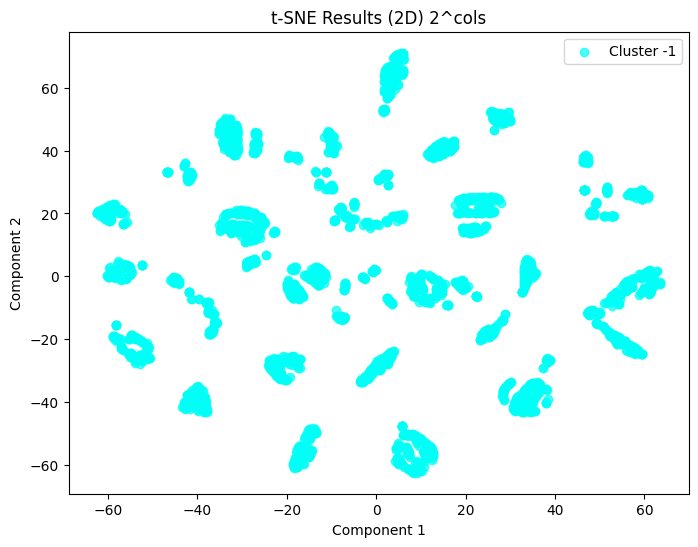

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


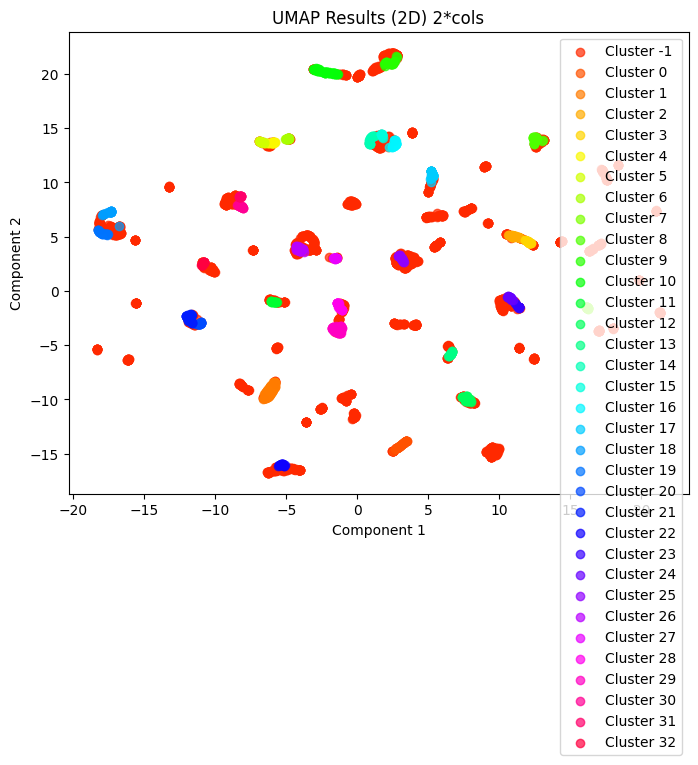

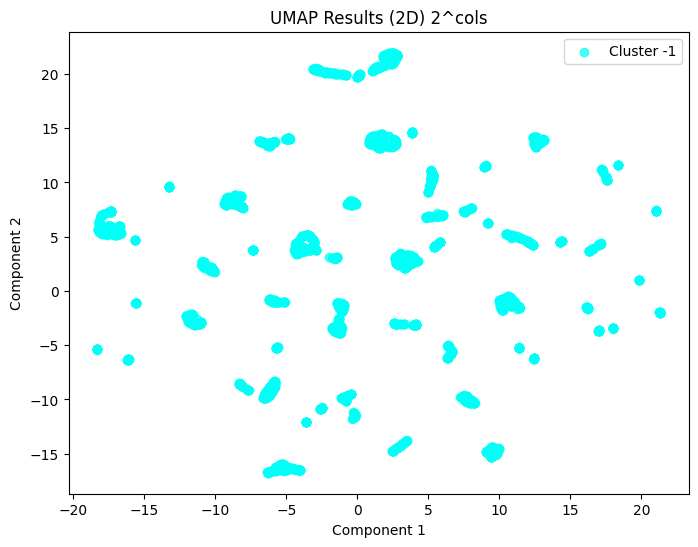

In [59]:
data_scaled = std_stages

clustering.similarity_matrix(std_stages, labels1)
clustering.similarity_matrix(std_stages, labels2)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels1, title="PCA Results (2D) 2*cols", dimensions=2)
plot_results(pca_2d, labels2, title="PCA Results (2D) 2^cols", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels1, title="t-SNE Results (2D) 2*cols", dimensions=2)
plot_results(tsne_2d, labels2, title="t-SNE Results (2D) 2^cols", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels1, title="UMAP Results (2D) 2*cols", dimensions=2)
plot_results(umap_2d, labels2, title="UMAP Results (2D) 2^cols", dimensions=2)